# Afriat

In [1]:
scan=0.20

In [2]:
import warnings
import os
import sys
import gc
import warnings

In [3]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [4]:
torch.cuda.is_available()

True

In [5]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [6]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

tardis.MyModel.setup_wandb(
    wandb_configurations=tardis.config.wandb,
    hyperparams=dict(
        model_params=model_params,
        train_params=train_params,
        dataset_params=dataset_params,
    )
)

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_scan_{scan}"
)

vae.save(
    dir_path,
    overwrite=True,
)

CUDA backend failed to initialize: Found cuDNN version 8700, but JAX was built against version 8907, which is newer. The copy of cuDNN that is installed must be at least as new as the version against which JAX was built. (Set TF_CPP_MIN_LOG_LEVEL=0 and rerun for more info.)


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


W&B logger initialized with the following parameters: 
Entity: inecik-academic
Project: tardis_figures
ID: lrsctacj
Name: sandy-yogurt-114
Tags: tardis, conference, figures, final
Notes: Final runs for Tardis before conference.
URL: https://wandb.ai/inecik-academic/tardis_figures/runs/lrsctacj
Directory: /lustre/groups/ml01/workspace/kemal.inecik/wandb/run-20240503_102816-lrsctacj/files



GPU available: True (cuda), used: True


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "
SLURM auto-requeueing enabled. Setting signal handlers.


Training:   0%|                                                                                                                                                                                                                                | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|                                                                                                                                                                                                                             | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2539,3308,9396
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2539,2570,1692,3389,1644,3409
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4465,10778
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 666,801,2343
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 666,632,416,901,405,790
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1119,2691
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|▎                                                                                                                                                                                                                  | 1/600 [00:12<2:00:06, 12.03s/it]

Epoch 1/600:   0%|▎                                                                                                                                                       | 1/600 [00:12<2:00:06, 12.03s/it, v_num=cj_1, total_loss_train=3.69e+3, kl_local_train=42.5]

Epoch 2/600:   0%|▎                                                                                                                                                       | 1/600 [00:12<2:00:06, 12.03s/it, v_num=cj_1, total_loss_train=3.69e+3, kl_local_train=42.5]

Epoch 2/600:   0%|▌                                                                                                                                                       | 2/600 [00:19<1:34:43,  9.50s/it, v_num=cj_1, total_loss_train=3.69e+3, kl_local_train=42.5]

Epoch 2/600:   0%|▌                                                                                                                                                       | 2/600 [00:19<1:34:43,  9.50s/it, v_num=cj_1, total_loss_train=3.23e+3, kl_local_train=57.2]

Epoch 3/600:   0%|▌                                                                                                                                                       | 2/600 [00:19<1:34:43,  9.50s/it, v_num=cj_1, total_loss_train=3.23e+3, kl_local_train=57.2]

Epoch 3/600:   0%|▊                                                                                                                                                       | 3/600 [00:27<1:26:16,  8.67s/it, v_num=cj_1, total_loss_train=3.23e+3, kl_local_train=57.2]

Epoch 3/600:   0%|▊                                                                                                                                                       | 3/600 [00:27<1:26:16,  8.67s/it, v_num=cj_1, total_loss_train=3.22e+3, kl_local_train=55.7]

Epoch 4/600:   0%|▊                                                                                                                                                       | 3/600 [00:27<1:26:16,  8.67s/it, v_num=cj_1, total_loss_train=3.22e+3, kl_local_train=55.7]

Epoch 4/600:   1%|█                                                                                                                                                       | 4/600 [00:35<1:22:22,  8.29s/it, v_num=cj_1, total_loss_train=3.22e+3, kl_local_train=55.7]

Epoch 4/600:   1%|█                                                                                                                                                       | 4/600 [00:35<1:22:22,  8.29s/it, v_num=cj_1, total_loss_train=3.21e+3, kl_local_train=50.6]

Epoch 5/600:   1%|█                                                                                                                                                       | 4/600 [00:35<1:22:22,  8.29s/it, v_num=cj_1, total_loss_train=3.21e+3, kl_local_train=50.6]

Epoch 5/600:   1%|█▎                                                                                                                                                      | 5/600 [00:42<1:20:00,  8.07s/it, v_num=cj_1, total_loss_train=3.21e+3, kl_local_train=50.6]

Epoch 5/600:   1%|█▎                                                                                                                                                      | 5/600 [00:42<1:20:00,  8.07s/it, v_num=cj_1, total_loss_train=3.21e+3, kl_local_train=39.6]

Epoch 6/600:   1%|█▎                                                                                                                                                      | 5/600 [00:44<1:20:00,  8.07s/it, v_num=cj_1, total_loss_train=3.21e+3, kl_local_train=39.6]

Epoch 6/600:   1%|█▌                                                                                                                                                      | 6/600 [00:52<1:23:50,  8.47s/it, v_num=cj_1, total_loss_train=3.21e+3, kl_local_train=39.6]

Epoch 6/600:   1%|▏                      | 6/600 [00:52<1:23:50,  8.47s/it, v_num=cj_1, total_loss_train=3.2e+3, kl_local_train=33.9, metric_mi|status_control_train=0.0194, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0133, metric_mi|mouse_train=0.036]

Epoch 7/600:   1%|▏                      | 6/600 [00:52<1:23:50,  8.47s/it, v_num=cj_1, total_loss_train=3.2e+3, kl_local_train=33.9, metric_mi|status_control_train=0.0194, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0133, metric_mi|mouse_train=0.036]

Epoch 7/600:   1%|▎                      | 7/600 [00:59<1:21:32,  8.25s/it, v_num=cj_1, total_loss_train=3.2e+3, kl_local_train=33.9, metric_mi|status_control_train=0.0194, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0133, metric_mi|mouse_train=0.036]

Epoch 7/600:   1%|▎                     | 7/600 [00:59<1:21:32,  8.25s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=34.2, metric_mi|status_control_train=0.0194, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0133, metric_mi|mouse_train=0.036]

Epoch 8/600:   1%|▎                     | 7/600 [00:59<1:21:32,  8.25s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=34.2, metric_mi|status_control_train=0.0194, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0133, metric_mi|mouse_train=0.036]

Epoch 8/600:   1%|▎                     | 8/600 [01:07<1:19:52,  8.10s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=34.2, metric_mi|status_control_train=0.0194, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0133, metric_mi|mouse_train=0.036]

Epoch 8/600:   1%|▎                       | 8/600 [01:07<1:19:52,  8.10s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=31, metric_mi|status_control_train=0.0194, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0133, metric_mi|mouse_train=0.036]

Epoch 9/600:   1%|▎                       | 8/600 [01:07<1:19:52,  8.10s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=31, metric_mi|status_control_train=0.0194, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0133, metric_mi|mouse_train=0.036]

Epoch 9/600:   2%|▎                       | 9/600 [01:15<1:18:42,  7.99s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=31, metric_mi|status_control_train=0.0194, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0133, metric_mi|mouse_train=0.036]

Epoch 9/600:   2%|▎                     | 9/600 [01:15<1:18:42,  7.99s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=31.2, metric_mi|status_control_train=0.0194, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0133, metric_mi|mouse_train=0.036]

Epoch 10/600:   2%|▎                    | 9/600 [01:15<1:18:42,  7.99s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=31.2, metric_mi|status_control_train=0.0194, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0133, metric_mi|mouse_train=0.036]

Epoch 10/600:   2%|▎                   | 10/600 [01:23<1:17:43,  7.90s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=31.2, metric_mi|status_control_train=0.0194, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0133, metric_mi|mouse_train=0.036]

Epoch 10/600:   2%|▎                   | 10/600 [01:23<1:17:43,  7.90s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=31.9, metric_mi|status_control_train=0.0194, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0133, metric_mi|mouse_train=0.036]

Epoch 11/600:   2%|▎                   | 10/600 [01:24<1:17:43,  7.90s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=31.9, metric_mi|status_control_train=0.0194, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0133, metric_mi|mouse_train=0.036]

Epoch 11/600:   2%|▎                   | 11/600 [01:32<1:21:17,  8.28s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=31.9, metric_mi|status_control_train=0.0194, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0133, metric_mi|mouse_train=0.036]

Epoch 11/600:   2%|▎                  | 11/600 [01:32<1:21:17,  8.28s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0497]

Epoch 12/600:   2%|▎                  | 11/600 [01:32<1:21:17,  8.28s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0497]

Epoch 12/600:   2%|▍                  | 12/600 [01:39<1:19:21,  8.10s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0497]

Epoch 12/600:   2%|▍                  | 12/600 [01:39<1:19:21,  8.10s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0497]

Epoch 13/600:   2%|▍                  | 12/600 [01:39<1:19:21,  8.10s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0497]

Epoch 13/600:   2%|▍                  | 13/600 [01:47<1:18:08,  7.99s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0497]

Epoch 13/600:   2%|▍                  | 13/600 [01:47<1:18:08,  7.99s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=56.9, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0497]

Epoch 14/600:   2%|▍                  | 13/600 [01:47<1:18:08,  7.99s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=56.9, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0497]

Epoch 14/600:   2%|▍                  | 14/600 [01:55<1:17:08,  7.90s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=56.9, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0497]

Epoch 14/600:   2%|▍                  | 14/600 [01:55<1:17:08,  7.90s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=65.7, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0497]

Epoch 15/600:   2%|▍                  | 14/600 [01:55<1:17:08,  7.90s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=65.7, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0497]

Epoch 15/600:   2%|▍                  | 15/600 [02:03<1:16:38,  7.86s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=65.7, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0497]

Epoch 15/600:   2%|▍                  | 15/600 [02:03<1:16:38,  7.86s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=75.6, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0497]

Epoch 16/600:   2%|▍                  | 15/600 [02:04<1:16:38,  7.86s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=75.6, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0497]

Epoch 16/600:   3%|▌                  | 16/600 [02:12<1:20:17,  8.25s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=75.6, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0497]

Epoch 16/600:   3%|▌                   | 16/600 [02:12<1:20:17,  8.25s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=83.2, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0807]

Epoch 17/600:   3%|▌                   | 16/600 [02:12<1:20:17,  8.25s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=83.2, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0807]

Epoch 17/600:   3%|▌                   | 17/600 [02:19<1:18:33,  8.09s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=83.2, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0807]

Epoch 17/600:   3%|▌                   | 17/600 [02:19<1:18:33,  8.09s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=92.3, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0807]

Epoch 18/600:   3%|▌                   | 17/600 [02:19<1:18:33,  8.09s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=92.3, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0807]

Epoch 18/600:   3%|▌                   | 18/600 [02:27<1:17:16,  7.97s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=92.3, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0807]

Epoch 18/600:   3%|▋                    | 18/600 [02:27<1:17:16,  7.97s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=103, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0807]

Epoch 19/600:   3%|▋                    | 18/600 [02:27<1:17:16,  7.97s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=103, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0807]

Epoch 19/600:   3%|▋                    | 19/600 [02:35<1:16:20,  7.88s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=103, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0807]

Epoch 19/600:   3%|▋                    | 19/600 [02:35<1:16:20,  7.88s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=114, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0807]

Epoch 20/600:   3%|▋                    | 19/600 [02:35<1:16:20,  7.88s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=114, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0807]

Epoch 20/600:   3%|▋                    | 20/600 [02:43<1:15:39,  7.83s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=114, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0807]

Epoch 20/600:   3%|▋                    | 20/600 [02:43<1:15:39,  7.83s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=122, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0807]

Epoch 21/600:   3%|▋                    | 20/600 [02:44<1:15:39,  7.83s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=122, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0807]

Epoch 21/600:   4%|▋                    | 21/600 [02:52<1:19:23,  8.23s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=122, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0807]

Epoch 21/600:   4%|▊                     | 21/600 [02:52<1:19:23,  8.23s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=128, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.112]

Epoch 22/600:   4%|▊                     | 21/600 [02:52<1:19:23,  8.23s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=128, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.112]

Epoch 22/600:   4%|▊                     | 22/600 [02:59<1:17:50,  8.08s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=128, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.112]

Epoch 22/600:   4%|▊                     | 22/600 [02:59<1:17:50,  8.08s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=129, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.112]

Epoch 23/600:   4%|▊                     | 22/600 [02:59<1:17:50,  8.08s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=129, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.112]

Epoch 23/600:   4%|▊                     | 23/600 [03:07<1:16:43,  7.98s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=129, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.112]

Epoch 23/600:   4%|▊                     | 23/600 [03:07<1:16:43,  7.98s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=127, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.112]

Epoch 24/600:   4%|▊                     | 23/600 [03:07<1:16:43,  7.98s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=127, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.112]

Epoch 24/600:   4%|▉                     | 24/600 [03:15<1:15:53,  7.90s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=127, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.112]

Epoch 24/600:   4%|▉                     | 24/600 [03:15<1:15:53,  7.90s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=130, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.112]

Epoch 25/600:   4%|▉                     | 24/600 [03:15<1:15:53,  7.90s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=130, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.112]

Epoch 25/600:   4%|▉                     | 25/600 [03:23<1:15:07,  7.84s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=130, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.112]

Epoch 25/600:   4%|▉                     | 25/600 [03:23<1:15:07,  7.84s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=128, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.112]

Epoch 26/600:   4%|▉                     | 25/600 [03:24<1:15:07,  7.84s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=128, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.112]

Epoch 26/600:   4%|▉                     | 26/600 [03:32<1:18:42,  8.23s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=128, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.112]

Epoch 26/600:   4%|█                       | 26/600 [03:32<1:18:42,  8.23s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=129, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.125]

Epoch 27/600:   4%|█                       | 26/600 [03:32<1:18:42,  8.23s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=129, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.125]

Epoch 27/600:   4%|█                       | 27/600 [03:39<1:17:05,  8.07s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=129, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.125]

Epoch 27/600:   4%|█                       | 27/600 [03:39<1:17:05,  8.07s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=127, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.125]

Epoch 28/600:   4%|█                       | 27/600 [03:39<1:17:05,  8.07s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=127, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.125]

Epoch 28/600:   5%|█                       | 28/600 [03:47<1:16:03,  7.98s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=127, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.125]

Epoch 28/600:   5%|█                       | 28/600 [03:47<1:16:03,  7.98s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=126, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.125]

Epoch 29/600:   5%|█                       | 28/600 [03:47<1:16:03,  7.98s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=126, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.125]

Epoch 29/600:   5%|█▏                      | 29/600 [03:55<1:15:11,  7.90s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=126, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.125]

Epoch 29/600:   5%|█▏                      | 29/600 [03:55<1:15:11,  7.90s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=125, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.125]

Epoch 30/600:   5%|█▏                      | 29/600 [03:55<1:15:11,  7.90s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=125, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.125]

Epoch 30/600:   5%|█▏                      | 30/600 [04:03<1:14:40,  7.86s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=125, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.125]

Epoch 30/600:   5%|█▏                      | 30/600 [04:03<1:14:40,  7.86s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=123, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.125]

Epoch 31/600:   5%|█▏                      | 30/600 [04:04<1:14:40,  7.86s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=123, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.125]

Epoch 31/600:   5%|█▏                      | 31/600 [04:12<1:18:32,  8.28s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=123, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.125]

Epoch 31/600:   5%|█▏                      | 31/600 [04:12<1:18:32,  8.28s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=124, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.131]

Epoch 32/600:   5%|█▏                      | 31/600 [04:12<1:18:32,  8.28s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=124, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.131]

Epoch 32/600:   5%|█▎                      | 32/600 [04:20<1:17:02,  8.14s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=124, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.131]

Epoch 32/600:   5%|█▎                      | 32/600 [04:20<1:17:02,  8.14s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=122, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.131]

Epoch 33/600:   5%|█▎                      | 32/600 [04:20<1:17:02,  8.14s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=122, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.131]

Epoch 33/600:   6%|█▎                      | 33/600 [04:28<1:15:50,  8.03s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=122, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.131]

Epoch 33/600:   6%|█▎                      | 33/600 [04:28<1:15:50,  8.03s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=121, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.131]

Epoch 34/600:   6%|█▎                      | 33/600 [04:28<1:15:50,  8.03s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=121, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.131]

Epoch 34/600:   6%|█▎                      | 34/600 [04:35<1:15:04,  7.96s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=121, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.131]

Epoch 34/600:   6%|█▎                      | 34/600 [04:35<1:15:04,  7.96s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=122, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.131]

Epoch 35/600:   6%|█▎                      | 34/600 [04:35<1:15:04,  7.96s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=122, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.131]

Epoch 35/600:   6%|█▍                      | 35/600 [04:43<1:14:37,  7.93s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=122, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.131]

Epoch 35/600:   6%|█▍                      | 35/600 [04:43<1:14:37,  7.93s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=123, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.131]

Epoch 36/600:   6%|█▍                      | 35/600 [04:45<1:14:37,  7.93s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=123, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.131]

Epoch 36/600:   6%|█▍                      | 36/600 [04:52<1:18:06,  8.31s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=123, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.131]

Epoch 36/600:   6%|█▌                       | 36/600 [04:52<1:18:06,  8.31s/it, v_num=cj_1, total_loss_train=3.2e+3, kl_local_train=124, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.138]

Epoch 37/600:   6%|█▌                       | 36/600 [04:52<1:18:06,  8.31s/it, v_num=cj_1, total_loss_train=3.2e+3, kl_local_train=124, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.138]

Epoch 37/600:   6%|█▌                       | 37/600 [05:00<1:16:50,  8.19s/it, v_num=cj_1, total_loss_train=3.2e+3, kl_local_train=124, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.138]

Epoch 37/600:   6%|█▌                       | 37/600 [05:00<1:16:50,  8.19s/it, v_num=cj_1, total_loss_train=3.2e+3, kl_local_train=125, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.138]

Epoch 38/600:   6%|█▌                       | 37/600 [05:00<1:16:50,  8.19s/it, v_num=cj_1, total_loss_train=3.2e+3, kl_local_train=125, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.138]

Epoch 38/600:   6%|█▌                       | 38/600 [05:08<1:16:41,  8.19s/it, v_num=cj_1, total_loss_train=3.2e+3, kl_local_train=125, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.138]

Epoch 38/600:   6%|█▌                       | 38/600 [05:08<1:16:41,  8.19s/it, v_num=cj_1, total_loss_train=3.2e+3, kl_local_train=125, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.138]

Epoch 39/600:   6%|█▌                       | 38/600 [05:08<1:16:41,  8.19s/it, v_num=cj_1, total_loss_train=3.2e+3, kl_local_train=125, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.138]

Epoch 39/600:   6%|█▋                       | 39/600 [05:16<1:15:53,  8.12s/it, v_num=cj_1, total_loss_train=3.2e+3, kl_local_train=125, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.138]

Epoch 39/600:   6%|█▋                       | 39/600 [05:16<1:15:53,  8.12s/it, v_num=cj_1, total_loss_train=3.2e+3, kl_local_train=124, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.138]

Epoch 40/600:   6%|█▋                       | 39/600 [05:16<1:15:53,  8.12s/it, v_num=cj_1, total_loss_train=3.2e+3, kl_local_train=124, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.138]

Epoch 40/600:   7%|█▋                       | 40/600 [05:24<1:14:51,  8.02s/it, v_num=cj_1, total_loss_train=3.2e+3, kl_local_train=124, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.138]

Epoch 40/600:   7%|█▋                       | 40/600 [05:24<1:14:51,  8.02s/it, v_num=cj_1, total_loss_train=3.2e+3, kl_local_train=124, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.138]

Epoch 41/600:   7%|█▋                       | 40/600 [05:26<1:14:51,  8.02s/it, v_num=cj_1, total_loss_train=3.2e+3, kl_local_train=124, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.138]

Epoch 41/600:   7%|█▋                       | 41/600 [05:33<1:18:06,  8.38s/it, v_num=cj_1, total_loss_train=3.2e+3, kl_local_train=124, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.138]

Epoch 41/600:   7%|█▋                       | 41/600 [05:33<1:18:06,  8.38s/it, v_num=cj_1, total_loss_train=3.2e+3, kl_local_train=123, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.141]

Epoch 42/600:   7%|█▋                       | 41/600 [05:33<1:18:06,  8.38s/it, v_num=cj_1, total_loss_train=3.2e+3, kl_local_train=123, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.141]

Epoch 42/600:   7%|█▊                       | 42/600 [05:41<1:16:27,  8.22s/it, v_num=cj_1, total_loss_train=3.2e+3, kl_local_train=123, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.141]

Epoch 42/600:   7%|█▋                      | 42/600 [05:41<1:16:27,  8.22s/it, v_num=cj_1, total_loss_train=3.21e+3, kl_local_train=124, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.141]

Epoch 43/600:   7%|█▋                      | 42/600 [05:41<1:16:27,  8.22s/it, v_num=cj_1, total_loss_train=3.21e+3, kl_local_train=124, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.141]

Epoch 43/600:   7%|█▋                      | 43/600 [05:49<1:15:29,  8.13s/it, v_num=cj_1, total_loss_train=3.21e+3, kl_local_train=124, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.141]

Epoch 43/600:   7%|█▋                      | 43/600 [05:49<1:15:29,  8.13s/it, v_num=cj_1, total_loss_train=3.21e+3, kl_local_train=123, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.141]

Epoch 44/600:   7%|█▋                      | 43/600 [05:49<1:15:29,  8.13s/it, v_num=cj_1, total_loss_train=3.21e+3, kl_local_train=123, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.141]

Epoch 44/600:   7%|█▊                      | 44/600 [05:57<1:14:04,  7.99s/it, v_num=cj_1, total_loss_train=3.21e+3, kl_local_train=123, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.141]

Epoch 44/600:   7%|█▊                      | 44/600 [05:57<1:14:04,  7.99s/it, v_num=cj_1, total_loss_train=3.21e+3, kl_local_train=125, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.141]

Epoch 45/600:   7%|█▊                      | 44/600 [05:57<1:14:04,  7.99s/it, v_num=cj_1, total_loss_train=3.21e+3, kl_local_train=125, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.141]

Epoch 45/600:   8%|█▊                      | 45/600 [06:05<1:13:12,  7.92s/it, v_num=cj_1, total_loss_train=3.21e+3, kl_local_train=125, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.141]

Epoch 45/600:   8%|█▊                      | 45/600 [06:05<1:13:12,  7.92s/it, v_num=cj_1, total_loss_train=3.21e+3, kl_local_train=125, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.141]

Epoch 46/600:   8%|█▊                      | 45/600 [06:06<1:13:12,  7.92s/it, v_num=cj_1, total_loss_train=3.21e+3, kl_local_train=125, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.141]

Epoch 46/600:   8%|█▊                      | 46/600 [06:14<1:16:42,  8.31s/it, v_num=cj_1, total_loss_train=3.21e+3, kl_local_train=125, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.141]

Epoch 46/600:   8%|█▉                       | 46/600 [06:14<1:16:42,  8.31s/it, v_num=cj_1, total_loss_train=3.22e+3, kl_local_train=123, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.14]

Epoch 47/600:   8%|█▉                       | 46/600 [06:14<1:16:42,  8.31s/it, v_num=cj_1, total_loss_train=3.22e+3, kl_local_train=123, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.14]

Epoch 47/600:   8%|█▉                       | 47/600 [06:22<1:14:55,  8.13s/it, v_num=cj_1, total_loss_train=3.22e+3, kl_local_train=123, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.14]

Epoch 47/600:   8%|█▉                       | 47/600 [06:22<1:14:55,  8.13s/it, v_num=cj_1, total_loss_train=3.22e+3, kl_local_train=123, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.14]

Epoch 48/600:   8%|█▉                       | 47/600 [06:22<1:14:55,  8.13s/it, v_num=cj_1, total_loss_train=3.22e+3, kl_local_train=123, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.14]

Epoch 48/600:   8%|██                       | 48/600 [06:29<1:13:49,  8.02s/it, v_num=cj_1, total_loss_train=3.22e+3, kl_local_train=123, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.14]

Epoch 48/600:   8%|██                       | 48/600 [06:29<1:13:49,  8.02s/it, v_num=cj_1, total_loss_train=3.22e+3, kl_local_train=123, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.14]

Epoch 49/600:   8%|██                       | 48/600 [06:29<1:13:49,  8.02s/it, v_num=cj_1, total_loss_train=3.22e+3, kl_local_train=123, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.14]

Epoch 49/600:   8%|██                       | 49/600 [06:37<1:12:56,  7.94s/it, v_num=cj_1, total_loss_train=3.22e+3, kl_local_train=123, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.14]

Epoch 49/600:   8%|██                       | 49/600 [06:37<1:12:56,  7.94s/it, v_num=cj_1, total_loss_train=3.22e+3, kl_local_train=121, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.14]

Epoch 50/600:   8%|██                       | 49/600 [06:37<1:12:56,  7.94s/it, v_num=cj_1, total_loss_train=3.22e+3, kl_local_train=121, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.14]

Epoch 50/600:   8%|██                       | 50/600 [06:45<1:12:16,  7.88s/it, v_num=cj_1, total_loss_train=3.22e+3, kl_local_train=121, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.14]

Epoch 50/600:   8%|██                       | 50/600 [06:45<1:12:16,  7.88s/it, v_num=cj_1, total_loss_train=3.23e+3, kl_local_train=122, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.14]

Epoch 51/600:   8%|██                       | 50/600 [06:46<1:12:16,  7.88s/it, v_num=cj_1, total_loss_train=3.23e+3, kl_local_train=122, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.14]

Epoch 51/600:   8%|██▏                      | 51/600 [06:54<1:15:35,  8.26s/it, v_num=cj_1, total_loss_train=3.23e+3, kl_local_train=122, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.14]

Epoch 51/600:   8%|██                      | 51/600 [06:54<1:15:35,  8.26s/it, v_num=cj_1, total_loss_train=3.22e+3, kl_local_train=123, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.139]

Epoch 52/600:   8%|██                      | 51/600 [06:54<1:15:35,  8.26s/it, v_num=cj_1, total_loss_train=3.22e+3, kl_local_train=123, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.139]

Epoch 52/600:   9%|██                      | 52/600 [07:02<1:13:54,  8.09s/it, v_num=cj_1, total_loss_train=3.22e+3, kl_local_train=123, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.139]

Epoch 52/600:   9%|██                      | 52/600 [07:02<1:13:54,  8.09s/it, v_num=cj_1, total_loss_train=3.22e+3, kl_local_train=122, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.139]

Epoch 53/600:   9%|██                      | 52/600 [07:02<1:13:54,  8.09s/it, v_num=cj_1, total_loss_train=3.22e+3, kl_local_train=122, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.139]

Epoch 53/600:   9%|██                      | 53/600 [07:09<1:12:52,  7.99s/it, v_num=cj_1, total_loss_train=3.22e+3, kl_local_train=122, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.139]

Epoch 53/600:   9%|██                      | 53/600 [07:09<1:12:52,  7.99s/it, v_num=cj_1, total_loss_train=3.22e+3, kl_local_train=119, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.139]

Epoch 54/600:   9%|██                      | 53/600 [07:09<1:12:52,  7.99s/it, v_num=cj_1, total_loss_train=3.22e+3, kl_local_train=119, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.139]

Epoch 54/600:   9%|██▏                     | 54/600 [07:17<1:11:59,  7.91s/it, v_num=cj_1, total_loss_train=3.22e+3, kl_local_train=119, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.139]

Epoch 54/600:   9%|██▏                     | 54/600 [07:17<1:11:59,  7.91s/it, v_num=cj_1, total_loss_train=3.22e+3, kl_local_train=119, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.139]

Epoch 55/600:   9%|██▏                     | 54/600 [07:17<1:11:59,  7.91s/it, v_num=cj_1, total_loss_train=3.22e+3, kl_local_train=119, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.139]

Epoch 55/600:   9%|██▏                     | 55/600 [07:25<1:11:25,  7.86s/it, v_num=cj_1, total_loss_train=3.22e+3, kl_local_train=119, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.139]

Epoch 55/600:   9%|██▏                     | 55/600 [07:25<1:11:25,  7.86s/it, v_num=cj_1, total_loss_train=3.22e+3, kl_local_train=118, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.139]

Epoch 56/600:   9%|██▏                     | 55/600 [07:26<1:11:25,  7.86s/it, v_num=cj_1, total_loss_train=3.22e+3, kl_local_train=118, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.139]

Epoch 56/600:   9%|██▏                     | 56/600 [07:34<1:14:55,  8.26s/it, v_num=cj_1, total_loss_train=3.22e+3, kl_local_train=118, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.139]

Epoch 56/600:   9%|██▏                     | 56/600 [07:34<1:14:55,  8.26s/it, v_num=cj_1, total_loss_train=3.22e+3, kl_local_train=116, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.141]

Epoch 57/600:   9%|██▏                     | 56/600 [07:34<1:14:55,  8.26s/it, v_num=cj_1, total_loss_train=3.22e+3, kl_local_train=116, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.141]

Epoch 57/600:  10%|██▎                     | 57/600 [07:42<1:13:12,  8.09s/it, v_num=cj_1, total_loss_train=3.22e+3, kl_local_train=116, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.141]

Epoch 57/600:  10%|██▎                     | 57/600 [07:42<1:13:12,  8.09s/it, v_num=cj_1, total_loss_train=3.21e+3, kl_local_train=117, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.141]

Epoch 58/600:  10%|██▎                     | 57/600 [07:42<1:13:12,  8.09s/it, v_num=cj_1, total_loss_train=3.21e+3, kl_local_train=117, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.141]

Epoch 58/600:  10%|██▎                     | 58/600 [07:49<1:12:00,  7.97s/it, v_num=cj_1, total_loss_train=3.21e+3, kl_local_train=117, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.141]

Epoch 58/600:  10%|██▎                     | 58/600 [07:49<1:12:00,  7.97s/it, v_num=cj_1, total_loss_train=3.21e+3, kl_local_train=115, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.141]

Epoch 59/600:  10%|██▎                     | 58/600 [07:50<1:12:00,  7.97s/it, v_num=cj_1, total_loss_train=3.21e+3, kl_local_train=115, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.141]

Epoch 59/600:  10%|██▎                     | 59/600 [07:57<1:11:07,  7.89s/it, v_num=cj_1, total_loss_train=3.21e+3, kl_local_train=115, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.141]

Epoch 59/600:  10%|██▎                     | 59/600 [07:57<1:11:07,  7.89s/it, v_num=cj_1, total_loss_train=3.21e+3, kl_local_train=114, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.141]

Epoch 60/600:  10%|██▎                     | 59/600 [07:57<1:11:07,  7.89s/it, v_num=cj_1, total_loss_train=3.21e+3, kl_local_train=114, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.141]

Epoch 60/600:  10%|██▍                     | 60/600 [08:05<1:10:22,  7.82s/it, v_num=cj_1, total_loss_train=3.21e+3, kl_local_train=114, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.141]

Epoch 60/600:  10%|██▍                     | 60/600 [08:05<1:10:22,  7.82s/it, v_num=cj_1, total_loss_train=3.21e+3, kl_local_train=114, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.141]

Epoch 61/600:  10%|██▍                     | 60/600 [08:06<1:10:22,  7.82s/it, v_num=cj_1, total_loss_train=3.21e+3, kl_local_train=114, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.141]

Epoch 61/600:  10%|██▍                     | 61/600 [08:14<1:13:50,  8.22s/it, v_num=cj_1, total_loss_train=3.21e+3, kl_local_train=114, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.141]

Epoch 61/600:  10%|██▍                     | 61/600 [08:14<1:13:50,  8.22s/it, v_num=cj_1, total_loss_train=3.21e+3, kl_local_train=113, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.142]

Epoch 62/600:  10%|██▍                     | 61/600 [08:14<1:13:50,  8.22s/it, v_num=cj_1, total_loss_train=3.21e+3, kl_local_train=113, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.142]

Epoch 62/600:  10%|██▍                     | 62/600 [08:22<1:12:14,  8.06s/it, v_num=cj_1, total_loss_train=3.21e+3, kl_local_train=113, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.142]

Epoch 62/600:  10%|██▍                     | 62/600 [08:22<1:12:14,  8.06s/it, v_num=cj_1, total_loss_train=3206.75, kl_local_train=112, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.142]

Epoch 63/600:  10%|██▍                     | 62/600 [08:22<1:12:14,  8.06s/it, v_num=cj_1, total_loss_train=3206.75, kl_local_train=112, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.142]

Epoch 63/600:  10%|██▌                     | 63/600 [08:29<1:11:04,  7.94s/it, v_num=cj_1, total_loss_train=3206.75, kl_local_train=112, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.142]

Epoch 63/600:  10%|██▌                     | 63/600 [08:29<1:11:04,  7.94s/it, v_num=cj_1, total_loss_train=3.21e+3, kl_local_train=111, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.142]

Epoch 64/600:  10%|██▌                     | 63/600 [08:29<1:11:04,  7.94s/it, v_num=cj_1, total_loss_train=3.21e+3, kl_local_train=111, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.142]

Epoch 64/600:  11%|██▌                     | 64/600 [08:37<1:10:13,  7.86s/it, v_num=cj_1, total_loss_train=3.21e+3, kl_local_train=111, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.142]

Epoch 64/600:  11%|██▋                      | 64/600 [08:37<1:10:13,  7.86s/it, v_num=cj_1, total_loss_train=3.2e+3, kl_local_train=109, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.142]

Epoch 65/600:  11%|██▋                      | 64/600 [08:37<1:10:13,  7.86s/it, v_num=cj_1, total_loss_train=3.2e+3, kl_local_train=109, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.142]

Epoch 65/600:  11%|██▋                      | 65/600 [08:45<1:09:41,  7.82s/it, v_num=cj_1, total_loss_train=3.2e+3, kl_local_train=109, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.142]

Epoch 65/600:  11%|██▋                      | 65/600 [08:45<1:09:41,  7.82s/it, v_num=cj_1, total_loss_train=3.2e+3, kl_local_train=109, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.142]

Epoch 66/600:  11%|██▋                      | 65/600 [08:46<1:09:41,  7.82s/it, v_num=cj_1, total_loss_train=3.2e+3, kl_local_train=109, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.142]

Epoch 66/600:  11%|██▊                      | 66/600 [08:54<1:13:13,  8.23s/it, v_num=cj_1, total_loss_train=3.2e+3, kl_local_train=109, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.142]

Epoch 66/600:  11%|██▊                      | 66/600 [08:54<1:13:13,  8.23s/it, v_num=cj_1, total_loss_train=3.2e+3, kl_local_train=108, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.139]

Epoch 67/600:  11%|██▊                      | 66/600 [08:54<1:13:13,  8.23s/it, v_num=cj_1, total_loss_train=3.2e+3, kl_local_train=108, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.139]

Epoch 67/600:  11%|██▊                      | 67/600 [09:02<1:11:42,  8.07s/it, v_num=cj_1, total_loss_train=3.2e+3, kl_local_train=108, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.139]

Epoch 67/600:  11%|██▊                      | 67/600 [09:02<1:11:42,  8.07s/it, v_num=cj_1, total_loss_train=3.2e+3, kl_local_train=107, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.139]

Epoch 68/600:  11%|██▊                      | 67/600 [09:02<1:11:42,  8.07s/it, v_num=cj_1, total_loss_train=3.2e+3, kl_local_train=107, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.139]

Epoch 68/600:  11%|██▊                      | 68/600 [09:09<1:10:34,  7.96s/it, v_num=cj_1, total_loss_train=3.2e+3, kl_local_train=107, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.139]

Epoch 68/600:  11%|██▊                      | 68/600 [09:09<1:10:34,  7.96s/it, v_num=cj_1, total_loss_train=3.2e+3, kl_local_train=106, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.139]

Epoch 69/600:  11%|██▊                      | 68/600 [09:09<1:10:34,  7.96s/it, v_num=cj_1, total_loss_train=3.2e+3, kl_local_train=106, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.139]

Epoch 69/600:  12%|██▉                      | 69/600 [09:17<1:09:38,  7.87s/it, v_num=cj_1, total_loss_train=3.2e+3, kl_local_train=106, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.139]

Epoch 69/600:  12%|██▉                      | 69/600 [09:17<1:09:38,  7.87s/it, v_num=cj_1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.139]

Epoch 70/600:  12%|██▉                      | 69/600 [09:17<1:09:38,  7.87s/it, v_num=cj_1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.139]

Epoch 70/600:  12%|██▉                      | 70/600 [09:25<1:08:57,  7.81s/it, v_num=cj_1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.139]

Epoch 70/600:  12%|██▉                      | 70/600 [09:25<1:08:57,  7.81s/it, v_num=cj_1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.139]

Epoch 71/600:  12%|██▉                      | 70/600 [09:26<1:08:57,  7.81s/it, v_num=cj_1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.139]

Epoch 71/600:  12%|██▉                      | 71/600 [09:34<1:12:26,  8.22s/it, v_num=cj_1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.139]

Epoch 71/600:  12%|██▉                      | 71/600 [09:34<1:12:26,  8.22s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 72/600:  12%|██▉                      | 71/600 [09:34<1:12:26,  8.22s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 72/600:  12%|███                      | 72/600 [09:42<1:11:11,  8.09s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 72/600:  12%|███                      | 72/600 [09:42<1:11:11,  8.09s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 73/600:  12%|███                      | 72/600 [09:42<1:11:11,  8.09s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 73/600:  12%|███                      | 73/600 [09:49<1:10:14,  8.00s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 73/600:  12%|███                      | 73/600 [09:49<1:10:14,  8.00s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 74/600:  12%|███                      | 73/600 [09:49<1:10:14,  8.00s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 74/600:  12%|███                      | 74/600 [09:57<1:09:25,  7.92s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 74/600:  12%|███                      | 74/600 [09:57<1:09:25,  7.92s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 75/600:  12%|███                      | 74/600 [09:57<1:09:25,  7.92s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 75/600:  12%|███▏                     | 75/600 [10:05<1:08:52,  7.87s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 75/600:  12%|███                     | 75/600 [10:05<1:08:52,  7.87s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=99.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 76/600:  12%|███                     | 75/600 [10:06<1:08:52,  7.87s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=99.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 76/600:  13%|███                     | 76/600 [10:14<1:12:22,  8.29s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=99.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 76/600:  13%|███                     | 76/600 [10:14<1:12:22,  8.29s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=100, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.134]

Epoch 77/600:  13%|███                     | 76/600 [10:14<1:12:22,  8.29s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=100, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.134]

Epoch 77/600:  13%|███                     | 77/600 [10:22<1:11:01,  8.15s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=100, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.134]

Epoch 77/600:  13%|██▉                    | 77/600 [10:22<1:11:01,  8.15s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=99.8, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.134]

Epoch 78/600:  13%|██▉                    | 77/600 [10:22<1:11:01,  8.15s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=99.8, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.134]

Epoch 78/600:  13%|██▉                    | 78/600 [10:30<1:09:56,  8.04s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=99.8, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.134]

Epoch 78/600:  13%|██▉                    | 78/600 [10:30<1:09:56,  8.04s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=98.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.134]

Epoch 79/600:  13%|██▉                    | 78/600 [10:30<1:09:56,  8.04s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=98.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.134]

Epoch 79/600:  13%|███                    | 79/600 [10:38<1:09:06,  7.96s/it, v_num=cj_1, total_loss_train=3.19e+3, kl_local_train=98.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.134]

Epoch 79/600:  13%|███▎                     | 79/600 [10:38<1:09:06,  7.96s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=98, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.134]

Epoch 80/600:  13%|███▎                     | 79/600 [10:38<1:09:06,  7.96s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=98, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.134]

Epoch 80/600:  13%|███▎                     | 80/600 [10:45<1:08:25,  7.90s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=98, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.134]

Epoch 80/600:  13%|███                    | 80/600 [10:45<1:08:25,  7.90s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=97.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.134]

Epoch 81/600:  13%|███                    | 80/600 [10:47<1:08:25,  7.90s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=97.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.134]

Epoch 81/600:  14%|███                    | 81/600 [10:54<1:11:24,  8.26s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=97.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.134]

Epoch 81/600:  14%|███▏                    | 81/600 [10:54<1:11:24,  8.26s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=96.6, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 82/600:  14%|███▏                    | 81/600 [10:54<1:11:24,  8.26s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=96.6, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 82/600:  14%|███▎                    | 82/600 [11:02<1:10:00,  8.11s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=96.6, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 82/600:  14%|███▎                    | 82/600 [11:02<1:10:00,  8.11s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=96.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 83/600:  14%|███▎                    | 82/600 [11:02<1:10:00,  8.11s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=96.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 83/600:  14%|███▎                    | 83/600 [11:10<1:09:07,  8.02s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=96.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 83/600:  14%|███▎                    | 83/600 [11:10<1:09:07,  8.02s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=95.5, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 84/600:  14%|███▎                    | 83/600 [11:10<1:09:07,  8.02s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=95.5, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 84/600:  14%|███▎                    | 84/600 [11:18<1:08:12,  7.93s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=95.5, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 84/600:  14%|███▎                    | 84/600 [11:18<1:08:12,  7.93s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=94.8, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 85/600:  14%|███▎                    | 84/600 [11:18<1:08:12,  7.93s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=94.8, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 85/600:  14%|███▍                    | 85/600 [11:25<1:07:43,  7.89s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=94.8, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 85/600:  14%|███▍                    | 85/600 [11:25<1:07:43,  7.89s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=94.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 86/600:  14%|███▍                    | 85/600 [11:27<1:07:43,  7.89s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=94.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 86/600:  14%|███▍                    | 86/600 [11:35<1:11:04,  8.30s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=94.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 86/600:  14%|███▎                   | 86/600 [11:35<1:11:04,  8.30s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=93.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.136]

Epoch 87/600:  14%|███▎                   | 86/600 [11:35<1:11:04,  8.30s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=93.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.136]

Epoch 87/600:  14%|███▎                   | 87/600 [11:42<1:09:16,  8.10s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=93.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.136]

Epoch 87/600:  14%|███▎                   | 87/600 [11:42<1:09:16,  8.10s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=92.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.136]

Epoch 88/600:  14%|███▎                   | 87/600 [11:42<1:09:16,  8.10s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=92.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.136]

Epoch 88/600:  15%|███▎                   | 88/600 [11:50<1:08:01,  7.97s/it, v_num=cj_1, total_loss_train=3.18e+3, kl_local_train=92.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.136]

Epoch 88/600:  15%|███▎                   | 88/600 [11:50<1:08:01,  7.97s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=92.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.136]

Epoch 89/600:  15%|███▎                   | 88/600 [11:50<1:08:01,  7.97s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=92.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.136]

Epoch 89/600:  15%|███▍                   | 89/600 [11:58<1:07:10,  7.89s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=92.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.136]

Epoch 89/600:  15%|███▍                   | 89/600 [11:58<1:07:10,  7.89s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=91.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.136]

Epoch 90/600:  15%|███▍                   | 89/600 [11:58<1:07:10,  7.89s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=91.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.136]

Epoch 90/600:  15%|███▍                   | 90/600 [12:05<1:06:27,  7.82s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=91.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.136]

Epoch 90/600:  15%|███▍                   | 90/600 [12:05<1:06:27,  7.82s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=91.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.136]

Epoch 91/600:  15%|███▍                   | 90/600 [12:07<1:06:27,  7.82s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=91.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.136]

Epoch 91/600:  15%|███▍                   | 91/600 [12:14<1:09:35,  8.20s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=91.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.136]

Epoch 91/600:  15%|███▉                      | 91/600 [12:14<1:09:35,  8.20s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=90.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.135]

Epoch 92/600:  15%|███▉                      | 91/600 [12:14<1:09:35,  8.20s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=90.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.135]

Epoch 92/600:  15%|███▉                      | 92/600 [12:22<1:08:10,  8.05s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=90.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.135]

Epoch 92/600:  15%|███▉                      | 92/600 [12:22<1:08:10,  8.05s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=90.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.135]

Epoch 93/600:  15%|███▉                      | 92/600 [12:22<1:08:10,  8.05s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=90.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.135]

Epoch 93/600:  16%|████                      | 93/600 [12:30<1:07:02,  7.93s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=90.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.135]

Epoch 93/600:  16%|████▎                       | 93/600 [12:30<1:07:02,  7.93s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=90, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.135]

Epoch 94/600:  16%|████▎                       | 93/600 [12:30<1:07:02,  7.93s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=90, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.135]

Epoch 94/600:  16%|████▍                       | 94/600 [12:37<1:06:10,  7.85s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=90, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.135]

Epoch 94/600:  16%|████                      | 94/600 [12:37<1:06:10,  7.85s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=89.3, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.135]

Epoch 95/600:  16%|████                      | 94/600 [12:37<1:06:10,  7.85s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=89.3, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.135]

Epoch 95/600:  16%|████                      | 95/600 [12:45<1:05:24,  7.77s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=89.3, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.135]

Epoch 95/600:  16%|████                      | 95/600 [12:45<1:05:24,  7.77s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=88.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.135]

Epoch 96/600:  16%|████                      | 95/600 [12:47<1:05:24,  7.77s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=88.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.135]

Epoch 96/600:  16%|████▏                     | 96/600 [12:54<1:08:40,  8.18s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=88.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.135]

Epoch 96/600:  16%|████                     | 96/600 [12:54<1:08:40,  8.18s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=88.2, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 97/600:  16%|████                     | 96/600 [12:54<1:08:40,  8.18s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=88.2, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 97/600:  16%|████                     | 97/600 [13:02<1:07:21,  8.03s/it, v_num=cj_1, total_loss_train=3.17e+3, kl_local_train=88.2, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 97/600:  16%|████                     | 97/600 [13:02<1:07:21,  8.03s/it, v_num=cj_1, total_loss_train=3.16e+3, kl_local_train=87.9, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 98/600:  16%|████                     | 97/600 [13:02<1:07:21,  8.03s/it, v_num=cj_1, total_loss_train=3.16e+3, kl_local_train=87.9, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 98/600:  16%|████                     | 98/600 [13:10<1:06:22,  7.93s/it, v_num=cj_1, total_loss_train=3.16e+3, kl_local_train=87.9, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 98/600:  16%|████                     | 98/600 [13:10<1:06:22,  7.93s/it, v_num=cj_1, total_loss_train=3.16e+3, kl_local_train=87.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 99/600:  16%|████                     | 98/600 [13:10<1:06:22,  7.93s/it, v_num=cj_1, total_loss_train=3.16e+3, kl_local_train=87.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 99/600:  16%|████▏                    | 99/600 [13:17<1:05:36,  7.86s/it, v_num=cj_1, total_loss_train=3.16e+3, kl_local_train=87.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 99/600:  16%|████▏                    | 99/600 [13:17<1:05:36,  7.86s/it, v_num=cj_1, total_loss_train=3.16e+3, kl_local_train=87.2, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 100/600:  16%|███▉                    | 99/600 [13:17<1:05:36,  7.86s/it, v_num=cj_1, total_loss_train=3.16e+3, kl_local_train=87.2, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 100/600:  17%|███▊                   | 100/600 [13:25<1:05:07,  7.81s/it, v_num=cj_1, total_loss_train=3.16e+3, kl_local_train=87.2, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 100/600:  17%|███▊                   | 100/600 [13:25<1:05:07,  7.81s/it, v_num=cj_1, total_loss_train=3.16e+3, kl_local_train=86.4, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 101/600:  17%|███▊                   | 100/600 [13:26<1:05:07,  7.81s/it, v_num=cj_1, total_loss_train=3.16e+3, kl_local_train=86.4, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 101/600:  17%|███▊                   | 101/600 [13:34<1:08:15,  8.21s/it, v_num=cj_1, total_loss_train=3.16e+3, kl_local_train=86.4, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 101/600:  17%|███▌                 | 101/600 [13:34<1:08:15,  8.21s/it, v_num=cj_1, total_loss_train=3.16e+3, kl_local_train=86.2, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 102/600:  17%|███▌                 | 101/600 [13:34<1:08:15,  8.21s/it, v_num=cj_1, total_loss_train=3.16e+3, kl_local_train=86.2, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 102/600:  17%|███▌                 | 102/600 [13:42<1:06:50,  8.05s/it, v_num=cj_1, total_loss_train=3.16e+3, kl_local_train=86.2, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 102/600:  17%|███▌                 | 102/600 [13:42<1:06:50,  8.05s/it, v_num=cj_1, total_loss_train=3.16e+3, kl_local_train=85.6, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 103/600:  17%|███▌                 | 102/600 [13:42<1:06:50,  8.05s/it, v_num=cj_1, total_loss_train=3.16e+3, kl_local_train=85.6, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 103/600:  17%|███▌                 | 103/600 [13:49<1:05:46,  7.94s/it, v_num=cj_1, total_loss_train=3.16e+3, kl_local_train=85.6, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 103/600:  17%|███▌                 | 103/600 [13:49<1:05:46,  7.94s/it, v_num=cj_1, total_loss_train=3.16e+3, kl_local_train=85.4, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 104/600:  17%|███▌                 | 103/600 [13:50<1:05:46,  7.94s/it, v_num=cj_1, total_loss_train=3.16e+3, kl_local_train=85.4, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 104/600:  17%|███▋                 | 104/600 [13:57<1:05:12,  7.89s/it, v_num=cj_1, total_loss_train=3.16e+3, kl_local_train=85.4, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 104/600:  17%|███▋                 | 104/600 [13:57<1:05:12,  7.89s/it, v_num=cj_1, total_loss_train=3.16e+3, kl_local_train=84.5, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 105/600:  17%|███▋                 | 104/600 [13:57<1:05:12,  7.89s/it, v_num=cj_1, total_loss_train=3.16e+3, kl_local_train=84.5, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 105/600:  18%|███▋                 | 105/600 [14:05<1:04:33,  7.82s/it, v_num=cj_1, total_loss_train=3.16e+3, kl_local_train=84.5, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 105/600:  18%|███▋                 | 105/600 [14:05<1:04:33,  7.82s/it, v_num=cj_1, total_loss_train=3.16e+3, kl_local_train=84.3, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 106/600:  18%|███▋                 | 105/600 [14:06<1:04:33,  7.82s/it, v_num=cj_1, total_loss_train=3.16e+3, kl_local_train=84.3, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 106/600:  18%|███▋                 | 106/600 [14:14<1:07:35,  8.21s/it, v_num=cj_1, total_loss_train=3.16e+3, kl_local_train=84.3, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 106/600:  18%|███▋                 | 106/600 [14:14<1:07:35,  8.21s/it, v_num=cj_1, total_loss_train=3.16e+3, kl_local_train=84.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 107/600:  18%|███▋                 | 106/600 [14:14<1:07:35,  8.21s/it, v_num=cj_1, total_loss_train=3.16e+3, kl_local_train=84.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 107/600:  18%|███▋                 | 107/600 [14:22<1:06:15,  8.06s/it, v_num=cj_1, total_loss_train=3.16e+3, kl_local_train=84.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 107/600:  18%|███▋                 | 107/600 [14:22<1:06:15,  8.06s/it, v_num=cj_1, total_loss_train=3.15e+3, kl_local_train=83.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 108/600:  18%|███▋                 | 107/600 [14:22<1:06:15,  8.06s/it, v_num=cj_1, total_loss_train=3.15e+3, kl_local_train=83.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 108/600:  18%|███▊                 | 108/600 [14:29<1:05:14,  7.96s/it, v_num=cj_1, total_loss_train=3.15e+3, kl_local_train=83.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 108/600:  18%|███▊                 | 108/600 [14:29<1:05:14,  7.96s/it, v_num=cj_1, total_loss_train=3.15e+3, kl_local_train=83.4, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 109/600:  18%|███▊                 | 108/600 [14:29<1:05:14,  7.96s/it, v_num=cj_1, total_loss_train=3.15e+3, kl_local_train=83.4, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 109/600:  18%|███▊                 | 109/600 [14:37<1:04:27,  7.88s/it, v_num=cj_1, total_loss_train=3.15e+3, kl_local_train=83.4, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 109/600:  18%|███▊                 | 109/600 [14:37<1:04:27,  7.88s/it, v_num=cj_1, total_loss_train=3.15e+3, kl_local_train=83.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 110/600:  18%|███▊                 | 109/600 [14:37<1:04:27,  7.88s/it, v_num=cj_1, total_loss_train=3.15e+3, kl_local_train=83.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 110/600:  18%|███▊                 | 110/600 [14:45<1:03:50,  7.82s/it, v_num=cj_1, total_loss_train=3.15e+3, kl_local_train=83.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 110/600:  18%|███▊                 | 110/600 [14:45<1:03:50,  7.82s/it, v_num=cj_1, total_loss_train=3.15e+3, kl_local_train=82.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 111/600:  18%|███▊                 | 110/600 [14:46<1:03:50,  7.82s/it, v_num=cj_1, total_loss_train=3.15e+3, kl_local_train=82.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 111/600:  18%|███▉                 | 111/600 [14:54<1:07:05,  8.23s/it, v_num=cj_1, total_loss_train=3.15e+3, kl_local_train=82.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 111/600:  18%|████▎                  | 111/600 [14:54<1:07:05,  8.23s/it, v_num=cj_1, total_loss_train=3.15e+3, kl_local_train=82, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 112/600:  18%|████▎                  | 111/600 [14:54<1:07:05,  8.23s/it, v_num=cj_1, total_loss_train=3.15e+3, kl_local_train=82, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 112/600:  19%|████▎                  | 112/600 [15:02<1:05:48,  8.09s/it, v_num=cj_1, total_loss_train=3.15e+3, kl_local_train=82, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 112/600:  19%|███▉                 | 112/600 [15:02<1:05:48,  8.09s/it, v_num=cj_1, total_loss_train=3.15e+3, kl_local_train=81.6, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 113/600:  19%|███▉                 | 112/600 [15:02<1:05:48,  8.09s/it, v_num=cj_1, total_loss_train=3.15e+3, kl_local_train=81.6, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 113/600:  19%|███▉                 | 113/600 [15:10<1:04:54,  8.00s/it, v_num=cj_1, total_loss_train=3.15e+3, kl_local_train=81.6, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 113/600:  19%|███▉                 | 113/600 [15:10<1:04:54,  8.00s/it, v_num=cj_1, total_loss_train=3.15e+3, kl_local_train=81.6, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 114/600:  19%|███▉                 | 113/600 [15:10<1:04:54,  8.00s/it, v_num=cj_1, total_loss_train=3.15e+3, kl_local_train=81.6, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 114/600:  19%|███▉                 | 114/600 [15:17<1:04:04,  7.91s/it, v_num=cj_1, total_loss_train=3.15e+3, kl_local_train=81.6, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 114/600:  19%|███▉                 | 114/600 [15:17<1:04:04,  7.91s/it, v_num=cj_1, total_loss_train=3.15e+3, kl_local_train=81.5, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 115/600:  19%|███▉                 | 114/600 [15:17<1:04:04,  7.91s/it, v_num=cj_1, total_loss_train=3.15e+3, kl_local_train=81.5, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 115/600:  19%|████                 | 115/600 [15:25<1:03:26,  7.85s/it, v_num=cj_1, total_loss_train=3.15e+3, kl_local_train=81.5, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 115/600:  19%|████                 | 115/600 [15:25<1:03:26,  7.85s/it, v_num=cj_1, total_loss_train=3.15e+3, kl_local_train=81.2, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 116/600:  19%|████                 | 115/600 [15:26<1:03:26,  7.85s/it, v_num=cj_1, total_loss_train=3.15e+3, kl_local_train=81.2, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 116/600:  19%|████                 | 116/600 [15:34<1:06:21,  8.23s/it, v_num=cj_1, total_loss_train=3.15e+3, kl_local_train=81.2, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 116/600:  19%|████                 | 116/600 [15:34<1:06:21,  8.23s/it, v_num=cj_1, total_loss_train=3.15e+3, kl_local_train=80.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 117/600:  19%|████                 | 116/600 [15:34<1:06:21,  8.23s/it, v_num=cj_1, total_loss_train=3.15e+3, kl_local_train=80.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 117/600:  20%|████                 | 117/600 [15:42<1:05:08,  8.09s/it, v_num=cj_1, total_loss_train=3.15e+3, kl_local_train=80.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 117/600:  20%|████▍                  | 117/600 [15:42<1:05:08,  8.09s/it, v_num=cj_1, total_loss_train=3.15e+3, kl_local_train=80, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 118/600:  20%|████▍                  | 117/600 [15:42<1:05:08,  8.09s/it, v_num=cj_1, total_loss_train=3.15e+3, kl_local_train=80, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 118/600:  20%|████▌                  | 118/600 [15:50<1:04:04,  7.98s/it, v_num=cj_1, total_loss_train=3.15e+3, kl_local_train=80, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 118/600:  20%|████▏                | 118/600 [15:50<1:04:04,  7.98s/it, v_num=cj_1, total_loss_train=3.14e+3, kl_local_train=79.8, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 119/600:  20%|████▏                | 118/600 [15:50<1:04:04,  7.98s/it, v_num=cj_1, total_loss_train=3.14e+3, kl_local_train=79.8, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 119/600:  20%|████▏                | 119/600 [15:57<1:03:15,  7.89s/it, v_num=cj_1, total_loss_train=3.14e+3, kl_local_train=79.8, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 119/600:  20%|████▏                | 119/600 [15:57<1:03:15,  7.89s/it, v_num=cj_1, total_loss_train=3.14e+3, kl_local_train=79.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 120/600:  20%|████▏                | 119/600 [15:57<1:03:15,  7.89s/it, v_num=cj_1, total_loss_train=3.14e+3, kl_local_train=79.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 120/600:  20%|████▏                | 120/600 [16:05<1:02:36,  7.83s/it, v_num=cj_1, total_loss_train=3.14e+3, kl_local_train=79.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 120/600:  20%|████▏                | 120/600 [16:05<1:02:36,  7.83s/it, v_num=cj_1, total_loss_train=3.14e+3, kl_local_train=79.7, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 121/600:  20%|████▏                | 120/600 [16:06<1:02:36,  7.83s/it, v_num=cj_1, total_loss_train=3.14e+3, kl_local_train=79.7, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 121/600:  20%|████▏                | 121/600 [16:14<1:05:44,  8.24s/it, v_num=cj_1, total_loss_train=3.14e+3, kl_local_train=79.7, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 121/600:  20%|████▏                | 121/600 [16:14<1:05:44,  8.24s/it, v_num=cj_1, total_loss_train=3.14e+3, kl_local_train=78.7, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 122/600:  20%|████▏                | 121/600 [16:14<1:05:44,  8.24s/it, v_num=cj_1, total_loss_train=3.14e+3, kl_local_train=78.7, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 122/600:  20%|████▎                | 122/600 [16:22<1:04:25,  8.09s/it, v_num=cj_1, total_loss_train=3.14e+3, kl_local_train=78.7, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 122/600:  20%|████▎                | 122/600 [16:22<1:04:25,  8.09s/it, v_num=cj_1, total_loss_train=3.14e+3, kl_local_train=78.6, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 123/600:  20%|████▎                | 122/600 [16:22<1:04:25,  8.09s/it, v_num=cj_1, total_loss_train=3.14e+3, kl_local_train=78.6, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 123/600:  20%|████▎                | 123/600 [16:30<1:03:20,  7.97s/it, v_num=cj_1, total_loss_train=3.14e+3, kl_local_train=78.6, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 123/600:  20%|████▎                | 123/600 [16:30<1:03:20,  7.97s/it, v_num=cj_1, total_loss_train=3.14e+3, kl_local_train=78.3, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 124/600:  20%|████▎                | 123/600 [16:30<1:03:20,  7.97s/it, v_num=cj_1, total_loss_train=3.14e+3, kl_local_train=78.3, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 124/600:  21%|████▎                | 124/600 [16:37<1:02:32,  7.88s/it, v_num=cj_1, total_loss_train=3.14e+3, kl_local_train=78.3, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 124/600:  21%|████▊                  | 124/600 [16:37<1:02:32,  7.88s/it, v_num=cj_1, total_loss_train=3.14e+3, kl_local_train=78, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 125/600:  21%|████▊                  | 124/600 [16:37<1:02:32,  7.88s/it, v_num=cj_1, total_loss_train=3.14e+3, kl_local_train=78, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 125/600:  21%|████▊                  | 125/600 [16:45<1:02:02,  7.84s/it, v_num=cj_1, total_loss_train=3.14e+3, kl_local_train=78, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 125/600:  21%|████▍                | 125/600 [16:45<1:02:02,  7.84s/it, v_num=cj_1, total_loss_train=3.14e+3, kl_local_train=77.6, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 126/600:  21%|████▍                | 125/600 [16:46<1:02:02,  7.84s/it, v_num=cj_1, total_loss_train=3.14e+3, kl_local_train=77.6, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 126/600:  21%|████▍                | 126/600 [16:54<1:05:13,  8.26s/it, v_num=cj_1, total_loss_train=3.14e+3, kl_local_train=77.6, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.125]

Epoch 126/600:  21%|████▍                | 126/600 [16:54<1:05:13,  8.26s/it, v_num=cj_1, total_loss_train=3.14e+3, kl_local_train=77.5, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 127/600:  21%|████▍                | 126/600 [16:54<1:05:13,  8.26s/it, v_num=cj_1, total_loss_train=3.14e+3, kl_local_train=77.5, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 127/600:  21%|████▍                | 127/600 [17:02<1:03:51,  8.10s/it, v_num=cj_1, total_loss_train=3.14e+3, kl_local_train=77.5, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 127/600:  21%|████▍                | 127/600 [17:02<1:03:51,  8.10s/it, v_num=cj_1, total_loss_train=3.14e+3, kl_local_train=77.3, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 128/600:  21%|████▍                | 127/600 [17:02<1:03:51,  8.10s/it, v_num=cj_1, total_loss_train=3.14e+3, kl_local_train=77.3, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 128/600:  21%|████▍                | 128/600 [17:10<1:02:41,  7.97s/it, v_num=cj_1, total_loss_train=3.14e+3, kl_local_train=77.3, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 128/600:  21%|████▍                | 128/600 [17:10<1:02:41,  7.97s/it, v_num=cj_1, total_loss_train=3.14e+3, kl_local_train=76.5, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 129/600:  21%|████▍                | 128/600 [17:10<1:02:41,  7.97s/it, v_num=cj_1, total_loss_train=3.14e+3, kl_local_train=76.5, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 129/600:  22%|████▌                | 129/600 [17:17<1:01:58,  7.89s/it, v_num=cj_1, total_loss_train=3.14e+3, kl_local_train=76.5, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 129/600:  22%|████▌                | 129/600 [17:17<1:01:58,  7.89s/it, v_num=cj_1, total_loss_train=3.14e+3, kl_local_train=76.4, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 130/600:  22%|████▌                | 129/600 [17:17<1:01:58,  7.89s/it, v_num=cj_1, total_loss_train=3.14e+3, kl_local_train=76.4, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 130/600:  22%|████▌                | 130/600 [17:25<1:01:19,  7.83s/it, v_num=cj_1, total_loss_train=3.14e+3, kl_local_train=76.4, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 130/600:  22%|████▌                | 130/600 [17:25<1:01:19,  7.83s/it, v_num=cj_1, total_loss_train=3.13e+3, kl_local_train=76.3, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 131/600:  22%|████▌                | 130/600 [17:26<1:01:19,  7.83s/it, v_num=cj_1, total_loss_train=3.13e+3, kl_local_train=76.3, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 131/600:  22%|████▌                | 131/600 [17:34<1:04:11,  8.21s/it, v_num=cj_1, total_loss_train=3.13e+3, kl_local_train=76.3, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 131/600:  22%|█████                  | 131/600 [17:34<1:04:11,  8.21s/it, v_num=cj_1, total_loss_train=3.13e+3, kl_local_train=76, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 132/600:  22%|█████                  | 131/600 [17:34<1:04:11,  8.21s/it, v_num=cj_1, total_loss_train=3.13e+3, kl_local_train=76, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 132/600:  22%|█████                  | 132/600 [17:42<1:02:45,  8.05s/it, v_num=cj_1, total_loss_train=3.13e+3, kl_local_train=76, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 132/600:  22%|████▌                | 132/600 [17:42<1:02:45,  8.05s/it, v_num=cj_1, total_loss_train=3.13e+3, kl_local_train=75.8, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 133/600:  22%|████▌                | 132/600 [17:42<1:02:45,  8.05s/it, v_num=cj_1, total_loss_train=3.13e+3, kl_local_train=75.8, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 133/600:  22%|████▋                | 133/600 [17:49<1:01:50,  7.95s/it, v_num=cj_1, total_loss_train=3.13e+3, kl_local_train=75.8, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 133/600:  22%|████▋                | 133/600 [17:50<1:01:50,  7.95s/it, v_num=cj_1, total_loss_train=3.13e+3, kl_local_train=75.8, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 134/600:  22%|████▋                | 133/600 [17:50<1:01:50,  7.95s/it, v_num=cj_1, total_loss_train=3.13e+3, kl_local_train=75.8, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 134/600:  22%|████▋                | 134/600 [17:57<1:01:08,  7.87s/it, v_num=cj_1, total_loss_train=3.13e+3, kl_local_train=75.8, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 134/600:  22%|████▋                | 134/600 [17:57<1:01:08,  7.87s/it, v_num=cj_1, total_loss_train=3.13e+3, kl_local_train=75.4, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 135/600:  22%|████▋                | 134/600 [17:57<1:01:08,  7.87s/it, v_num=cj_1, total_loss_train=3.13e+3, kl_local_train=75.4, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 135/600:  22%|████▋                | 135/600 [18:05<1:00:33,  7.82s/it, v_num=cj_1, total_loss_train=3.13e+3, kl_local_train=75.4, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 135/600:  22%|████▋                | 135/600 [18:05<1:00:33,  7.82s/it, v_num=cj_1, total_loss_train=3.13e+3, kl_local_train=75.5, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 136/600:  22%|████▋                | 135/600 [18:06<1:00:33,  7.82s/it, v_num=cj_1, total_loss_train=3.13e+3, kl_local_train=75.5, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 136/600:  23%|████▊                | 136/600 [18:15<1:06:00,  8.54s/it, v_num=cj_1, total_loss_train=3.13e+3, kl_local_train=75.5, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 136/600:  23%|████▊                | 136/600 [18:15<1:06:00,  8.54s/it, v_num=cj_1, total_loss_train=3.13e+3, kl_local_train=75.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.123]

Epoch 137/600:  23%|████▊                | 136/600 [18:15<1:06:00,  8.54s/it, v_num=cj_1, total_loss_train=3.13e+3, kl_local_train=75.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.123]

Epoch 137/600:  23%|████▊                | 137/600 [18:23<1:04:00,  8.29s/it, v_num=cj_1, total_loss_train=3.13e+3, kl_local_train=75.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.123]

Epoch 137/600:  23%|████▊                | 137/600 [18:23<1:04:00,  8.29s/it, v_num=cj_1, total_loss_train=3.13e+3, kl_local_train=74.8, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.123]

Epoch 138/600:  23%|████▊                | 137/600 [18:23<1:04:00,  8.29s/it, v_num=cj_1, total_loss_train=3.13e+3, kl_local_train=74.8, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.123]

Epoch 138/600:  23%|████▊                | 138/600 [18:31<1:02:32,  8.12s/it, v_num=cj_1, total_loss_train=3.13e+3, kl_local_train=74.8, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.123]

Epoch 138/600:  23%|████▊                | 138/600 [18:31<1:02:32,  8.12s/it, v_num=cj_1, total_loss_train=3.13e+3, kl_local_train=74.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.123]

Epoch 139/600:  23%|████▊                | 138/600 [18:31<1:02:32,  8.12s/it, v_num=cj_1, total_loss_train=3.13e+3, kl_local_train=74.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.123]

Epoch 139/600:  23%|████▊                | 139/600 [18:38<1:01:23,  7.99s/it, v_num=cj_1, total_loss_train=3.13e+3, kl_local_train=74.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.123]

Epoch 139/600:  23%|████▊                | 139/600 [18:38<1:01:23,  7.99s/it, v_num=cj_1, total_loss_train=3.13e+3, kl_local_train=74.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.123]

Epoch 140/600:  23%|████▊                | 139/600 [18:38<1:01:23,  7.99s/it, v_num=cj_1, total_loss_train=3.13e+3, kl_local_train=74.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.123]

Epoch 140/600:  23%|████▉                | 140/600 [18:46<1:00:33,  7.90s/it, v_num=cj_1, total_loss_train=3.13e+3, kl_local_train=74.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.123]

Epoch 140/600:  23%|████▉                | 140/600 [18:46<1:00:33,  7.90s/it, v_num=cj_1, total_loss_train=3.13e+3, kl_local_train=74.4, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.123]

Epoch 141/600:  23%|████▉                | 140/600 [18:47<1:00:33,  7.90s/it, v_num=cj_1, total_loss_train=3.13e+3, kl_local_train=74.4, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.123]

Epoch 141/600:  24%|████▉                | 141/600 [18:55<1:03:11,  8.26s/it, v_num=cj_1, total_loss_train=3.13e+3, kl_local_train=74.4, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.123]

Epoch 141/600:  24%|████▉                | 141/600 [18:55<1:03:11,  8.26s/it, v_num=cj_1, total_loss_train=3.13e+3, kl_local_train=73.6, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 142/600:  24%|████▉                | 141/600 [18:55<1:03:11,  8.26s/it, v_num=cj_1, total_loss_train=3.13e+3, kl_local_train=73.6, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 142/600:  24%|████▉                | 142/600 [19:03<1:01:45,  8.09s/it, v_num=cj_1, total_loss_train=3.13e+3, kl_local_train=73.6, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 142/600:  24%|████▉                | 142/600 [19:03<1:01:45,  8.09s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=73.4, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 143/600:  24%|████▉                | 142/600 [19:03<1:01:45,  8.09s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=73.4, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 143/600:  24%|█████                | 143/600 [19:10<1:00:43,  7.97s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=73.4, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 143/600:  24%|█████                | 143/600 [19:10<1:00:43,  7.97s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=73.5, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 144/600:  24%|█████                | 143/600 [19:10<1:00:43,  7.97s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=73.5, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 144/600:  24%|█████                | 144/600 [19:18<1:00:02,  7.90s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=73.5, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 144/600:  24%|█████▌                 | 144/600 [19:18<1:00:02,  7.90s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=73, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 145/600:  24%|█████▌                 | 144/600 [19:18<1:00:02,  7.90s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=73, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 145/600:  24%|██████                   | 145/600 [19:26<59:27,  7.84s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=73, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 145/600:  24%|█████▌                 | 145/600 [19:26<59:27,  7.84s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=73.2, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 146/600:  24%|█████▌                 | 145/600 [19:27<59:27,  7.84s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=73.2, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 146/600:  24%|█████                | 146/600 [19:35<1:02:19,  8.24s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=73.2, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 146/600:  24%|█████                | 146/600 [19:35<1:02:19,  8.24s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=72.8, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 147/600:  24%|█████                | 146/600 [19:35<1:02:19,  8.24s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=72.8, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 147/600:  24%|█████▏               | 147/600 [19:43<1:00:57,  8.07s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=72.8, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 147/600:  24%|█████▏               | 147/600 [19:43<1:00:57,  8.07s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=72.4, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 148/600:  24%|█████▏               | 147/600 [19:43<1:00:57,  8.07s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=72.4, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 148/600:  25%|█████▏               | 148/600 [19:50<1:00:07,  7.98s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=72.4, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 148/600:  25%|█████▏               | 148/600 [19:50<1:00:07,  7.98s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=72.4, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 149/600:  25%|█████▏               | 148/600 [19:50<1:00:07,  7.98s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=72.4, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 149/600:  25%|█████▋                 | 149/600 [19:58<59:33,  7.92s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=72.4, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 149/600:  25%|█████▋                 | 149/600 [19:58<59:33,  7.92s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=72.1, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 150/600:  25%|█████▋                 | 149/600 [19:58<59:33,  7.92s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=72.1, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 150/600:  25%|█████▊                 | 150/600 [20:06<58:51,  7.85s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=72.1, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 150/600:  25%|█████▊                 | 150/600 [20:06<58:51,  7.85s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=71.8, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 151/600:  25%|█████▊                 | 150/600 [20:07<58:51,  7.85s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=71.8, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 151/600:  25%|█████▎               | 151/600 [20:15<1:01:46,  8.25s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=71.8, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 151/600:  25%|█████▎               | 151/600 [20:15<1:01:46,  8.25s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=71.8, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 152/600:  25%|█████▎               | 151/600 [20:15<1:01:46,  8.25s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=71.8, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 152/600:  25%|█████▎               | 152/600 [20:23<1:00:32,  8.11s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=71.8, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 152/600:  25%|█████▎               | 152/600 [20:23<1:00:32,  8.11s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=71.7, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 153/600:  25%|█████▎               | 152/600 [20:23<1:00:32,  8.11s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=71.7, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 153/600:  26%|█████▊                 | 153/600 [20:31<59:41,  8.01s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=71.7, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 153/600:  26%|█████▊                 | 153/600 [20:31<59:41,  8.01s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=71.4, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 154/600:  26%|█████▊                 | 153/600 [20:31<59:41,  8.01s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=71.4, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 154/600:  26%|█████▉                 | 154/600 [20:38<58:55,  7.93s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=71.4, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 154/600:  26%|█████▉                 | 154/600 [20:38<58:55,  7.93s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=71.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 155/600:  26%|█████▉                 | 154/600 [20:38<58:55,  7.93s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=71.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 155/600:  26%|█████▉                 | 155/600 [20:46<58:18,  7.86s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=71.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 155/600:  26%|█████▉                 | 155/600 [20:46<58:18,  7.86s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=70.7, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 156/600:  26%|█████▉                 | 155/600 [20:48<58:18,  7.86s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=70.7, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 156/600:  26%|█████▍               | 156/600 [20:55<1:00:56,  8.24s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=70.7, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 156/600:  26%|█████▍               | 156/600 [20:55<1:00:56,  8.24s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=70.6, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 157/600:  26%|█████▍               | 156/600 [20:55<1:00:56,  8.24s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=70.6, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 157/600:  26%|██████                 | 157/600 [21:03<59:40,  8.08s/it, v_num=cj_1, total_loss_train=3.12e+3, kl_local_train=70.6, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 157/600:  26%|██████                 | 157/600 [21:03<59:40,  8.08s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=70.6, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 158/600:  26%|██████                 | 157/600 [21:03<59:40,  8.08s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=70.6, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 158/600:  26%|██████                 | 158/600 [21:11<58:42,  7.97s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=70.6, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 158/600:  26%|██████                 | 158/600 [21:11<58:42,  7.97s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=70.1, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 159/600:  26%|██████                 | 158/600 [21:11<58:42,  7.97s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=70.1, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 159/600:  26%|██████                 | 159/600 [21:18<58:03,  7.90s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=70.1, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 159/600:  26%|██████▋                  | 159/600 [21:18<58:03,  7.90s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=70, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 160/600:  26%|██████▋                  | 159/600 [21:18<58:03,  7.90s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=70, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 160/600:  27%|██████▋                  | 160/600 [21:26<57:28,  7.84s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=70, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 160/600:  27%|██████▏                | 160/600 [21:26<57:28,  7.84s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=69.7, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 161/600:  27%|██████▏                | 160/600 [21:28<57:28,  7.84s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=69.7, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 161/600:  27%|█████▋               | 161/600 [21:35<1:00:15,  8.24s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=69.7, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 161/600:  27%|██████▍                 | 161/600 [21:35<1:00:15,  8.24s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=70, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 162/600:  27%|██████▍                 | 161/600 [21:35<1:00:15,  8.24s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=70, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 162/600:  27%|███████                   | 162/600 [21:43<59:15,  8.12s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=70, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 162/600:  27%|██████▍                 | 162/600 [21:43<59:15,  8.12s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=69.8, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 163/600:  27%|██████▍                 | 162/600 [21:43<59:15,  8.12s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=69.8, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 163/600:  27%|██████▌                 | 163/600 [21:51<58:19,  8.01s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=69.8, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 163/600:  27%|██████▌                 | 163/600 [21:51<58:19,  8.01s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=69.6, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 164/600:  27%|██████▌                 | 163/600 [21:51<58:19,  8.01s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=69.6, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 164/600:  27%|██████▌                 | 164/600 [21:59<57:44,  7.95s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=69.6, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 164/600:  27%|██████▌                 | 164/600 [21:59<57:44,  7.95s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=69.2, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 165/600:  27%|██████▌                 | 164/600 [21:59<57:44,  7.95s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=69.2, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 165/600:  28%|██████▌                 | 165/600 [22:06<57:16,  7.90s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=69.2, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 165/600:  28%|███████▏                  | 165/600 [22:06<57:16,  7.90s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=69, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 166/600:  28%|███████▏                  | 165/600 [22:08<57:16,  7.90s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=69, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 166/600:  28%|██████▋                 | 166/600 [22:16<1:00:00,  8.30s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=69, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 166/600:  28%|█████▊               | 166/600 [22:16<1:00:00,  8.30s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=68.7, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 167/600:  28%|█████▊               | 166/600 [22:16<1:00:00,  8.30s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=68.7, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 167/600:  28%|██████▍                | 167/600 [22:23<58:49,  8.15s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=68.7, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 167/600:  28%|██████▍                | 167/600 [22:23<58:49,  8.15s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=68.6, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 168/600:  28%|██████▍                | 167/600 [22:23<58:49,  8.15s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=68.6, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 168/600:  28%|██████▍                | 168/600 [22:31<57:55,  8.05s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=68.6, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 168/600:  28%|██████▍                | 168/600 [22:31<57:55,  8.05s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=68.7, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 169/600:  28%|██████▍                | 168/600 [22:31<57:55,  8.05s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=68.7, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 169/600:  28%|██████▍                | 169/600 [22:39<57:24,  7.99s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=68.7, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 169/600:  28%|██████▍                | 169/600 [22:39<57:24,  7.99s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=68.1, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 170/600:  28%|██████▍                | 169/600 [22:39<57:24,  7.99s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=68.1, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 170/600:  28%|██████▌                | 170/600 [22:47<56:52,  7.94s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=68.1, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 170/600:  28%|██████▌                | 170/600 [22:47<56:52,  7.94s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=68.3, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 171/600:  28%|██████▌                | 170/600 [22:48<56:52,  7.94s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=68.3, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 171/600:  28%|██████▌                | 171/600 [22:56<59:30,  8.32s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=68.3, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 171/600:  28%|██████▌                | 171/600 [22:56<59:30,  8.32s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=67.9, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 172/600:  28%|██████▌                | 171/600 [22:56<59:30,  8.32s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=67.9, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 172/600:  29%|██████▌                | 172/600 [23:04<58:11,  8.16s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=67.9, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 172/600:  29%|██████▌                | 172/600 [23:04<58:11,  8.16s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=67.8, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 173/600:  29%|██████▌                | 172/600 [23:04<58:11,  8.16s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=67.8, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 173/600:  29%|██████▋                | 173/600 [23:12<57:16,  8.05s/it, v_num=cj_1, total_loss_train=3.11e+3, kl_local_train=67.8, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 173/600:  29%|██████▉                 | 173/600 [23:12<57:16,  8.05s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=67.5, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 174/600:  29%|██████▉                 | 173/600 [23:12<57:16,  8.05s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=67.5, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 174/600:  29%|██████▉                 | 174/600 [23:19<56:30,  7.96s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=67.5, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 174/600:  29%|██████▉                 | 174/600 [23:19<56:30,  7.96s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=67.7, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 175/600:  29%|██████▉                 | 174/600 [23:20<56:30,  7.96s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=67.7, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 175/600:  29%|███████                 | 175/600 [23:27<55:42,  7.86s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=67.7, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 175/600:  29%|███████                 | 175/600 [23:27<55:42,  7.86s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=67.3, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 176/600:  29%|███████                 | 175/600 [23:29<55:42,  7.86s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=67.3, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 176/600:  29%|███████                 | 176/600 [23:36<58:08,  8.23s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=67.3, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 176/600:  29%|███████                 | 176/600 [23:36<58:08,  8.23s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=66.9, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 177/600:  29%|███████                 | 176/600 [23:36<58:08,  8.23s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=66.9, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 177/600:  30%|███████                 | 177/600 [23:44<56:52,  8.07s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=66.9, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 177/600:  30%|███████                 | 177/600 [23:44<56:52,  8.07s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=67.4, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 178/600:  30%|███████                 | 177/600 [23:44<56:52,  8.07s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=67.4, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 178/600:  30%|███████                 | 178/600 [23:52<55:56,  7.95s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=67.4, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 178/600:  30%|███████▋                  | 178/600 [23:52<55:56,  7.95s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=67, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 179/600:  30%|███████▋                  | 178/600 [23:52<55:56,  7.95s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=67, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 179/600:  30%|███████▊                  | 179/600 [23:59<55:33,  7.92s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=67, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 179/600:  30%|███████▏                | 179/600 [23:59<55:33,  7.92s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=66.6, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 180/600:  30%|███████▏                | 179/600 [23:59<55:33,  7.92s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=66.6, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 180/600:  30%|███████▏                | 180/600 [24:07<54:57,  7.85s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=66.6, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 180/600:  30%|███████▏                | 180/600 [24:07<54:57,  7.85s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=66.8, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 181/600:  30%|███████▏                | 180/600 [24:09<54:57,  7.85s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=66.8, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 181/600:  30%|███████▏                | 181/600 [24:16<57:41,  8.26s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=66.8, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 181/600:  30%|███████▌                 | 181/600 [24:16<57:41,  8.26s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=66.4, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 182/600:  30%|███████▌                 | 181/600 [24:16<57:41,  8.26s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=66.4, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 182/600:  30%|███████▌                 | 182/600 [24:24<56:34,  8.12s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=66.4, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 182/600:  30%|███████▌                 | 182/600 [24:24<56:34,  8.12s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=66.4, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 183/600:  30%|███████▌                 | 182/600 [24:24<56:34,  8.12s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=66.4, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 183/600:  30%|███████▋                 | 183/600 [24:32<55:42,  8.02s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=66.4, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 183/600:  30%|███████▋                 | 183/600 [24:32<55:42,  8.02s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=66.2, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 184/600:  30%|███████▋                 | 183/600 [24:32<55:42,  8.02s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=66.2, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 184/600:  31%|███████▋                 | 184/600 [24:40<55:04,  7.94s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=66.2, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 184/600:  31%|███████▋                 | 184/600 [24:40<55:04,  7.94s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=66.3, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 185/600:  31%|███████▋                 | 184/600 [24:40<55:04,  7.94s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=66.3, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 185/600:  31%|███████▋                 | 185/600 [24:47<54:34,  7.89s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=66.3, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 185/600:  31%|████████▎                  | 185/600 [24:47<54:34,  7.89s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=66, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 186/600:  31%|████████▎                  | 185/600 [24:49<54:34,  7.89s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=66, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 186/600:  31%|████████▎                  | 186/600 [24:57<57:17,  8.30s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=66, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 186/600:  31%|████████                  | 186/600 [24:57<57:17,  8.30s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=66, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 187/600:  31%|████████                  | 186/600 [24:57<57:17,  8.30s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=66, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 187/600:  31%|████████                  | 187/600 [25:04<56:04,  8.15s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=66, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 187/600:  31%|███████▍                | 187/600 [25:04<56:04,  8.15s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=65.7, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 188/600:  31%|███████▍                | 187/600 [25:05<56:04,  8.15s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=65.7, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 188/600:  31%|███████▌                | 188/600 [25:12<55:11,  8.04s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=65.7, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 188/600:  31%|███████▌                | 188/600 [25:12<55:11,  8.04s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=65.6, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 189/600:  31%|███████▌                | 188/600 [25:12<55:11,  8.04s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=65.6, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 189/600:  32%|███████▌                | 189/600 [25:20<54:30,  7.96s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=65.6, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 189/600:  32%|███████▌                | 189/600 [25:20<54:30,  7.96s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=65.3, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 190/600:  32%|███████▌                | 189/600 [25:20<54:30,  7.96s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=65.3, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 190/600:  32%|███████▌                | 190/600 [25:28<54:04,  7.91s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=65.3, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 190/600:  32%|███████▌                | 190/600 [25:28<54:04,  7.91s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=65.3, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 191/600:  32%|███████▌                | 190/600 [25:29<54:04,  7.91s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=65.3, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 191/600:  32%|███████▋                | 191/600 [25:37<56:28,  8.28s/it, v_num=cj_1, total_loss_train=3.1e+3, kl_local_train=65.3, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 191/600:  32%|███████▋                | 191/600 [25:37<56:28,  8.28s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=65.3, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 192/600:  32%|███████▋                | 191/600 [25:37<56:28,  8.28s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=65.3, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 192/600:  32%|███████▋                | 192/600 [25:45<55:06,  8.10s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=65.3, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 192/600:  32%|███████▋                | 192/600 [25:45<55:06,  8.10s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=65.2, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 193/600:  32%|███████▋                | 192/600 [25:45<55:06,  8.10s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=65.2, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 193/600:  32%|███████▋                | 193/600 [25:52<53:59,  7.96s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=65.2, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 193/600:  32%|████████▎                 | 193/600 [25:52<53:59,  7.96s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=65, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 194/600:  32%|████████▎                 | 193/600 [25:52<53:59,  7.96s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=65, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 194/600:  32%|████████▍                 | 194/600 [26:00<53:28,  7.90s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=65, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 194/600:  32%|███████▊                | 194/600 [26:00<53:28,  7.90s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=64.9, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 195/600:  32%|███████▊                | 194/600 [26:00<53:28,  7.90s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=64.9, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 195/600:  32%|███████▊                | 195/600 [26:08<53:02,  7.86s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=64.9, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 195/600:  32%|███████▊                | 195/600 [26:08<53:02,  7.86s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=64.9, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 196/600:  32%|███████▊                | 195/600 [26:09<53:02,  7.86s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=64.9, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 196/600:  33%|███████▊                | 196/600 [26:17<55:38,  8.26s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=64.9, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 196/600:  33%|███████▊                | 196/600 [26:17<55:38,  8.26s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=64.6, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 197/600:  33%|███████▊                | 196/600 [26:17<55:38,  8.26s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=64.6, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 197/600:  33%|███████▉                | 197/600 [26:25<54:28,  8.11s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=64.6, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 197/600:  33%|███████▉                | 197/600 [26:25<54:28,  8.11s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=64.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 198/600:  33%|███████▉                | 197/600 [26:25<54:28,  8.11s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=64.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 198/600:  33%|███████▉                | 198/600 [26:33<53:37,  8.00s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=64.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 198/600:  33%|███████▉                | 198/600 [26:33<53:37,  8.00s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=64.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 199/600:  33%|███████▉                | 198/600 [26:33<53:37,  8.00s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=64.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 199/600:  33%|███████▉                | 199/600 [26:40<52:58,  7.93s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=64.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 199/600:  33%|███████▉                | 199/600 [26:40<52:58,  7.93s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=64.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 200/600:  33%|███████▉                | 199/600 [26:40<52:58,  7.93s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=64.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 200/600:  33%|████████                | 200/600 [26:48<52:27,  7.87s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=64.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 200/600:  33%|████████                | 200/600 [26:48<52:27,  7.87s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=64.1, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 201/600:  33%|████████                | 200/600 [26:49<52:27,  7.87s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=64.1, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 201/600:  34%|████████                | 201/600 [26:57<55:04,  8.28s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=64.1, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 201/600:  34%|████████▍                | 201/600 [26:57<55:04,  8.28s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=64.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 202/600:  34%|████████▍                | 201/600 [26:57<55:04,  8.28s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=64.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 202/600:  34%|████████▍                | 202/600 [27:05<54:06,  8.16s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=64.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 202/600:  34%|████████▍                | 202/600 [27:05<54:06,  8.16s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=64.2, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 203/600:  34%|████████▍                | 202/600 [27:05<54:06,  8.16s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=64.2, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 203/600:  34%|████████▍                | 203/600 [27:13<53:21,  8.06s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=64.2, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 203/600:  34%|█████████▏                 | 203/600 [27:13<53:21,  8.06s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=64, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 204/600:  34%|█████████▏                 | 203/600 [27:13<53:21,  8.06s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=64, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 204/600:  34%|█████████▏                 | 204/600 [27:21<52:36,  7.97s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=64, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 204/600:  34%|████████▌                | 204/600 [27:21<52:36,  7.97s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=63.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 205/600:  34%|████████▌                | 204/600 [27:21<52:36,  7.97s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=63.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 205/600:  34%|████████▌                | 205/600 [27:28<52:01,  7.90s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=63.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 205/600:  34%|████████▌                | 205/600 [27:28<52:01,  7.90s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=63.6, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 206/600:  34%|████████▌                | 205/600 [27:30<52:01,  7.90s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=63.6, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 206/600:  34%|████████▌                | 206/600 [27:38<54:17,  8.27s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=63.6, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 206/600:  34%|████████▌                | 206/600 [27:38<54:17,  8.27s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=63.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 207/600:  34%|████████▌                | 206/600 [27:38<54:17,  8.27s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=63.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 207/600:  34%|████████▋                | 207/600 [27:45<53:02,  8.10s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=63.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 207/600:  34%|████████▋                | 207/600 [27:45<53:02,  8.10s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=63.5, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 208/600:  34%|████████▋                | 207/600 [27:45<53:02,  8.10s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=63.5, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 208/600:  35%|████████▋                | 208/600 [27:53<52:12,  7.99s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=63.5, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 208/600:  35%|████████▋                | 208/600 [27:53<52:12,  7.99s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=63.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 209/600:  35%|████████▋                | 208/600 [27:53<52:12,  7.99s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=63.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 209/600:  35%|████████▋                | 209/600 [28:01<51:36,  7.92s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=63.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 209/600:  35%|████████▋                | 209/600 [28:01<51:36,  7.92s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=63.2, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 210/600:  35%|████████▋                | 209/600 [28:01<51:36,  7.92s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=63.2, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 210/600:  35%|████████▊                | 210/600 [28:08<50:58,  7.84s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=63.2, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 210/600:  35%|████████▊                | 210/600 [28:08<50:58,  7.84s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=63.3, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 211/600:  35%|████████▊                | 210/600 [28:10<50:58,  7.84s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=63.3, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 211/600:  35%|████████▊                | 211/600 [28:18<53:18,  8.22s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=63.3, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 211/600:  35%|████████               | 211/600 [28:18<53:18,  8.22s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=62.9, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 212/600:  35%|████████               | 211/600 [28:18<53:18,  8.22s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=62.9, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 212/600:  35%|████████▏              | 212/600 [28:25<52:12,  8.07s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=62.9, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 212/600:  35%|████████▏              | 212/600 [28:25<52:12,  8.07s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=62.8, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 213/600:  35%|████████▏              | 212/600 [28:25<52:12,  8.07s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=62.8, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 213/600:  36%|████████▏              | 213/600 [28:33<51:32,  7.99s/it, v_num=cj_1, total_loss_train=3.09e+3, kl_local_train=62.8, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 213/600:  36%|████████▏              | 213/600 [28:33<51:32,  7.99s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=62.7, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 214/600:  36%|████████▏              | 213/600 [28:33<51:32,  7.99s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=62.7, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 214/600:  36%|████████▏              | 214/600 [28:41<51:02,  7.93s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=62.7, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 214/600:  36%|████████▏              | 214/600 [28:41<51:02,  7.93s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=62.7, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 215/600:  36%|████████▏              | 214/600 [28:41<51:02,  7.93s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=62.7, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 215/600:  36%|████████▏              | 215/600 [28:49<50:50,  7.92s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=62.7, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 215/600:  36%|████████▏              | 215/600 [28:49<50:50,  7.92s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=62.6, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 216/600:  36%|████████▏              | 215/600 [28:50<50:50,  7.92s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=62.6, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 216/600:  36%|████████▎              | 216/600 [28:58<53:32,  8.36s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=62.6, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 216/600:  36%|████████▎              | 216/600 [28:58<53:32,  8.36s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=62.7, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 217/600:  36%|████████▎              | 216/600 [28:58<53:32,  8.36s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=62.7, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 217/600:  36%|████████▎              | 217/600 [29:06<52:25,  8.21s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=62.7, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 217/600:  36%|████████▎              | 217/600 [29:06<52:25,  8.21s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=62.5, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 218/600:  36%|████████▎              | 217/600 [29:06<52:25,  8.21s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=62.5, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 218/600:  36%|████████▎              | 218/600 [29:14<51:35,  8.10s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=62.5, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 218/600:  36%|████████▎              | 218/600 [29:14<51:35,  8.10s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=62.6, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 219/600:  36%|████████▎              | 218/600 [29:14<51:35,  8.10s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=62.6, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 219/600:  36%|████████▍              | 219/600 [29:22<51:02,  8.04s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=62.6, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 219/600:  36%|████████▍              | 219/600 [29:22<51:02,  8.04s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=62.1, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 220/600:  36%|████████▍              | 219/600 [29:22<51:02,  8.04s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=62.1, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 220/600:  37%|████████▍              | 220/600 [29:30<50:36,  7.99s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=62.1, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 220/600:  37%|████████▍              | 220/600 [29:30<50:36,  7.99s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=62.1, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 221/600:  37%|████████▍              | 220/600 [29:31<50:36,  7.99s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=62.1, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 221/600:  37%|████████▍              | 221/600 [29:39<53:07,  8.41s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=62.1, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 221/600:  37%|████████▍              | 221/600 [29:39<53:07,  8.41s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=62.3, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 222/600:  37%|████████▍              | 221/600 [29:39<53:07,  8.41s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=62.3, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 222/600:  37%|████████▌              | 222/600 [29:47<52:03,  8.26s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=62.3, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 222/600:  37%|█████████▎               | 222/600 [29:47<52:03,  8.26s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=62, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 223/600:  37%|█████████▎               | 222/600 [29:47<52:03,  8.26s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=62, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 223/600:  37%|█████████▎               | 223/600 [29:55<51:17,  8.16s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=62, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 223/600:  37%|█████████▎               | 223/600 [29:55<51:17,  8.16s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=62, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 224/600:  37%|█████████▎               | 223/600 [29:55<51:17,  8.16s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=62, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 224/600:  37%|█████████▎               | 224/600 [30:03<50:48,  8.11s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=62, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 224/600:  37%|█████████▎               | 224/600 [30:03<50:48,  8.11s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=62, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 225/600:  37%|█████████▎               | 224/600 [30:03<50:48,  8.11s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=62, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 225/600:  38%|█████████▍               | 225/600 [30:11<50:20,  8.05s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=62, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 225/600:  38%|████████▋              | 225/600 [30:11<50:20,  8.05s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=61.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 226/600:  38%|████████▋              | 225/600 [30:12<50:20,  8.05s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=61.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 226/600:  38%|████████▋              | 226/600 [30:20<52:43,  8.46s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=61.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 226/600:  38%|████████▋              | 226/600 [30:20<52:43,  8.46s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=61.8, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 227/600:  38%|████████▋              | 226/600 [30:20<52:43,  8.46s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=61.8, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 227/600:  38%|████████▋              | 227/600 [30:28<51:24,  8.27s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=61.8, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 227/600:  38%|████████▋              | 227/600 [30:28<51:24,  8.27s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=61.7, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 228/600:  38%|████████▋              | 227/600 [30:28<51:24,  8.27s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=61.7, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 228/600:  38%|████████▋              | 228/600 [30:36<50:51,  8.20s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=61.7, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 228/600:  38%|████████▋              | 228/600 [30:36<50:51,  8.20s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=61.7, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 229/600:  38%|████████▋              | 228/600 [30:36<50:51,  8.20s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=61.7, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 229/600:  38%|████████▊              | 229/600 [30:44<50:09,  8.11s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=61.7, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 229/600:  38%|████████▊              | 229/600 [30:44<50:09,  8.11s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=61.4, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 230/600:  38%|████████▊              | 229/600 [30:44<50:09,  8.11s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=61.4, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 230/600:  38%|████████▊              | 230/600 [30:52<49:31,  8.03s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=61.4, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 230/600:  38%|████████▊              | 230/600 [30:52<49:31,  8.03s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=61.4, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 231/600:  38%|████████▊              | 230/600 [30:53<49:31,  8.03s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=61.4, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 231/600:  38%|████████▊              | 231/600 [31:01<51:55,  8.44s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=61.4, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 231/600:  38%|████████▊              | 231/600 [31:01<51:55,  8.44s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=61.4, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 232/600:  38%|████████▊              | 231/600 [31:01<51:55,  8.44s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=61.4, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 232/600:  39%|████████▉              | 232/600 [31:09<50:35,  8.25s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=61.4, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 232/600:  39%|████████▉              | 232/600 [31:09<50:35,  8.25s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=61.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 233/600:  39%|████████▉              | 232/600 [31:09<50:35,  8.25s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=61.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 233/600:  39%|████████▉              | 233/600 [31:17<49:46,  8.14s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=61.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 233/600:  39%|████████▉              | 233/600 [31:17<49:46,  8.14s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=61.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 234/600:  39%|████████▉              | 233/600 [31:17<49:46,  8.14s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=61.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 234/600:  39%|████████▉              | 234/600 [31:25<49:24,  8.10s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=61.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 234/600:  39%|████████▉              | 234/600 [31:25<49:24,  8.10s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=61.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 235/600:  39%|████████▉              | 234/600 [31:25<49:24,  8.10s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=61.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 235/600:  39%|█████████              | 235/600 [31:33<48:57,  8.05s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=61.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 235/600:  39%|█████████              | 235/600 [31:33<48:57,  8.05s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=61.2, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 236/600:  39%|█████████              | 235/600 [31:34<48:57,  8.05s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=61.2, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 236/600:  39%|█████████              | 236/600 [31:42<51:34,  8.50s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=61.2, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 236/600:  39%|█████████              | 236/600 [31:42<51:34,  8.50s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=60.8, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 237/600:  39%|█████████              | 236/600 [31:42<51:34,  8.50s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=60.8, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 237/600:  40%|█████████              | 237/600 [31:50<50:35,  8.36s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=60.8, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 237/600:  40%|█████████              | 237/600 [31:50<50:35,  8.36s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=61.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 238/600:  40%|█████████              | 237/600 [31:50<50:35,  8.36s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=61.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 238/600:  40%|█████████              | 238/600 [31:58<49:38,  8.23s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=61.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 238/600:  40%|█████████              | 238/600 [31:58<49:38,  8.23s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=60.7, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 239/600:  40%|█████████              | 238/600 [31:58<49:38,  8.23s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=60.7, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 239/600:  40%|█████████▏             | 239/600 [32:06<48:54,  8.13s/it, v_num=cj_1, total_loss_train=3.08e+3, kl_local_train=60.7, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 239/600:  40%|█████████▏             | 239/600 [32:06<48:54,  8.13s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60.7, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 240/600:  40%|█████████▏             | 239/600 [32:06<48:54,  8.13s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60.7, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 240/600:  40%|█████████▏             | 240/600 [32:14<48:22,  8.06s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60.7, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 240/600:  40%|█████████▏             | 240/600 [32:14<48:22,  8.06s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60.8, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 241/600:  40%|█████████▏             | 240/600 [32:16<48:22,  8.06s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60.8, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 241/600:  40%|█████████▏             | 241/600 [32:24<50:55,  8.51s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60.8, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 241/600:  40%|█████████▏             | 241/600 [32:24<50:55,  8.51s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 242/600:  40%|█████████▏             | 241/600 [32:24<50:55,  8.51s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 242/600:  40%|█████████▎             | 242/600 [32:32<49:48,  8.35s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 242/600:  40%|█████████▎             | 242/600 [32:32<49:48,  8.35s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 243/600:  40%|█████████▎             | 242/600 [32:32<49:48,  8.35s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 243/600:  40%|█████████▎             | 243/600 [32:40<48:48,  8.20s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 243/600:  40%|█████████▎             | 243/600 [32:40<48:48,  8.20s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 244/600:  40%|█████████▎             | 243/600 [32:40<48:48,  8.20s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 244/600:  41%|█████████▎             | 244/600 [32:48<48:17,  8.14s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 244/600:  41%|█████████▎             | 244/600 [32:48<48:17,  8.14s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60.5, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 245/600:  41%|█████████▎             | 244/600 [32:48<48:17,  8.14s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60.5, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 245/600:  41%|█████████▍             | 245/600 [32:55<47:40,  8.06s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60.5, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 245/600:  41%|█████████▍             | 245/600 [32:55<47:40,  8.06s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60.5, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 246/600:  41%|█████████▍             | 245/600 [32:57<47:40,  8.06s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60.5, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 246/600:  41%|█████████▍             | 246/600 [33:05<49:52,  8.45s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60.5, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 246/600:  41%|█████████             | 246/600 [33:05<49:52,  8.45s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60.2, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 247/600:  41%|█████████             | 246/600 [33:05<49:52,  8.45s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60.2, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 247/600:  41%|█████████             | 247/600 [33:13<48:38,  8.27s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60.2, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 247/600:  41%|█████████             | 247/600 [33:13<48:38,  8.27s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60.3, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 248/600:  41%|█████████             | 247/600 [33:13<48:38,  8.27s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60.3, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 248/600:  41%|█████████             | 248/600 [33:20<47:45,  8.14s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60.3, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 248/600:  41%|█████████             | 248/600 [33:20<47:45,  8.14s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60.3, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 249/600:  41%|█████████             | 248/600 [33:20<47:45,  8.14s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60.3, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 249/600:  42%|█████████▏            | 249/600 [33:29<47:27,  8.11s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60.3, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 249/600:  42%|█████████▏            | 249/600 [33:29<47:27,  8.11s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60.1, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 250/600:  42%|█████████▏            | 249/600 [33:29<47:27,  8.11s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60.1, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 250/600:  42%|█████████▏            | 250/600 [33:36<47:04,  8.07s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60.1, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 250/600:  42%|█████████▏            | 250/600 [33:36<47:04,  8.07s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60.1, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 251/600:  42%|█████████▏            | 250/600 [33:38<47:04,  8.07s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60.1, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 251/600:  42%|█████████▏            | 251/600 [33:46<49:22,  8.49s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60.1, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 251/600:  42%|█████████▏            | 251/600 [33:46<49:22,  8.49s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60.1, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.0952, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 252/600:  42%|█████████▏            | 251/600 [33:46<49:22,  8.49s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60.1, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.0952, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 252/600:  42%|█████████▏            | 252/600 [33:54<48:20,  8.33s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60.1, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.0952, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 252/600:  42%|██████████              | 252/600 [33:54<48:20,  8.33s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.0952, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 253/600:  42%|██████████              | 252/600 [33:54<48:20,  8.33s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.0952, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 253/600:  42%|██████████              | 253/600 [34:02<47:39,  8.24s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.0952, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 253/600:  42%|█████████▎            | 253/600 [34:02<47:39,  8.24s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60.1, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.0952, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 254/600:  42%|█████████▎            | 253/600 [34:02<47:39,  8.24s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60.1, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.0952, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 254/600:  42%|█████████▎            | 254/600 [34:10<46:56,  8.14s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60.1, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.0952, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 254/600:  42%|█████████▎            | 254/600 [34:10<46:56,  8.14s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.0952, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 255/600:  42%|█████████▎            | 254/600 [34:10<46:56,  8.14s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.0952, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 255/600:  42%|█████████▎            | 255/600 [34:18<46:16,  8.05s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.0952, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 255/600:  42%|██████████▏             | 255/600 [34:18<46:16,  8.05s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.0952, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 256/600:  42%|██████████▏             | 255/600 [34:19<46:16,  8.05s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.0952, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 256/600:  43%|██████████▏             | 256/600 [34:27<48:36,  8.48s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=60, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.0952, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 256/600:  43%|██████████▏             | 256/600 [34:27<48:36,  8.48s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.8, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]

Epoch 257/600:  43%|██████████▏             | 256/600 [34:27<48:36,  8.48s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.8, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]

Epoch 257/600:  43%|██████████▎             | 257/600 [34:35<47:30,  8.31s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.8, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]

Epoch 257/600:  43%|██████████▎             | 257/600 [34:35<47:30,  8.31s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]

Epoch 258/600:  43%|██████████▎             | 257/600 [34:35<47:30,  8.31s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]

Epoch 258/600:  43%|██████████▎             | 258/600 [34:43<46:36,  8.18s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]

Epoch 258/600:  43%|██████████▎             | 258/600 [34:43<46:36,  8.18s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]

Epoch 259/600:  43%|██████████▎             | 258/600 [34:43<46:36,  8.18s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]

Epoch 259/600:  43%|██████████▎             | 259/600 [34:51<46:05,  8.11s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]

Epoch 259/600:  43%|██████████▎             | 259/600 [34:51<46:05,  8.11s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.8, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]

Epoch 260/600:  43%|██████████▎             | 259/600 [34:51<46:05,  8.11s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.8, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]

Epoch 260/600:  43%|██████████▍             | 260/600 [34:59<45:32,  8.04s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.8, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]

Epoch 260/600:  43%|██████████▍             | 260/600 [34:59<45:32,  8.04s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.5, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]

Epoch 261/600:  43%|██████████▍             | 260/600 [35:00<45:32,  8.04s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.5, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]

Epoch 261/600:  44%|██████████▍             | 261/600 [35:08<47:49,  8.46s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.5, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]

Epoch 261/600:  44%|█████████▏           | 261/600 [35:08<47:49,  8.46s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.0907, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.102]

Epoch 262/600:  44%|█████████▏           | 261/600 [35:08<47:49,  8.46s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.0907, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.102]

Epoch 262/600:  44%|█████████▏           | 262/600 [35:16<46:47,  8.30s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.0907, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.102]

Epoch 262/600:  44%|█████████▏           | 262/600 [35:16<46:47,  8.30s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.0907, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.102]

Epoch 263/600:  44%|█████████▏           | 262/600 [35:16<46:47,  8.30s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.0907, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.102]

Epoch 263/600:  44%|█████████▏           | 263/600 [35:24<45:54,  8.17s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.0907, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.102]

Epoch 263/600:  44%|█████████▏           | 263/600 [35:24<45:54,  8.17s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.0907, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.102]

Epoch 264/600:  44%|█████████▏           | 263/600 [35:24<45:54,  8.17s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.0907, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.102]

Epoch 264/600:  44%|█████████▏           | 264/600 [35:32<45:16,  8.08s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.0907, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.102]

Epoch 264/600:  44%|█████████▏           | 264/600 [35:32<45:16,  8.08s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.6, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.0907, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.102]

Epoch 265/600:  44%|█████████▏           | 264/600 [35:32<45:16,  8.08s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.6, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.0907, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.102]

Epoch 265/600:  44%|█████████▎           | 265/600 [35:40<44:54,  8.04s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.6, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.0907, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.102]

Epoch 265/600:  44%|█████████▎           | 265/600 [35:40<44:54,  8.04s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.0907, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.102]

Epoch 266/600:  44%|█████████▎           | 265/600 [35:41<44:54,  8.04s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.0907, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.102]

Epoch 266/600:  44%|█████████▎           | 266/600 [35:49<47:08,  8.47s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.0907, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.102]

Epoch 266/600:  44%|█████████▎           | 266/600 [35:49<47:08,  8.47s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.0886, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 267/600:  44%|█████████▎           | 266/600 [35:49<47:08,  8.47s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.0886, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 267/600:  44%|█████████▎           | 267/600 [35:57<46:07,  8.31s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.0886, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 267/600:  44%|█████████▎           | 267/600 [35:57<46:07,  8.31s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.0886, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 268/600:  44%|█████████▎           | 267/600 [35:57<46:07,  8.31s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.0886, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 268/600:  45%|█████████▍           | 268/600 [36:05<45:30,  8.22s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.0886, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 268/600:  45%|█████████▍           | 268/600 [36:05<45:30,  8.22s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.0886, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 269/600:  45%|█████████▍           | 268/600 [36:05<45:30,  8.22s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.0886, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 269/600:  45%|█████████▍           | 269/600 [36:13<44:57,  8.15s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.0886, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 269/600:  45%|█████████▍           | 269/600 [36:13<44:57,  8.15s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.0886, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 270/600:  45%|█████████▍           | 269/600 [36:13<44:57,  8.15s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.0886, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 270/600:  45%|█████████▍           | 270/600 [36:21<44:25,  8.08s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.0886, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 270/600:  45%|█████████▍           | 270/600 [36:21<44:25,  8.08s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.0886, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 271/600:  45%|█████████▍           | 270/600 [36:23<44:25,  8.08s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.0886, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 271/600:  45%|█████████▍           | 271/600 [36:31<46:29,  8.48s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.0886, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 271/600:  45%|█████████▍           | 271/600 [36:31<46:29,  8.48s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=58.9, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0976, metric_mi|mouse_train=0.102]

Epoch 272/600:  45%|█████████▍           | 271/600 [36:31<46:29,  8.48s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=58.9, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0976, metric_mi|mouse_train=0.102]

Epoch 272/600:  45%|█████████▌           | 272/600 [36:39<45:37,  8.35s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=58.9, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0976, metric_mi|mouse_train=0.102]

Epoch 272/600:  45%|█████████▌           | 272/600 [36:39<45:37,  8.35s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.2, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0976, metric_mi|mouse_train=0.102]

Epoch 273/600:  45%|█████████▌           | 272/600 [36:39<45:37,  8.35s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.2, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0976, metric_mi|mouse_train=0.102]

Epoch 273/600:  46%|█████████▌           | 273/600 [36:47<44:51,  8.23s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.2, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0976, metric_mi|mouse_train=0.102]

Epoch 273/600:  46%|█████████▌           | 273/600 [36:47<44:51,  8.23s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.1, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0976, metric_mi|mouse_train=0.102]

Epoch 274/600:  46%|█████████▌           | 273/600 [36:47<44:51,  8.23s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.1, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0976, metric_mi|mouse_train=0.102]

Epoch 274/600:  46%|█████████▌           | 274/600 [36:55<44:20,  8.16s/it, v_num=cj_1, total_loss_train=3.07e+3, kl_local_train=59.1, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0976, metric_mi|mouse_train=0.102]

Epoch 274/600:  46%|██████████▌            | 274/600 [36:55<44:20,  8.16s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=59, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0976, metric_mi|mouse_train=0.102]

Epoch 275/600:  46%|██████████▌            | 274/600 [36:55<44:20,  8.16s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=59, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0976, metric_mi|mouse_train=0.102]

Epoch 275/600:  46%|██████████▌            | 275/600 [37:03<43:59,  8.12s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=59, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0976, metric_mi|mouse_train=0.102]

Epoch 275/600:  46%|█████████▋           | 275/600 [37:03<43:59,  8.12s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.9, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0976, metric_mi|mouse_train=0.102]

Epoch 276/600:  46%|█████████▋           | 275/600 [37:04<43:59,  8.12s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.9, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0976, metric_mi|mouse_train=0.102]

Epoch 276/600:  46%|█████████▋           | 276/600 [37:12<46:05,  8.54s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.9, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0976, metric_mi|mouse_train=0.102]

Epoch 276/600:  46%|███████████▌             | 276/600 [37:12<46:05,  8.54s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=59, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.1]

Epoch 277/600:  46%|███████████▌             | 276/600 [37:12<46:05,  8.54s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=59, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.1]

Epoch 277/600:  46%|███████████▌             | 277/600 [37:20<45:00,  8.36s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=59, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.1]

Epoch 277/600:  46%|███████████▌             | 277/600 [37:20<45:00,  8.36s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=59, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.1]

Epoch 278/600:  46%|███████████▌             | 277/600 [37:20<45:00,  8.36s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=59, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.1]

Epoch 278/600:  46%|███████████▌             | 278/600 [37:28<44:03,  8.21s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=59, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.1]

Epoch 278/600:  46%|██████████▋            | 278/600 [37:28<44:03,  8.21s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.8, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.1]

Epoch 279/600:  46%|██████████▋            | 278/600 [37:28<44:03,  8.21s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.8, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.1]

Epoch 279/600:  46%|██████████▋            | 279/600 [37:36<43:17,  8.09s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.8, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.1]

Epoch 279/600:  46%|██████████▋            | 279/600 [37:36<43:17,  8.09s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.1]

Epoch 280/600:  46%|██████████▋            | 279/600 [37:36<43:17,  8.09s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.1]

Epoch 280/600:  47%|██████████▋            | 280/600 [37:44<42:56,  8.05s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.1]

Epoch 280/600:  47%|██████████▋            | 280/600 [37:44<42:56,  8.05s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.1]

Epoch 281/600:  47%|██████████▋            | 280/600 [37:45<42:56,  8.05s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.1]

Epoch 281/600:  47%|██████████▊            | 281/600 [37:53<44:54,  8.45s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.1]

Epoch 281/600:  47%|█████████▎          | 281/600 [37:53<44:54,  8.45s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.7, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0916, metric_mi|mouse_train=0.0978]

Epoch 282/600:  47%|█████████▎          | 281/600 [37:53<44:54,  8.45s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.7, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0916, metric_mi|mouse_train=0.0978]

Epoch 282/600:  47%|█████████▍          | 282/600 [38:01<44:01,  8.31s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.7, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0916, metric_mi|mouse_train=0.0978]

Epoch 282/600:  47%|█████████▍          | 282/600 [38:01<44:01,  8.31s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.5, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0916, metric_mi|mouse_train=0.0978]

Epoch 283/600:  47%|█████████▍          | 282/600 [38:01<44:01,  8.31s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.5, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0916, metric_mi|mouse_train=0.0978]

Epoch 283/600:  47%|█████████▍          | 283/600 [38:09<43:15,  8.19s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.5, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0916, metric_mi|mouse_train=0.0978]

Epoch 283/600:  47%|█████████▍          | 283/600 [38:09<43:15,  8.19s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.4, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0916, metric_mi|mouse_train=0.0978]

Epoch 284/600:  47%|█████████▍          | 283/600 [38:09<43:15,  8.19s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.4, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0916, metric_mi|mouse_train=0.0978]

Epoch 284/600:  47%|█████████▍          | 284/600 [38:17<42:53,  8.14s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.4, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0916, metric_mi|mouse_train=0.0978]

Epoch 284/600:  47%|█████████▍          | 284/600 [38:17<42:53,  8.14s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.2, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0916, metric_mi|mouse_train=0.0978]

Epoch 285/600:  47%|█████████▍          | 284/600 [38:17<42:53,  8.14s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.2, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0916, metric_mi|mouse_train=0.0978]

Epoch 285/600:  48%|█████████▌          | 285/600 [38:25<42:26,  8.08s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.2, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0916, metric_mi|mouse_train=0.0978]

Epoch 285/600:  48%|█████████▌          | 285/600 [38:25<42:26,  8.08s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.6, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0916, metric_mi|mouse_train=0.0978]

Epoch 286/600:  48%|█████████▌          | 285/600 [38:26<42:26,  8.08s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.6, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0916, metric_mi|mouse_train=0.0978]

Epoch 286/600:  48%|█████████▌          | 286/600 [38:34<44:32,  8.51s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.6, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0836, metric_mi|time_cat_train=0.0916, metric_mi|mouse_train=0.0978]

Epoch 286/600:  48%|█████████▌          | 286/600 [38:34<44:32,  8.51s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.4, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0821, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0978]

Epoch 287/600:  48%|█████████▌          | 286/600 [38:34<44:32,  8.51s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.4, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0821, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0978]

Epoch 287/600:  48%|█████████▌          | 287/600 [38:42<43:31,  8.34s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.4, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0821, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0978]

Epoch 287/600:  48%|█████████▌          | 287/600 [38:42<43:31,  8.34s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.4, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0821, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0978]

Epoch 288/600:  48%|█████████▌          | 287/600 [38:42<43:31,  8.34s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.4, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0821, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0978]

Epoch 288/600:  48%|█████████▌          | 288/600 [38:50<42:43,  8.22s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.4, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0821, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0978]

Epoch 288/600:  48%|█████████▌          | 288/600 [38:50<42:43,  8.22s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.2, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0821, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0978]

Epoch 289/600:  48%|█████████▌          | 288/600 [38:50<42:43,  8.22s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.2, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0821, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0978]

Epoch 289/600:  48%|█████████▋          | 289/600 [38:58<42:04,  8.12s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.2, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0821, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0978]

Epoch 289/600:  48%|█████████▋          | 289/600 [38:58<42:04,  8.12s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.2, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0821, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0978]

Epoch 290/600:  48%|█████████▋          | 289/600 [38:58<42:04,  8.12s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.2, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0821, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0978]

Epoch 290/600:  48%|█████████▋          | 290/600 [39:06<41:35,  8.05s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.2, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0821, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0978]

Epoch 290/600:  48%|█████████▋          | 290/600 [39:06<41:35,  8.05s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.1, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0821, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0978]

Epoch 291/600:  48%|█████████▋          | 290/600 [39:08<41:35,  8.05s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.1, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0821, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0978]

Epoch 291/600:  48%|█████████▋          | 291/600 [39:16<43:41,  8.48s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.1, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0821, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0978]

Epoch 291/600:  48%|██████████▏          | 291/600 [39:16<43:41,  8.48s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.2, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0789, metric_mi|time_cat_train=0.0917, metric_mi|mouse_train=0.0978]

Epoch 292/600:  48%|██████████▏          | 291/600 [39:16<43:41,  8.48s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.2, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0789, metric_mi|time_cat_train=0.0917, metric_mi|mouse_train=0.0978]

Epoch 292/600:  49%|██████████▏          | 292/600 [39:24<42:46,  8.33s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.2, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0789, metric_mi|time_cat_train=0.0917, metric_mi|mouse_train=0.0978]

Epoch 292/600:  49%|███████████▏           | 292/600 [39:24<42:46,  8.33s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0789, metric_mi|time_cat_train=0.0917, metric_mi|mouse_train=0.0978]

Epoch 293/600:  49%|███████████▏           | 292/600 [39:24<42:46,  8.33s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0789, metric_mi|time_cat_train=0.0917, metric_mi|mouse_train=0.0978]

Epoch 293/600:  49%|███████████▏           | 293/600 [39:32<42:06,  8.23s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0789, metric_mi|time_cat_train=0.0917, metric_mi|mouse_train=0.0978]

Epoch 293/600:  49%|██████████▎          | 293/600 [39:32<42:06,  8.23s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.2, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0789, metric_mi|time_cat_train=0.0917, metric_mi|mouse_train=0.0978]

Epoch 294/600:  49%|██████████▎          | 293/600 [39:32<42:06,  8.23s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.2, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0789, metric_mi|time_cat_train=0.0917, metric_mi|mouse_train=0.0978]

Epoch 294/600:  49%|██████████▎          | 294/600 [39:39<41:29,  8.14s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.2, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0789, metric_mi|time_cat_train=0.0917, metric_mi|mouse_train=0.0978]

Epoch 294/600:  49%|███████████▎           | 294/600 [39:39<41:29,  8.14s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0789, metric_mi|time_cat_train=0.0917, metric_mi|mouse_train=0.0978]

Epoch 295/600:  49%|███████████▎           | 294/600 [39:40<41:29,  8.14s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0789, metric_mi|time_cat_train=0.0917, metric_mi|mouse_train=0.0978]

Epoch 295/600:  49%|███████████▎           | 295/600 [39:47<40:59,  8.07s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0789, metric_mi|time_cat_train=0.0917, metric_mi|mouse_train=0.0978]

Epoch 295/600:  49%|██████████▎          | 295/600 [39:47<40:59,  8.07s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.2, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0789, metric_mi|time_cat_train=0.0917, metric_mi|mouse_train=0.0978]

Epoch 296/600:  49%|██████████▎          | 295/600 [39:49<40:59,  8.07s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.2, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0789, metric_mi|time_cat_train=0.0917, metric_mi|mouse_train=0.0978]

Epoch 296/600:  49%|██████████▎          | 296/600 [39:57<42:54,  8.47s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58.2, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0789, metric_mi|time_cat_train=0.0917, metric_mi|mouse_train=0.0978]

Epoch 296/600:  49%|██████████▎          | 296/600 [39:57<42:54,  8.47s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0978]

Epoch 297/600:  49%|██████████▎          | 296/600 [39:57<42:54,  8.47s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0978]

Epoch 297/600:  50%|██████████▍          | 297/600 [40:05<42:06,  8.34s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0978]

Epoch 297/600:  50%|███████████▍           | 297/600 [40:05<42:06,  8.34s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0978]

Epoch 298/600:  50%|███████████▍           | 297/600 [40:05<42:06,  8.34s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0978]

Epoch 298/600:  50%|███████████▍           | 298/600 [40:13<41:17,  8.20s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0978]

Epoch 298/600:  50%|██████████▍          | 298/600 [40:13<41:17,  8.20s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.8, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0978]

Epoch 299/600:  50%|██████████▍          | 298/600 [40:13<41:17,  8.20s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.8, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0978]

Epoch 299/600:  50%|██████████▍          | 299/600 [40:21<40:45,  8.12s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.8, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0978]

Epoch 299/600:  50%|██████████▍          | 299/600 [40:21<40:45,  8.12s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0978]

Epoch 300/600:  50%|██████████▍          | 299/600 [40:21<40:45,  8.12s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0978]

Epoch 300/600:  50%|██████████▌          | 300/600 [40:29<40:15,  8.05s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0978]

Epoch 300/600:  50%|██████████▌          | 300/600 [40:29<40:15,  8.05s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0978]

Epoch 301/600:  50%|██████████▌          | 300/600 [40:30<40:15,  8.05s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0978]

Epoch 301/600:  50%|██████████▌          | 301/600 [40:38<42:11,  8.47s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0978]

Epoch 301/600:  50%|██████████          | 301/600 [40:38<42:11,  8.47s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.6, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0896, metric_mi|mouse_train=0.0966]

Epoch 302/600:  50%|██████████          | 301/600 [40:38<42:11,  8.47s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.6, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0896, metric_mi|mouse_train=0.0966]

Epoch 302/600:  50%|██████████          | 302/600 [40:46<41:19,  8.32s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.6, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0896, metric_mi|mouse_train=0.0966]

Epoch 302/600:  50%|███████████           | 302/600 [40:46<41:19,  8.32s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0896, metric_mi|mouse_train=0.0966]

Epoch 303/600:  50%|███████████           | 302/600 [40:46<41:19,  8.32s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0896, metric_mi|mouse_train=0.0966]

Epoch 303/600:  50%|███████████           | 303/600 [40:54<40:29,  8.18s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=58, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0896, metric_mi|mouse_train=0.0966]

Epoch 303/600:  50%|██████████          | 303/600 [40:54<40:29,  8.18s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0896, metric_mi|mouse_train=0.0966]

Epoch 304/600:  50%|██████████          | 303/600 [40:54<40:29,  8.18s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0896, metric_mi|mouse_train=0.0966]

Epoch 304/600:  51%|██████████▏         | 304/600 [41:02<39:54,  8.09s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0896, metric_mi|mouse_train=0.0966]

Epoch 304/600:  51%|██████████▏         | 304/600 [41:02<39:54,  8.09s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.4, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0896, metric_mi|mouse_train=0.0966]

Epoch 305/600:  51%|██████████▏         | 304/600 [41:02<39:54,  8.09s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.4, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0896, metric_mi|mouse_train=0.0966]

Epoch 305/600:  51%|██████████▏         | 305/600 [41:09<39:09,  7.97s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.4, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0896, metric_mi|mouse_train=0.0966]

Epoch 305/600:  51%|██████████▏         | 305/600 [41:09<39:09,  7.97s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0896, metric_mi|mouse_train=0.0966]

Epoch 306/600:  51%|██████████▏         | 305/600 [41:11<39:09,  7.97s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0896, metric_mi|mouse_train=0.0966]

Epoch 306/600:  51%|██████████▏         | 306/600 [41:19<40:56,  8.36s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0896, metric_mi|mouse_train=0.0966]

Epoch 306/600:  51%|██████████▋          | 306/600 [41:19<40:56,  8.36s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0953]

Epoch 307/600:  51%|██████████▋          | 306/600 [41:19<40:56,  8.36s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0953]

Epoch 307/600:  51%|██████████▋          | 307/600 [41:27<40:08,  8.22s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0953]

Epoch 307/600:  51%|██████████▋          | 307/600 [41:27<40:08,  8.22s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.4, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0953]

Epoch 308/600:  51%|██████████▋          | 307/600 [41:27<40:08,  8.22s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.4, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0953]

Epoch 308/600:  51%|██████████▊          | 308/600 [41:34<39:30,  8.12s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.4, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0953]

Epoch 308/600:  51%|██████████▊          | 308/600 [41:34<39:30,  8.12s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.6, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0953]

Epoch 309/600:  51%|██████████▊          | 308/600 [41:34<39:30,  8.12s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.6, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0953]

Epoch 309/600:  52%|██████████▊          | 309/600 [41:42<39:02,  8.05s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.6, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0953]

Epoch 309/600:  52%|██████████▊          | 309/600 [41:42<39:02,  8.05s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.2, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0953]

Epoch 310/600:  52%|██████████▊          | 309/600 [41:42<39:02,  8.05s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.2, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0953]

Epoch 310/600:  52%|██████████▊          | 310/600 [41:50<38:42,  8.01s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.2, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0953]

Epoch 310/600:  52%|██████████▊          | 310/600 [41:50<38:42,  8.01s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.4, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0953]

Epoch 311/600:  52%|██████████▊          | 310/600 [41:52<38:42,  8.01s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.4, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0953]

Epoch 311/600:  52%|██████████▉          | 311/600 [41:59<40:19,  8.37s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.4, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0875, metric_mi|mouse_train=0.0953]

Epoch 311/600:  52%|██████████▉          | 311/600 [41:59<40:19,  8.37s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.4, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0943]

Epoch 312/600:  52%|██████████▉          | 311/600 [41:59<40:19,  8.37s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.4, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0943]

Epoch 312/600:  52%|██████████▉          | 312/600 [42:07<39:19,  8.19s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.4, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0943]

Epoch 312/600:  52%|███████████▉           | 312/600 [42:07<39:19,  8.19s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0943]

Epoch 313/600:  52%|███████████▉           | 312/600 [42:07<39:19,  8.19s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0943]

Epoch 313/600:  52%|███████████▉           | 313/600 [42:15<38:45,  8.10s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0943]

Epoch 313/600:  52%|██████████▉          | 313/600 [42:15<38:45,  8.10s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.2, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0943]

Epoch 314/600:  52%|██████████▉          | 313/600 [42:15<38:45,  8.10s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.2, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0943]

Epoch 314/600:  52%|██████████▉          | 314/600 [42:23<38:23,  8.05s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.2, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0943]

Epoch 314/600:  52%|██████████▉          | 314/600 [42:23<38:23,  8.05s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.4, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0943]

Epoch 315/600:  52%|██████████▉          | 314/600 [42:23<38:23,  8.05s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.4, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0943]

Epoch 315/600:  52%|███████████          | 315/600 [42:31<38:02,  8.01s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.4, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0943]

Epoch 315/600:  52%|███████████          | 315/600 [42:31<38:02,  8.01s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.1, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0943]

Epoch 316/600:  52%|███████████          | 315/600 [42:32<38:02,  8.01s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.1, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0943]

Epoch 316/600:  53%|███████████          | 316/600 [42:40<39:55,  8.44s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=57.1, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0943]

Epoch 316/600:  53%|███████████          | 316/600 [42:40<39:55,  8.44s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=56.9, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0943]

Epoch 317/600:  53%|███████████          | 316/600 [42:40<39:55,  8.44s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=56.9, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0943]

Epoch 317/600:  53%|███████████          | 317/600 [42:48<38:58,  8.26s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=56.9, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0943]

Epoch 317/600:  53%|███████████          | 317/600 [42:48<38:58,  8.26s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=56.9, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0943]

Epoch 318/600:  53%|███████████          | 317/600 [42:48<38:58,  8.26s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=56.9, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0943]

Epoch 318/600:  53%|███████████▏         | 318/600 [42:56<38:11,  8.13s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=56.9, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0943]

Epoch 318/600:  53%|███████████▏         | 318/600 [42:56<38:11,  8.13s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=56.7, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0943]

Epoch 319/600:  53%|███████████▏         | 318/600 [42:56<38:11,  8.13s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=56.7, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0943]

Epoch 319/600:  53%|███████████▏         | 319/600 [43:04<37:41,  8.05s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=56.7, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0943]

Epoch 319/600:  53%|███████████▏         | 319/600 [43:04<37:41,  8.05s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=56.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0943]

Epoch 320/600:  53%|███████████▏         | 319/600 [43:04<37:41,  8.05s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=56.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0943]

Epoch 320/600:  53%|███████████▏         | 320/600 [43:12<37:25,  8.02s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=56.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0943]

Epoch 320/600:  53%|███████████▏         | 320/600 [43:12<37:25,  8.02s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=56.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0943]

Epoch 321/600:  53%|███████████▏         | 320/600 [43:13<37:25,  8.02s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=56.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0943]

Epoch 321/600:  54%|███████████▏         | 321/600 [43:21<39:12,  8.43s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=56.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0943]

Epoch 321/600:  54%|██████████▋         | 321/600 [43:21<39:12,  8.43s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=56.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0941]

Epoch 322/600:  54%|██████████▋         | 321/600 [43:21<39:12,  8.43s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=56.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0941]

Epoch 322/600:  54%|██████████▋         | 322/600 [43:29<38:18,  8.27s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=56.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0941]

Epoch 322/600:  54%|██████████▋         | 322/600 [43:29<38:18,  8.27s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=56.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0941]

Epoch 323/600:  54%|██████████▋         | 322/600 [43:29<38:18,  8.27s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=56.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0941]

Epoch 323/600:  54%|██████████▊         | 323/600 [43:37<37:46,  8.18s/it, v_num=cj_1, total_loss_train=3.06e+3, kl_local_train=56.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0941]

Epoch 323/600:  54%|██████████▊         | 323/600 [43:37<37:46,  8.18s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0941]

Epoch 324/600:  54%|██████████▊         | 323/600 [43:37<37:46,  8.18s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0941]

Epoch 324/600:  54%|██████████▊         | 324/600 [43:45<37:14,  8.10s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0941]

Epoch 324/600:  54%|██████████▊         | 324/600 [43:45<37:14,  8.10s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0941]

Epoch 325/600:  54%|██████████▊         | 324/600 [43:45<37:14,  8.10s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0941]

Epoch 325/600:  54%|██████████▊         | 325/600 [43:53<36:43,  8.01s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0941]

Epoch 325/600:  54%|██████████▊         | 325/600 [43:53<36:43,  8.01s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0941]

Epoch 326/600:  54%|██████████▊         | 325/600 [43:54<36:43,  8.01s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0941]

Epoch 326/600:  54%|██████████▊         | 326/600 [44:02<38:24,  8.41s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0941]

Epoch 326/600:  54%|██████████▊         | 326/600 [44:02<38:24,  8.41s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56.4, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0648, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0932]

Epoch 327/600:  54%|██████████▊         | 326/600 [44:02<38:24,  8.41s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56.4, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0648, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0932]

Epoch 327/600:  55%|██████████▉         | 327/600 [44:10<37:30,  8.25s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56.4, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0648, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0932]

Epoch 327/600:  55%|██████████▉         | 327/600 [44:10<37:30,  8.25s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56.3, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0648, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0932]

Epoch 328/600:  55%|██████████▉         | 327/600 [44:10<37:30,  8.25s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56.3, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0648, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0932]

Epoch 328/600:  55%|██████████▉         | 328/600 [44:18<36:52,  8.13s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56.3, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0648, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0932]

Epoch 328/600:  55%|██████████▉         | 328/600 [44:18<36:52,  8.13s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56.5, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0648, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0932]

Epoch 329/600:  55%|██████████▉         | 328/600 [44:18<36:52,  8.13s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56.5, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0648, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0932]

Epoch 329/600:  55%|██████████▉         | 329/600 [44:26<36:25,  8.07s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56.5, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0648, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0932]

Epoch 329/600:  55%|██████████▉         | 329/600 [44:26<36:25,  8.07s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56.3, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0648, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0932]

Epoch 330/600:  55%|██████████▉         | 329/600 [44:26<36:25,  8.07s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56.3, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0648, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0932]

Epoch 330/600:  55%|███████████         | 330/600 [44:34<36:04,  8.01s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56.3, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0648, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0932]

Epoch 330/600:  55%|███████████         | 330/600 [44:34<36:04,  8.01s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56.3, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0648, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0932]

Epoch 331/600:  55%|███████████         | 330/600 [44:35<36:04,  8.01s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56.3, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0648, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0932]

Epoch 331/600:  55%|███████████         | 331/600 [44:43<37:46,  8.43s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56.3, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0648, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0932]

Epoch 331/600:  55%|███████████▌         | 331/600 [44:43<37:46,  8.43s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56.6, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0928]

Epoch 332/600:  55%|███████████▌         | 331/600 [44:43<37:46,  8.43s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56.6, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0928]

Epoch 332/600:  55%|███████████▌         | 332/600 [44:51<36:55,  8.27s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56.6, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0928]

Epoch 332/600:  55%|███████████▌         | 332/600 [44:51<36:55,  8.27s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56.4, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0928]

Epoch 333/600:  55%|███████████▌         | 332/600 [44:51<36:55,  8.27s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56.4, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0928]

Epoch 333/600:  56%|███████████▋         | 333/600 [44:59<36:16,  8.15s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56.4, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0928]

Epoch 333/600:  56%|███████████▋         | 333/600 [44:59<36:16,  8.15s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56.3, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0928]

Epoch 334/600:  56%|███████████▋         | 333/600 [44:59<36:16,  8.15s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56.3, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0928]

Epoch 334/600:  56%|███████████▋         | 334/600 [45:07<35:48,  8.08s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56.3, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0928]

Epoch 334/600:  56%|███████████▋         | 334/600 [45:07<35:48,  8.08s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0928]

Epoch 335/600:  56%|███████████▋         | 334/600 [45:07<35:48,  8.08s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0928]

Epoch 335/600:  56%|███████████▋         | 335/600 [45:15<35:22,  8.01s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0928]

Epoch 335/600:  56%|████████████▊          | 335/600 [45:15<35:22,  8.01s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0928]

Epoch 336/600:  56%|████████████▊          | 335/600 [45:16<35:22,  8.01s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0928]

Epoch 336/600:  56%|████████████▉          | 336/600 [45:24<37:00,  8.41s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0928]

Epoch 336/600:  56%|███████████▏        | 336/600 [45:24<37:00,  8.41s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0614, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0922]

Epoch 337/600:  56%|███████████▏        | 336/600 [45:24<37:00,  8.41s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0614, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0922]

Epoch 337/600:  56%|███████████▏        | 337/600 [45:32<36:12,  8.26s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0614, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0922]

Epoch 337/600:  56%|███████████▏        | 337/600 [45:32<36:12,  8.26s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0614, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0922]

Epoch 338/600:  56%|███████████▏        | 337/600 [45:32<36:12,  8.26s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0614, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0922]

Epoch 338/600:  56%|███████████▎        | 338/600 [45:40<35:37,  8.16s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=56.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0614, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0922]

Epoch 338/600:  56%|███████████▎        | 338/600 [45:40<35:37,  8.16s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.9, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0614, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0922]

Epoch 339/600:  56%|███████████▎        | 338/600 [45:40<35:37,  8.16s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.9, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0614, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0922]

Epoch 339/600:  56%|███████████▎        | 339/600 [45:48<35:04,  8.06s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.9, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0614, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0922]

Epoch 339/600:  56%|███████████▎        | 339/600 [45:48<35:04,  8.06s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.8, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0614, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0922]

Epoch 340/600:  56%|███████████▎        | 339/600 [45:48<35:04,  8.06s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.8, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0614, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0922]

Epoch 340/600:  57%|███████████▎        | 340/600 [45:56<34:41,  8.01s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.8, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0614, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0922]

Epoch 340/600:  57%|███████████▎        | 340/600 [45:56<34:41,  8.01s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.9, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0614, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0922]

Epoch 341/600:  57%|███████████▎        | 340/600 [45:57<34:41,  8.01s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.9, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0614, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0922]

Epoch 341/600:  57%|███████████▎        | 341/600 [46:05<36:20,  8.42s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.9, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0614, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0922]

Epoch 341/600:  57%|███████████▉         | 341/600 [46:05<36:20,  8.42s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.092]

Epoch 342/600:  57%|███████████▉         | 341/600 [46:05<36:20,  8.42s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.092]

Epoch 342/600:  57%|███████████▉         | 342/600 [46:13<35:34,  8.27s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.092]

Epoch 342/600:  57%|███████████▉         | 342/600 [46:13<35:34,  8.27s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.8, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.092]

Epoch 343/600:  57%|███████████▉         | 342/600 [46:13<35:34,  8.27s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.8, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.092]

Epoch 343/600:  57%|████████████         | 343/600 [46:21<34:56,  8.16s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.8, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.092]

Epoch 343/600:  57%|████████████         | 343/600 [46:21<34:56,  8.16s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.092]

Epoch 344/600:  57%|████████████         | 343/600 [46:21<34:56,  8.16s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.092]

Epoch 344/600:  57%|████████████         | 344/600 [46:29<34:27,  8.08s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.092]

Epoch 344/600:  57%|████████████         | 344/600 [46:29<34:27,  8.08s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.092]

Epoch 345/600:  57%|████████████         | 344/600 [46:29<34:27,  8.08s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.092]

Epoch 345/600:  57%|████████████         | 345/600 [46:36<33:59,  8.00s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.092]

Epoch 345/600:  57%|████████████         | 345/600 [46:36<33:59,  8.00s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.5, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.092]

Epoch 346/600:  57%|████████████         | 345/600 [46:38<33:59,  8.00s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.5, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.092]

Epoch 346/600:  58%|████████████         | 346/600 [46:46<35:31,  8.39s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.5, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.092]

Epoch 346/600:  58%|███████████▌        | 346/600 [46:46<35:31,  8.39s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0913]

Epoch 347/600:  58%|███████████▌        | 346/600 [46:46<35:31,  8.39s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0913]

Epoch 347/600:  58%|███████████▌        | 347/600 [46:54<34:36,  8.21s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0913]

Epoch 347/600:  58%|███████████▌        | 347/600 [46:54<34:36,  8.21s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0913]

Epoch 348/600:  58%|███████████▌        | 347/600 [46:54<34:36,  8.21s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0913]

Epoch 348/600:  58%|███████████▌        | 348/600 [47:01<33:55,  8.08s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0913]

Epoch 348/600:  58%|███████████▌        | 348/600 [47:01<33:55,  8.08s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.6, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0913]

Epoch 349/600:  58%|███████████▌        | 348/600 [47:01<33:55,  8.08s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.6, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0913]

Epoch 349/600:  58%|███████████▋        | 349/600 [47:09<33:27,  8.00s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.6, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0913]

Epoch 349/600:  58%|███████████▋        | 349/600 [47:09<33:27,  8.00s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.6, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0913]

Epoch 350/600:  58%|███████████▋        | 349/600 [47:09<33:27,  8.00s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.6, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0913]

Epoch 350/600:  58%|███████████▋        | 350/600 [47:17<33:04,  7.94s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.6, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0913]

Epoch 350/600:  58%|███████████▋        | 350/600 [47:17<33:04,  7.94s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.5, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0913]

Epoch 351/600:  58%|███████████▋        | 350/600 [47:18<33:04,  7.94s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.5, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0913]

Epoch 351/600:  58%|███████████▋        | 351/600 [47:26<34:37,  8.34s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.5, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0913]

Epoch 351/600:  58%|███████████▋        | 351/600 [47:26<34:37,  8.34s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0896]

Epoch 352/600:  58%|███████████▋        | 351/600 [47:26<34:37,  8.34s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0896]

Epoch 352/600:  59%|███████████▋        | 352/600 [47:34<33:55,  8.21s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0896]

Epoch 352/600:  59%|███████████▋        | 352/600 [47:34<33:55,  8.21s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.2, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0896]

Epoch 353/600:  59%|███████████▋        | 352/600 [47:34<33:55,  8.21s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.2, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0896]

Epoch 353/600:  59%|███████████▊        | 353/600 [47:42<33:20,  8.10s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.2, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0896]

Epoch 353/600:  59%|███████████▊        | 353/600 [47:42<33:20,  8.10s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.3, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0896]

Epoch 354/600:  59%|███████████▊        | 353/600 [47:42<33:20,  8.10s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.3, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0896]

Epoch 354/600:  59%|███████████▊        | 354/600 [47:50<32:55,  8.03s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.3, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0896]

Epoch 354/600:  59%|███████████▊        | 354/600 [47:50<32:55,  8.03s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.1, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0896]

Epoch 355/600:  59%|███████████▊        | 354/600 [47:50<32:55,  8.03s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.1, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0896]

Epoch 355/600:  59%|███████████▊        | 355/600 [47:58<32:32,  7.97s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55.1, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0896]

Epoch 355/600:  59%|█████████████         | 355/600 [47:58<32:32,  7.97s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0896]

Epoch 356/600:  59%|█████████████         | 355/600 [47:59<32:32,  7.97s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0896]

Epoch 356/600:  59%|█████████████         | 356/600 [48:07<34:04,  8.38s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0896]

Epoch 356/600:  59%|█████████████         | 356/600 [48:07<34:04,  8.38s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0885]

Epoch 357/600:  59%|█████████████         | 356/600 [48:07<34:04,  8.38s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0885]

Epoch 357/600:  60%|█████████████         | 357/600 [48:15<33:36,  8.30s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0885]

Epoch 357/600:  60%|█████████████         | 357/600 [48:15<33:36,  8.30s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0885]

Epoch 358/600:  60%|█████████████         | 357/600 [48:15<33:36,  8.30s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0885]

Epoch 358/600:  60%|█████████████▏        | 358/600 [48:23<32:53,  8.15s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0885]

Epoch 358/600:  60%|█████████████▏        | 358/600 [48:23<32:53,  8.15s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0885]

Epoch 359/600:  60%|█████████████▏        | 358/600 [48:23<32:53,  8.15s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0885]

Epoch 359/600:  60%|█████████████▏        | 359/600 [48:31<32:12,  8.02s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=55, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0885]

Epoch 359/600:  60%|███████████▉        | 359/600 [48:31<32:12,  8.02s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.8, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0885]

Epoch 360/600:  60%|███████████▉        | 359/600 [48:31<32:12,  8.02s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.8, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0885]

Epoch 360/600:  60%|████████████        | 360/600 [48:38<31:49,  7.96s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.8, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0885]

Epoch 360/600:  60%|████████████        | 360/600 [48:38<31:49,  7.96s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.7, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0885]

Epoch 361/600:  60%|████████████        | 360/600 [48:40<31:49,  7.96s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.7, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0885]

Epoch 361/600:  60%|████████████        | 361/600 [48:48<33:13,  8.34s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.7, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0885]

Epoch 361/600:  60%|████████████▋        | 361/600 [48:48<33:13,  8.34s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.8, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0878]

Epoch 362/600:  60%|████████████▋        | 361/600 [48:48<33:13,  8.34s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.8, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0878]

Epoch 362/600:  60%|████████████▋        | 362/600 [48:55<32:17,  8.14s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.8, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0878]

Epoch 362/600:  60%|████████████▋        | 362/600 [48:55<32:17,  8.14s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.9, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0878]

Epoch 363/600:  60%|████████████▋        | 362/600 [48:55<32:17,  8.14s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.9, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0878]

Epoch 363/600:  60%|████████████▋        | 363/600 [49:03<31:41,  8.02s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.9, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0878]

Epoch 363/600:  60%|████████████▋        | 363/600 [49:03<31:41,  8.02s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.7, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0878]

Epoch 364/600:  60%|████████████▋        | 363/600 [49:03<31:41,  8.02s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.7, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0878]

Epoch 364/600:  61%|████████████▋        | 364/600 [49:11<31:19,  7.96s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.7, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0878]

Epoch 364/600:  61%|████████████▋        | 364/600 [49:11<31:19,  7.96s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.7, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0878]

Epoch 365/600:  61%|████████████▋        | 364/600 [49:11<31:19,  7.96s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.7, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0878]

Epoch 365/600:  61%|████████████▊        | 365/600 [49:19<30:52,  7.88s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.7, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0878]

Epoch 365/600:  61%|████████████▊        | 365/600 [49:19<30:52,  7.88s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.6, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0878]

Epoch 366/600:  61%|████████████▊        | 365/600 [49:20<30:52,  7.88s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.6, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0878]

Epoch 366/600:  61%|████████████▊        | 366/600 [49:28<32:15,  8.27s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.6, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0878]

Epoch 366/600:  61%|████████████▊        | 366/600 [49:28<32:15,  8.27s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.6, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0502, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0873]

Epoch 367/600:  61%|████████████▊        | 366/600 [49:28<32:15,  8.27s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.6, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0502, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0873]

Epoch 367/600:  61%|████████████▊        | 367/600 [49:35<31:21,  8.07s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.6, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0502, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0873]

Epoch 367/600:  61%|████████████▊        | 367/600 [49:35<31:21,  8.07s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.6, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0502, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0873]

Epoch 368/600:  61%|████████████▊        | 367/600 [49:35<31:21,  8.07s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.6, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0502, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0873]

Epoch 368/600:  61%|████████████▉        | 368/600 [49:43<30:43,  7.95s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.6, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0502, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0873]

Epoch 368/600:  61%|████████████▉        | 368/600 [49:43<30:43,  7.95s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.6, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0502, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0873]

Epoch 369/600:  61%|████████████▉        | 368/600 [49:43<30:43,  7.95s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.6, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0502, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0873]

Epoch 369/600:  62%|████████████▉        | 369/600 [49:51<30:25,  7.90s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.6, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0502, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0873]

Epoch 369/600:  62%|████████████▉        | 369/600 [49:51<30:25,  7.90s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.3, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0502, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0873]

Epoch 370/600:  62%|████████████▉        | 369/600 [49:51<30:25,  7.90s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.3, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0502, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0873]

Epoch 370/600:  62%|████████████▉        | 370/600 [49:58<29:59,  7.82s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.3, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0502, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0873]

Epoch 370/600:  62%|████████████▉        | 370/600 [49:58<29:59,  7.82s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.5, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0502, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0873]

Epoch 371/600:  62%|████████████▉        | 370/600 [50:00<29:59,  7.82s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.5, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0502, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0873]

Epoch 371/600:  62%|████████████▉        | 371/600 [50:07<31:14,  8.19s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.5, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0502, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0873]

Epoch 371/600:  62%|████████████▎       | 371/600 [50:07<31:14,  8.19s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0859]

Epoch 372/600:  62%|████████████▎       | 371/600 [50:08<31:14,  8.19s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0859]

Epoch 372/600:  62%|████████████▍       | 372/600 [50:15<30:27,  8.02s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0859]

Epoch 372/600:  62%|████████████▍       | 372/600 [50:15<30:27,  8.02s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0859]

Epoch 373/600:  62%|████████████▍       | 372/600 [50:15<30:27,  8.02s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0859]

Epoch 373/600:  62%|████████████▍       | 373/600 [50:23<29:54,  7.91s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0859]

Epoch 373/600:  62%|████████████▍       | 373/600 [50:23<29:54,  7.91s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.2, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0859]

Epoch 374/600:  62%|████████████▍       | 373/600 [50:23<29:54,  7.91s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.2, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0859]

Epoch 374/600:  62%|████████████▍       | 374/600 [50:31<29:37,  7.86s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.2, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0859]

Epoch 374/600:  62%|████████████▍       | 374/600 [50:31<29:37,  7.86s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0859]

Epoch 375/600:  62%|████████████▍       | 374/600 [50:31<29:37,  7.86s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0859]

Epoch 375/600:  62%|████████████▌       | 375/600 [50:38<29:16,  7.81s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0859]

Epoch 375/600:  62%|████████████▌       | 375/600 [50:38<29:16,  7.81s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.2, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0859]

Epoch 376/600:  62%|████████████▌       | 375/600 [50:40<29:16,  7.81s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.2, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0859]

Epoch 376/600:  63%|████████████▌       | 376/600 [50:47<30:40,  8.22s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.2, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0859]

Epoch 376/600:  63%|████████████▌       | 376/600 [50:47<30:40,  8.22s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.1, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0843]

Epoch 377/600:  63%|████████████▌       | 376/600 [50:47<30:40,  8.22s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.1, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0843]

Epoch 377/600:  63%|████████████▌       | 377/600 [50:55<29:52,  8.04s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.1, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0843]

Epoch 377/600:  63%|████████████▌       | 377/600 [50:55<29:52,  8.04s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.1, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0843]

Epoch 378/600:  63%|████████████▌       | 377/600 [50:55<29:52,  8.04s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.1, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0843]

Epoch 378/600:  63%|████████████▌       | 378/600 [51:03<29:17,  7.92s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54.1, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0843]

Epoch 378/600:  63%|█████████████▊        | 378/600 [51:03<29:17,  7.92s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0843]

Epoch 379/600:  63%|█████████████▊        | 378/600 [51:03<29:17,  7.92s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0843]

Epoch 379/600:  63%|█████████████▉        | 379/600 [51:10<28:48,  7.82s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0843]

Epoch 379/600:  63%|████████████▋       | 379/600 [51:10<28:48,  7.82s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.8, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0843]

Epoch 380/600:  63%|████████████▋       | 379/600 [51:10<28:48,  7.82s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.8, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0843]

Epoch 380/600:  63%|████████████▋       | 380/600 [51:18<28:25,  7.75s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.8, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0843]

Epoch 380/600:  63%|█████████████▉        | 380/600 [51:18<28:25,  7.75s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0843]

Epoch 381/600:  63%|█████████████▉        | 380/600 [51:19<28:25,  7.75s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0843]

Epoch 381/600:  64%|█████████████▉        | 381/600 [51:27<29:45,  8.15s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0843]

Epoch 381/600:  64%|█████████████▎       | 381/600 [51:27<29:45,  8.15s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.8, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.084]

Epoch 382/600:  64%|█████████████▎       | 381/600 [51:27<29:45,  8.15s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.8, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.084]

Epoch 382/600:  64%|█████████████▎       | 382/600 [51:35<29:10,  8.03s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.8, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.084]

Epoch 382/600:  64%|██████████████▋        | 382/600 [51:35<29:10,  8.03s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.084]

Epoch 383/600:  64%|██████████████▋        | 382/600 [51:35<29:10,  8.03s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.084]

Epoch 383/600:  64%|██████████████▋        | 383/600 [51:42<28:34,  7.90s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=54, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.084]

Epoch 383/600:  64%|█████████████▍       | 383/600 [51:42<28:34,  7.90s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.9, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.084]

Epoch 384/600:  64%|█████████████▍       | 383/600 [51:42<28:34,  7.90s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.9, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.084]

Epoch 384/600:  64%|█████████████▍       | 384/600 [51:50<28:08,  7.82s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.9, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.084]

Epoch 384/600:  64%|█████████████▍       | 384/600 [51:50<28:08,  7.82s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.8, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.084]

Epoch 385/600:  64%|█████████████▍       | 384/600 [51:50<28:08,  7.82s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.8, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.084]

Epoch 385/600:  64%|█████████████▍       | 385/600 [51:57<27:47,  7.75s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.8, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.084]

Epoch 385/600:  64%|█████████████▍       | 385/600 [51:57<27:47,  7.75s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.084]

Epoch 386/600:  64%|█████████████▍       | 385/600 [51:59<27:47,  7.75s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.084]

Epoch 386/600:  64%|█████████████▌       | 386/600 [52:07<29:00,  8.13s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.084]

Epoch 386/600:  64%|█████████████▌       | 386/600 [52:07<29:00,  8.13s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.083]

Epoch 387/600:  64%|█████████████▌       | 386/600 [52:07<29:00,  8.13s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.083]

Epoch 387/600:  64%|█████████████▌       | 387/600 [52:14<28:20,  7.98s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.083]

Epoch 387/600:  64%|█████████████▌       | 387/600 [52:14<28:20,  7.98s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.083]

Epoch 388/600:  64%|█████████████▌       | 387/600 [52:14<28:20,  7.98s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.083]

Epoch 388/600:  65%|█████████████▌       | 388/600 [52:22<27:54,  7.90s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.083]

Epoch 388/600:  65%|█████████████▌       | 388/600 [52:22<27:54,  7.90s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.5, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.083]

Epoch 389/600:  65%|█████████████▌       | 388/600 [52:22<27:54,  7.90s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.5, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.083]

Epoch 389/600:  65%|█████████████▌       | 389/600 [52:29<27:30,  7.82s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.5, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.083]

Epoch 389/600:  65%|█████████████▌       | 389/600 [52:29<27:30,  7.82s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.083]

Epoch 390/600:  65%|█████████████▌       | 389/600 [52:29<27:30,  7.82s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.083]

Epoch 390/600:  65%|█████████████▋       | 390/600 [52:37<27:14,  7.78s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.083]

Epoch 390/600:  65%|█████████████▋       | 390/600 [52:37<27:14,  7.78s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.083]

Epoch 391/600:  65%|█████████████▋       | 390/600 [52:39<27:14,  7.78s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.083]

Epoch 391/600:  65%|█████████████▋       | 391/600 [52:46<28:33,  8.20s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.083]

Epoch 391/600:  65%|█████████████       | 391/600 [52:46<28:33,  8.20s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0836]

Epoch 392/600:  65%|█████████████       | 391/600 [52:46<28:33,  8.20s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0836]

Epoch 392/600:  65%|█████████████       | 392/600 [52:54<27:54,  8.05s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0836]

Epoch 392/600:  65%|█████████████       | 392/600 [52:54<27:54,  8.05s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0836]

Epoch 393/600:  65%|█████████████       | 392/600 [52:54<27:54,  8.05s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0836]

Epoch 393/600:  66%|█████████████       | 393/600 [53:02<27:30,  7.98s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0836]

Epoch 393/600:  66%|█████████████       | 393/600 [53:02<27:30,  7.98s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0836]

Epoch 394/600:  66%|█████████████       | 393/600 [53:02<27:30,  7.98s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0836]

Epoch 394/600:  66%|█████████████▏      | 394/600 [53:10<27:14,  7.94s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0836]

Epoch 394/600:  66%|█████████████▏      | 394/600 [53:10<27:14,  7.94s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0836]

Epoch 395/600:  66%|█████████████▏      | 394/600 [53:10<27:14,  7.94s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0836]

Epoch 395/600:  66%|█████████████▏      | 395/600 [53:18<27:13,  7.97s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0836]

Epoch 395/600:  66%|█████████████▏      | 395/600 [53:18<27:13,  7.97s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0836]

Epoch 396/600:  66%|█████████████▏      | 395/600 [53:19<27:13,  7.97s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0836]

Epoch 396/600:  66%|█████████████▏      | 396/600 [53:27<28:28,  8.38s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0836]

Epoch 396/600:  66%|█████████████▏      | 396/600 [53:27<28:28,  8.38s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0837]

Epoch 397/600:  66%|█████████████▏      | 396/600 [53:27<28:28,  8.38s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0837]

Epoch 397/600:  66%|█████████████▏      | 397/600 [53:35<27:34,  8.15s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0837]

Epoch 397/600:  66%|█████████████▏      | 397/600 [53:35<27:34,  8.15s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0837]

Epoch 398/600:  66%|█████████████▏      | 397/600 [53:35<27:34,  8.15s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0837]

Epoch 398/600:  66%|█████████████▎      | 398/600 [53:43<27:06,  8.05s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0837]

Epoch 398/600:  66%|██████████████▌       | 398/600 [53:43<27:06,  8.05s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0837]

Epoch 399/600:  66%|██████████████▌       | 398/600 [53:43<27:06,  8.05s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0837]

Epoch 399/600:  66%|██████████████▋       | 399/600 [53:50<26:37,  7.95s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0837]

Epoch 399/600:  66%|█████████████▎      | 399/600 [53:50<26:37,  7.95s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0837]

Epoch 400/600:  66%|█████████████▎      | 399/600 [53:50<26:37,  7.95s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0837]

Epoch 400/600:  67%|█████████████▎      | 400/600 [53:58<26:11,  7.86s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0837]

Epoch 400/600:  67%|█████████████▎      | 400/600 [53:58<26:11,  7.86s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0837]

Epoch 401/600:  67%|█████████████▎      | 400/600 [53:59<26:11,  7.86s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0837]

Epoch 401/600:  67%|█████████████▎      | 401/600 [54:07<27:15,  8.22s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0837]

Epoch 401/600:  67%|████████████▋      | 401/600 [54:07<27:15,  8.22s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0834]

Epoch 402/600:  67%|████████████▋      | 401/600 [54:07<27:15,  8.22s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0834]

Epoch 402/600:  67%|████████████▋      | 402/600 [54:15<26:37,  8.07s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0834]

Epoch 402/600:  67%|████████████▋      | 402/600 [54:15<26:37,  8.07s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0834]

Epoch 403/600:  67%|████████████▋      | 402/600 [54:15<26:37,  8.07s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0834]

Epoch 403/600:  67%|████████████▊      | 403/600 [54:22<26:15,  8.00s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0834]

Epoch 403/600:  67%|████████████▊      | 403/600 [54:22<26:15,  8.00s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0834]

Epoch 404/600:  67%|████████████▊      | 403/600 [54:22<26:15,  8.00s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0834]

Epoch 404/600:  67%|████████████▊      | 404/600 [54:30<25:54,  7.93s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0834]

Epoch 404/600:  67%|████████████▊      | 404/600 [54:30<25:54,  7.93s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0834]

Epoch 405/600:  67%|████████████▊      | 404/600 [54:30<25:54,  7.93s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0834]

Epoch 405/600:  68%|████████████▊      | 405/600 [54:38<25:35,  7.88s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0834]

Epoch 405/600:  68%|████████████▊      | 405/600 [54:38<25:35,  7.88s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0834]

Epoch 406/600:  68%|████████████▊      | 405/600 [54:39<25:35,  7.88s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0834]

Epoch 406/600:  68%|████████████▊      | 406/600 [54:47<26:49,  8.29s/it, v_num=cj_1, total_loss_train=3.05e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0834]

Epoch 406/600:  68%|████████████▊      | 406/600 [54:47<26:49,  8.29s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0828]

Epoch 407/600:  68%|████████████▊      | 406/600 [54:47<26:49,  8.29s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0828]

Epoch 407/600:  68%|████████████▉      | 407/600 [54:55<26:11,  8.14s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0828]

Epoch 407/600:  68%|████████████▉      | 407/600 [54:55<26:11,  8.14s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0828]

Epoch 408/600:  68%|████████████▉      | 407/600 [54:55<26:11,  8.14s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0828]

Epoch 408/600:  68%|████████████▉      | 408/600 [55:03<25:37,  8.01s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0828]

Epoch 408/600:  68%|████████████▉      | 408/600 [55:03<25:37,  8.01s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0828]

Epoch 409/600:  68%|████████████▉      | 408/600 [55:03<25:37,  8.01s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0828]

Epoch 409/600:  68%|████████████▉      | 409/600 [55:10<25:13,  7.93s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0828]

Epoch 409/600:  68%|████████████▉      | 409/600 [55:10<25:13,  7.93s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0828]

Epoch 410/600:  68%|████████████▉      | 409/600 [55:10<25:13,  7.93s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0828]

Epoch 410/600:  68%|████████████▉      | 410/600 [55:18<24:51,  7.85s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0828]

Epoch 410/600:  68%|████████████▉      | 410/600 [55:18<24:51,  7.85s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0828]

Epoch 411/600:  68%|████████████▉      | 410/600 [55:20<24:51,  7.85s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0828]

Epoch 411/600:  68%|█████████████      | 411/600 [55:27<25:58,  8.25s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0828]

Epoch 411/600:  68%|█████████████      | 411/600 [55:27<25:58,  8.25s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0822]

Epoch 412/600:  68%|█████████████      | 411/600 [55:27<25:58,  8.25s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0822]

Epoch 412/600:  69%|█████████████      | 412/600 [55:35<25:20,  8.09s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0822]

Epoch 412/600:  69%|█████████████      | 412/600 [55:35<25:20,  8.09s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0822]

Epoch 413/600:  69%|█████████████      | 412/600 [55:35<25:20,  8.09s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0822]

Epoch 413/600:  69%|█████████████      | 413/600 [55:43<24:50,  7.97s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0822]

Epoch 413/600:  69%|█████████████      | 413/600 [55:43<24:50,  7.97s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0822]

Epoch 414/600:  69%|█████████████      | 413/600 [55:43<24:50,  7.97s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0822]

Epoch 414/600:  69%|█████████████      | 414/600 [55:50<24:29,  7.90s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0822]

Epoch 414/600:  69%|█████████████      | 414/600 [55:50<24:29,  7.90s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0822]

Epoch 415/600:  69%|█████████████      | 414/600 [55:50<24:29,  7.90s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0822]

Epoch 415/600:  69%|█████████████▏     | 415/600 [55:58<24:11,  7.85s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0822]

Epoch 415/600:  69%|█████████████▏     | 415/600 [55:58<24:11,  7.85s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0822]

Epoch 416/600:  69%|█████████████▏     | 415/600 [56:00<24:11,  7.85s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0822]

Epoch 416/600:  69%|█████████████▏     | 416/600 [56:07<25:20,  8.26s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0822]

Epoch 416/600:  69%|██████████████▌      | 416/600 [56:07<25:20,  8.26s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0817]

Epoch 417/600:  69%|██████████████▌      | 416/600 [56:07<25:20,  8.26s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0817]

Epoch 417/600:  70%|██████████████▌      | 417/600 [56:15<24:41,  8.10s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0817]

Epoch 417/600:  70%|██████████████▌      | 417/600 [56:15<24:41,  8.10s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0817]

Epoch 418/600:  70%|██████████████▌      | 417/600 [56:15<24:41,  8.10s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0817]

Epoch 418/600:  70%|██████████████▋      | 418/600 [56:23<24:16,  8.00s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0817]

Epoch 418/600:  70%|██████████████▋      | 418/600 [56:23<24:16,  8.00s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0817]

Epoch 419/600:  70%|██████████████▋      | 418/600 [56:23<24:16,  8.00s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0817]

Epoch 419/600:  70%|██████████████▋      | 419/600 [56:31<23:55,  7.93s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0817]

Epoch 419/600:  70%|██████████████▋      | 419/600 [56:31<23:55,  7.93s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0817]

Epoch 420/600:  70%|██████████████▋      | 419/600 [56:31<23:55,  7.93s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0817]

Epoch 420/600:  70%|██████████████▋      | 420/600 [56:38<23:36,  7.87s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0817]

Epoch 420/600:  70%|██████████████▋      | 420/600 [56:38<23:36,  7.87s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0817]

Epoch 421/600:  70%|██████████████▋      | 420/600 [56:40<23:36,  7.87s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0817]

Epoch 421/600:  70%|██████████████▋      | 421/600 [56:48<24:40,  8.27s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0817]

Epoch 421/600:  70%|█████████████▎     | 421/600 [56:48<24:40,  8.27s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0961, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.0817]

Epoch 422/600:  70%|█████████████▎     | 421/600 [56:48<24:40,  8.27s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0961, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.0817]

Epoch 422/600:  70%|█████████████▎     | 422/600 [56:55<24:07,  8.13s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0961, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.0817]

Epoch 422/600:  70%|█████████████▎     | 422/600 [56:55<24:07,  8.13s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0961, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.0817]

Epoch 423/600:  70%|█████████████▎     | 422/600 [56:55<24:07,  8.13s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0961, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.0817]

Epoch 423/600:  70%|█████████████▍     | 423/600 [57:03<23:41,  8.03s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0961, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.0817]

Epoch 423/600:  70%|█████████████▍     | 423/600 [57:03<23:41,  8.03s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0961, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.0817]

Epoch 424/600:  70%|█████████████▍     | 423/600 [57:03<23:41,  8.03s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0961, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.0817]

Epoch 424/600:  71%|█████████████▍     | 424/600 [57:11<23:17,  7.94s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0961, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.0817]

Epoch 424/600:  71%|█████████████▍     | 424/600 [57:11<23:17,  7.94s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0961, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.0817]

Epoch 425/600:  71%|█████████████▍     | 424/600 [57:11<23:17,  7.94s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0961, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.0817]

Epoch 425/600:  71%|█████████████▍     | 425/600 [57:19<22:59,  7.88s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0961, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.0817]

Epoch 425/600:  71%|█████████████▍     | 425/600 [57:19<22:59,  7.88s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0961, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.0817]

Epoch 426/600:  71%|█████████████▍     | 425/600 [57:20<22:59,  7.88s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0961, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.0817]

Epoch 426/600:  71%|█████████████▍     | 426/600 [57:28<23:57,  8.26s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0961, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.0817]

Epoch 426/600:  71%|█████████████▍     | 426/600 [57:28<23:57,  8.26s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0805]

Epoch 427/600:  71%|█████████████▍     | 426/600 [57:28<23:57,  8.26s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0805]

Epoch 427/600:  71%|█████████████▌     | 427/600 [57:36<23:24,  8.12s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0805]

Epoch 427/600:  71%|█████████████▌     | 427/600 [57:36<23:24,  8.12s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0805]

Epoch 428/600:  71%|█████████████▌     | 427/600 [57:36<23:24,  8.12s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0805]

Epoch 428/600:  71%|█████████████▌     | 428/600 [57:43<23:00,  8.02s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0805]

Epoch 428/600:  71%|█████████████▌     | 428/600 [57:43<23:00,  8.02s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0805]

Epoch 429/600:  71%|█████████████▌     | 428/600 [57:43<23:00,  8.02s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0805]

Epoch 429/600:  72%|█████████████▌     | 429/600 [57:51<22:43,  7.97s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0805]

Epoch 429/600:  72%|█████████████▌     | 429/600 [57:51<22:43,  7.97s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0805]

Epoch 430/600:  72%|█████████████▌     | 429/600 [57:51<22:43,  7.97s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0805]

Epoch 430/600:  72%|█████████████▌     | 430/600 [57:59<22:26,  7.92s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0805]

Epoch 430/600:  72%|█████████████▌     | 430/600 [57:59<22:26,  7.92s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0805]

Epoch 431/600:  72%|█████████████▌     | 430/600 [58:01<22:26,  7.92s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0805]

Epoch 431/600:  72%|█████████████▋     | 431/600 [58:08<23:26,  8.32s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0805]

Epoch 431/600:  72%|█████████████▋     | 431/600 [58:08<23:26,  8.32s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0799]

Epoch 432/600:  72%|█████████████▋     | 431/600 [58:08<23:26,  8.32s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0799]

Epoch 432/600:  72%|█████████████▋     | 432/600 [58:16<22:51,  8.17s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0799]

Epoch 432/600:  72%|█████████████▋     | 432/600 [58:16<22:51,  8.17s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0799]

Epoch 433/600:  72%|█████████████▋     | 432/600 [58:16<22:51,  8.17s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0799]

Epoch 433/600:  72%|█████████████▋     | 433/600 [58:24<22:21,  8.04s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0799]

Epoch 433/600:  72%|█████████████▋     | 433/600 [58:24<22:21,  8.04s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0799]

Epoch 434/600:  72%|█████████████▋     | 433/600 [58:24<22:21,  8.04s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0799]

Epoch 434/600:  72%|█████████████▋     | 434/600 [58:32<21:58,  7.94s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0799]

Epoch 434/600:  72%|█████████████▋     | 434/600 [58:32<21:58,  7.94s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0799]

Epoch 435/600:  72%|█████████████▋     | 434/600 [58:32<21:58,  7.94s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0799]

Epoch 435/600:  72%|█████████████▊     | 435/600 [58:39<21:34,  7.84s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0799]

Epoch 435/600:  72%|█████████████▊     | 435/600 [58:39<21:34,  7.84s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0799]

Epoch 436/600:  72%|█████████████▊     | 435/600 [58:41<21:34,  7.84s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0799]

Epoch 436/600:  73%|█████████████▊     | 436/600 [58:48<22:31,  8.24s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0799]

Epoch 436/600:  73%|█████████████▊     | 436/600 [58:48<22:31,  8.24s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0791]

Epoch 437/600:  73%|█████████████▊     | 436/600 [58:48<22:31,  8.24s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0791]

Epoch 437/600:  73%|█████████████▊     | 437/600 [58:56<21:56,  8.08s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0791]

Epoch 437/600:  73%|█████████████▊     | 437/600 [58:56<21:56,  8.08s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0791]

Epoch 438/600:  73%|█████████████▊     | 437/600 [58:56<21:56,  8.08s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0791]

Epoch 438/600:  73%|█████████████▊     | 438/600 [59:04<21:29,  7.96s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0791]

Epoch 438/600:  73%|█████████████▊     | 438/600 [59:04<21:29,  7.96s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0791]

Epoch 439/600:  73%|█████████████▊     | 438/600 [59:04<21:29,  7.96s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0791]

Epoch 439/600:  73%|█████████████▉     | 439/600 [59:11<21:09,  7.89s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0791]

Epoch 439/600:  73%|█████████████▉     | 439/600 [59:11<21:09,  7.89s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0791]

Epoch 440/600:  73%|█████████████▉     | 439/600 [59:11<21:09,  7.89s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0791]

Epoch 440/600:  73%|█████████████▉     | 440/600 [59:19<20:48,  7.80s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0791]

Epoch 440/600:  73%|█████████████▉     | 440/600 [59:19<20:48,  7.80s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0791]

Epoch 441/600:  73%|█████████████▉     | 440/600 [59:21<20:48,  7.80s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0791]

Epoch 441/600:  74%|█████████████▉     | 441/600 [59:28<21:42,  8.19s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0791]

Epoch 441/600:  74%|█████████████▉     | 441/600 [59:28<21:42,  8.19s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0894, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0784]

Epoch 442/600:  74%|█████████████▉     | 441/600 [59:28<21:42,  8.19s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0894, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0784]

Epoch 442/600:  74%|█████████████▉     | 442/600 [59:36<21:12,  8.05s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0894, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0784]

Epoch 442/600:  74%|███████████████▍     | 442/600 [59:36<21:12,  8.05s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51, metric_mi|status_control_train=0.0894, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0784]

Epoch 443/600:  74%|███████████████▍     | 442/600 [59:36<21:12,  8.05s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51, metric_mi|status_control_train=0.0894, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0784]

Epoch 443/600:  74%|███████████████▌     | 443/600 [59:44<20:49,  7.96s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51, metric_mi|status_control_train=0.0894, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0784]

Epoch 443/600:  74%|██████████████     | 443/600 [59:44<20:49,  7.96s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0894, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0784]

Epoch 444/600:  74%|██████████████     | 443/600 [59:44<20:49,  7.96s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0894, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0784]

Epoch 444/600:  74%|██████████████     | 444/600 [59:51<20:33,  7.91s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0894, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0784]

Epoch 444/600:  74%|██████████████     | 444/600 [59:51<20:33,  7.91s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0894, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0784]

Epoch 445/600:  74%|██████████████     | 444/600 [59:51<20:33,  7.91s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0894, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0784]

Epoch 445/600:  74%|██████████████     | 445/600 [59:59<20:13,  7.83s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0894, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0784]

Epoch 445/600:  74%|███████████████▌     | 445/600 [59:59<20:13,  7.83s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51, metric_mi|status_control_train=0.0894, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0784]

Epoch 446/600:  74%|██████████████     | 445/600 [1:00:01<20:13,  7.83s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51, metric_mi|status_control_train=0.0894, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0784]

Epoch 446/600:  74%|██████████████     | 446/600 [1:00:08<21:10,  8.25s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=51, metric_mi|status_control_train=0.0894, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0784]

Epoch 446/600:  74%|█████████████▍    | 446/600 [1:00:08<21:10,  8.25s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.078]

Epoch 447/600:  74%|█████████████▍    | 446/600 [1:00:08<21:10,  8.25s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.078]

Epoch 447/600:  74%|█████████████▍    | 447/600 [1:00:16<20:35,  8.08s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.078]

Epoch 447/600:  74%|█████████████▍    | 447/600 [1:00:16<20:35,  8.08s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.078]

Epoch 448/600:  74%|█████████████▍    | 447/600 [1:00:16<20:35,  8.08s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.078]

Epoch 448/600:  75%|█████████████▍    | 448/600 [1:00:24<20:08,  7.95s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.078]

Epoch 448/600:  75%|█████████████▍    | 448/600 [1:00:24<20:08,  7.95s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.078]

Epoch 449/600:  75%|█████████████▍    | 448/600 [1:00:24<20:08,  7.95s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.078]

Epoch 449/600:  75%|█████████████▍    | 449/600 [1:00:31<19:46,  7.86s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.078]

Epoch 449/600:  75%|█████████████▍    | 449/600 [1:00:31<19:46,  7.86s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.078]

Epoch 450/600:  75%|█████████████▍    | 449/600 [1:00:31<19:46,  7.86s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.078]

Epoch 450/600:  75%|█████████████▌    | 450/600 [1:00:39<19:30,  7.80s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.078]

Epoch 450/600:  75%|█████████████▌    | 450/600 [1:00:39<19:30,  7.80s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.078]

Epoch 451/600:  75%|█████████████▌    | 450/600 [1:00:40<19:30,  7.80s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.078]

Epoch 451/600:  75%|█████████████▌    | 451/600 [1:00:48<20:18,  8.18s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.078]

Epoch 451/600:  75%|████████████▊    | 451/600 [1:00:48<20:18,  8.18s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0884, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0774]

Epoch 452/600:  75%|████████████▊    | 451/600 [1:00:48<20:18,  8.18s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0884, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0774]

Epoch 452/600:  75%|████████████▊    | 452/600 [1:00:56<19:47,  8.02s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0884, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0774]

Epoch 452/600:  75%|████████████▊    | 452/600 [1:00:56<19:47,  8.02s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0884, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0774]

Epoch 453/600:  75%|████████████▊    | 452/600 [1:00:56<19:47,  8.02s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0884, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0774]

Epoch 453/600:  76%|████████████▊    | 453/600 [1:01:03<19:23,  7.91s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0884, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0774]

Epoch 453/600:  76%|████████████▊    | 453/600 [1:01:03<19:23,  7.91s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0884, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0774]

Epoch 454/600:  76%|████████████▊    | 453/600 [1:01:03<19:23,  7.91s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0884, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0774]

Epoch 454/600:  76%|████████████▊    | 454/600 [1:01:11<19:01,  7.82s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0884, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0774]

Epoch 454/600:  76%|████████████▊    | 454/600 [1:01:11<19:01,  7.82s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0884, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0774]

Epoch 455/600:  76%|████████████▊    | 454/600 [1:01:11<19:01,  7.82s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0884, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0774]

Epoch 455/600:  76%|████████████▉    | 455/600 [1:01:19<18:44,  7.76s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0884, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0774]

Epoch 455/600:  76%|████████████▉    | 455/600 [1:01:19<18:44,  7.76s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0884, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0774]

Epoch 456/600:  76%|████████████▉    | 455/600 [1:01:20<18:44,  7.76s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0884, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0774]

Epoch 456/600:  76%|████████████▉    | 456/600 [1:01:28<19:33,  8.15s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0884, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0774]

Epoch 456/600:  76%|███████████████▏    | 456/600 [1:01:28<19:33,  8.15s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.077]

Epoch 457/600:  76%|███████████████▏    | 456/600 [1:01:28<19:33,  8.15s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.077]

Epoch 457/600:  76%|███████████████▏    | 457/600 [1:01:35<19:09,  8.04s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.077]

Epoch 457/600:  76%|███████████████▏    | 457/600 [1:01:35<19:09,  8.04s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.4, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.077]

Epoch 458/600:  76%|███████████████▏    | 457/600 [1:01:35<19:09,  8.04s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.4, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.077]

Epoch 458/600:  76%|███████████████▎    | 458/600 [1:01:43<18:45,  7.93s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.4, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.077]

Epoch 458/600:  76%|███████████████▎    | 458/600 [1:01:43<18:45,  7.93s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.077]

Epoch 459/600:  76%|███████████████▎    | 458/600 [1:01:43<18:45,  7.93s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.077]

Epoch 459/600:  76%|███████████████▎    | 459/600 [1:01:51<18:27,  7.85s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.077]

Epoch 459/600:  76%|███████████████▎    | 459/600 [1:01:51<18:27,  7.85s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.077]

Epoch 460/600:  76%|███████████████▎    | 459/600 [1:01:51<18:27,  7.85s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.077]

Epoch 460/600:  77%|███████████████▎    | 460/600 [1:01:58<18:10,  7.79s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.077]

Epoch 460/600:  77%|███████████████▎    | 460/600 [1:01:58<18:10,  7.79s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.077]

Epoch 461/600:  77%|███████████████▎    | 460/600 [1:02:00<18:10,  7.79s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.077]

Epoch 461/600:  77%|███████████████▎    | 461/600 [1:02:08<19:01,  8.21s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.077]

Epoch 461/600:  77%|█████████████▊    | 461/600 [1:02:08<19:01,  8.21s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0767]

Epoch 462/600:  77%|█████████████▊    | 461/600 [1:02:08<19:01,  8.21s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0767]

Epoch 462/600:  77%|█████████████▊    | 462/600 [1:02:15<18:31,  8.05s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0767]

Epoch 462/600:  77%|█████████████▊    | 462/600 [1:02:15<18:31,  8.05s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0767]

Epoch 463/600:  77%|█████████████▊    | 462/600 [1:02:15<18:31,  8.05s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0767]

Epoch 463/600:  77%|█████████████▉    | 463/600 [1:02:23<18:11,  7.97s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0767]

Epoch 463/600:  77%|█████████████▉    | 463/600 [1:02:23<18:11,  7.97s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0767]

Epoch 464/600:  77%|█████████████▉    | 463/600 [1:02:23<18:11,  7.97s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0767]

Epoch 464/600:  77%|█████████████▉    | 464/600 [1:02:31<17:59,  7.94s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0767]

Epoch 464/600:  77%|█████████████▉    | 464/600 [1:02:31<17:59,  7.94s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0767]

Epoch 465/600:  77%|█████████████▉    | 464/600 [1:02:31<17:59,  7.94s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0767]

Epoch 465/600:  78%|█████████████▉    | 465/600 [1:02:39<17:48,  7.91s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0767]

Epoch 465/600:  78%|███████████████▌    | 465/600 [1:02:39<17:48,  7.91s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0767]

Epoch 466/600:  78%|███████████████▌    | 465/600 [1:02:40<17:48,  7.91s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0767]

Epoch 466/600:  78%|███████████████▌    | 466/600 [1:02:48<18:38,  8.35s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0767]

Epoch 466/600:  78%|██████████████▊    | 466/600 [1:02:48<18:38,  8.35s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0809, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0764]

Epoch 467/600:  78%|██████████████▊    | 466/600 [1:02:48<18:38,  8.35s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0809, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0764]

Epoch 467/600:  78%|██████████████▊    | 467/600 [1:02:56<18:06,  8.17s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0809, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0764]

Epoch 467/600:  78%|█████████████▏   | 467/600 [1:02:56<18:06,  8.17s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0809, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0764]

Epoch 468/600:  78%|█████████████▏   | 467/600 [1:02:56<18:06,  8.17s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0809, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0764]

Epoch 468/600:  78%|█████████████▎   | 468/600 [1:03:04<17:41,  8.04s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0809, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0764]

Epoch 468/600:  78%|█████████████▎   | 468/600 [1:03:04<17:41,  8.04s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0809, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0764]

Epoch 469/600:  78%|█████████████▎   | 468/600 [1:03:04<17:41,  8.04s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0809, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0764]

Epoch 469/600:  78%|█████████████▎   | 469/600 [1:03:11<17:20,  7.94s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0809, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0764]

Epoch 469/600:  78%|█████████████▎   | 469/600 [1:03:11<17:20,  7.94s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0809, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0764]

Epoch 470/600:  78%|█████████████▎   | 469/600 [1:03:11<17:20,  7.94s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0809, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0764]

Epoch 470/600:  78%|█████████████▎   | 470/600 [1:03:19<17:03,  7.87s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0809, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0764]

Epoch 470/600:  78%|█████████████▎   | 470/600 [1:03:19<17:03,  7.87s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0809, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0764]

Epoch 471/600:  78%|█████████████▎   | 470/600 [1:03:20<17:03,  7.87s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0809, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0764]

Epoch 471/600:  78%|█████████████▎   | 471/600 [1:03:28<17:46,  8.27s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0809, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0764]

Epoch 471/600:  78%|██████████████▏   | 471/600 [1:03:28<17:46,  8.27s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0812, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0768]

Epoch 472/600:  78%|██████████████▏   | 471/600 [1:03:28<17:46,  8.27s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0812, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0768]

Epoch 472/600:  79%|██████████████▏   | 472/600 [1:03:36<17:19,  8.12s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0812, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0768]

Epoch 472/600:  79%|██████████████▏   | 472/600 [1:03:36<17:19,  8.12s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0812, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0768]

Epoch 473/600:  79%|██████████████▏   | 472/600 [1:03:36<17:19,  8.12s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0812, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0768]

Epoch 473/600:  79%|██████████████▏   | 473/600 [1:03:44<16:56,  8.01s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0812, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0768]

Epoch 473/600:  79%|██████████████▏   | 473/600 [1:03:44<16:56,  8.01s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0812, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0768]

Epoch 474/600:  79%|██████████████▏   | 473/600 [1:03:44<16:56,  8.01s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0812, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0768]

Epoch 474/600:  79%|██████████████▏   | 474/600 [1:03:51<16:40,  7.94s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0812, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0768]

Epoch 474/600:  79%|██████████████▏   | 474/600 [1:03:51<16:40,  7.94s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0812, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0768]

Epoch 475/600:  79%|██████████████▏   | 474/600 [1:03:52<16:40,  7.94s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0812, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0768]

Epoch 475/600:  79%|██████████████▎   | 475/600 [1:03:59<16:26,  7.89s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0812, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0768]

Epoch 475/600:  79%|██████████████▎   | 475/600 [1:03:59<16:26,  7.89s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0812, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0768]

Epoch 476/600:  79%|██████████████▎   | 475/600 [1:04:01<16:26,  7.89s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0812, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0768]

Epoch 476/600:  79%|██████████████▎   | 476/600 [1:04:08<17:06,  8.28s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0812, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0768]

Epoch 476/600:  79%|██████████████▎   | 476/600 [1:04:08<17:06,  8.28s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0767]

Epoch 477/600:  79%|██████████████▎   | 476/600 [1:04:08<17:06,  8.28s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0767]

Epoch 477/600:  80%|██████████████▎   | 477/600 [1:04:16<16:39,  8.12s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0767]

Epoch 477/600:  80%|██████████████▎   | 477/600 [1:04:16<16:39,  8.12s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0767]

Epoch 478/600:  80%|██████████████▎   | 477/600 [1:04:16<16:39,  8.12s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0767]

Epoch 478/600:  80%|██████████████▎   | 478/600 [1:04:24<16:18,  8.02s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0767]

Epoch 478/600:  80%|██████████████▎   | 478/600 [1:04:24<16:18,  8.02s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0767]

Epoch 479/600:  80%|██████████████▎   | 478/600 [1:04:24<16:18,  8.02s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0767]

Epoch 479/600:  80%|██████████████▎   | 479/600 [1:04:32<16:00,  7.94s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0767]

Epoch 479/600:  80%|██████████████▎   | 479/600 [1:04:32<16:00,  7.94s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0767]

Epoch 480/600:  80%|██████████████▎   | 479/600 [1:04:32<16:00,  7.94s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0767]

Epoch 480/600:  80%|██████████████▍   | 480/600 [1:04:40<15:48,  7.90s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0767]

Epoch 480/600:  80%|██████████████▍   | 480/600 [1:04:40<15:48,  7.90s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0767]

Epoch 481/600:  80%|██████████████▍   | 480/600 [1:04:41<15:48,  7.90s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0767]

Epoch 481/600:  80%|██████████████▍   | 481/600 [1:04:49<16:29,  8.31s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0767]

Epoch 481/600:  80%|█████████████▋   | 481/600 [1:04:49<16:29,  8.31s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0756]

Epoch 482/600:  80%|█████████████▋   | 481/600 [1:04:49<16:29,  8.31s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0756]

Epoch 482/600:  80%|█████████████▋   | 482/600 [1:04:57<16:00,  8.14s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0756]

Epoch 482/600:  80%|█████████████▋   | 482/600 [1:04:57<16:00,  8.14s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0756]

Epoch 483/600:  80%|█████████████▋   | 482/600 [1:04:57<16:00,  8.14s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0756]

Epoch 483/600:  80%|█████████████▋   | 483/600 [1:05:04<15:40,  8.04s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0756]

Epoch 483/600:  80%|█████████████▋   | 483/600 [1:05:04<15:40,  8.04s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0756]

Epoch 484/600:  80%|█████████████▋   | 483/600 [1:05:04<15:40,  8.04s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0756]

Epoch 484/600:  81%|█████████████▋   | 484/600 [1:05:12<15:20,  7.94s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0756]

Epoch 484/600:  81%|█████████████▋   | 484/600 [1:05:12<15:20,  7.94s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0756]

Epoch 485/600:  81%|█████████████▋   | 484/600 [1:05:12<15:20,  7.94s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0756]

Epoch 485/600:  81%|█████████████▋   | 485/600 [1:05:20<15:10,  7.92s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0756]

Epoch 485/600:  81%|█████████████▋   | 485/600 [1:05:20<15:10,  7.92s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0756]

Epoch 486/600:  81%|█████████████▋   | 485/600 [1:05:21<15:10,  7.92s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0756]

Epoch 486/600:  81%|█████████████▊   | 486/600 [1:05:29<15:46,  8.30s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0756]

Epoch 486/600:  81%|██████████████▌   | 486/600 [1:05:29<15:46,  8.30s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0752]

Epoch 487/600:  81%|██████████████▌   | 486/600 [1:05:29<15:46,  8.30s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0752]

Epoch 487/600:  81%|██████████████▌   | 487/600 [1:05:37<15:18,  8.13s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0752]

Epoch 487/600:  81%|██████████████▌   | 487/600 [1:05:37<15:18,  8.13s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0752]

Epoch 488/600:  81%|██████████████▌   | 487/600 [1:05:37<15:18,  8.13s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0752]

Epoch 488/600:  81%|██████████████▋   | 488/600 [1:05:45<14:58,  8.02s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0752]

Epoch 488/600:  81%|██████████████▋   | 488/600 [1:05:45<14:58,  8.02s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0752]

Epoch 489/600:  81%|██████████████▋   | 488/600 [1:05:45<14:58,  8.02s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0752]

Epoch 489/600:  82%|██████████████▋   | 489/600 [1:05:52<14:41,  7.95s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0752]

Epoch 489/600:  82%|████████████████▎   | 489/600 [1:05:52<14:41,  7.95s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0752]

Epoch 490/600:  82%|████████████████▎   | 489/600 [1:05:52<14:41,  7.95s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0752]

Epoch 490/600:  82%|████████████████▎   | 490/600 [1:06:00<14:27,  7.89s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0752]

Epoch 490/600:  82%|██████████████▋   | 490/600 [1:06:00<14:27,  7.89s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0752]

Epoch 491/600:  82%|██████████████▋   | 490/600 [1:06:02<14:27,  7.89s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0752]

Epoch 491/600:  82%|██████████████▋   | 491/600 [1:06:09<15:01,  8.27s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0752]

Epoch 491/600:  82%|█████████████▉   | 491/600 [1:06:09<15:01,  8.27s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0745]

Epoch 492/600:  82%|█████████████▉   | 491/600 [1:06:09<15:01,  8.27s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0745]

Epoch 492/600:  82%|█████████████▉   | 492/600 [1:06:17<14:36,  8.12s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0745]

Epoch 492/600:  82%|█████████████▉   | 492/600 [1:06:17<14:36,  8.12s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0745]

Epoch 493/600:  82%|█████████████▉   | 492/600 [1:06:17<14:36,  8.12s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0745]

Epoch 493/600:  82%|█████████████▉   | 493/600 [1:06:25<14:17,  8.01s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0745]

Epoch 493/600:  82%|█████████████▉   | 493/600 [1:06:25<14:17,  8.01s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0745]

Epoch 494/600:  82%|█████████████▉   | 493/600 [1:06:25<14:17,  8.01s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0745]

Epoch 494/600:  82%|█████████████▉   | 494/600 [1:06:33<14:02,  7.94s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0745]

Epoch 494/600:  82%|█████████████▉   | 494/600 [1:06:33<14:02,  7.94s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0745]

Epoch 495/600:  82%|█████████████▉   | 494/600 [1:06:33<14:02,  7.94s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0745]

Epoch 495/600:  82%|██████████████   | 495/600 [1:06:40<13:48,  7.89s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0745]

Epoch 495/600:  82%|██████████████   | 495/600 [1:06:40<13:48,  7.89s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0745]

Epoch 496/600:  82%|██████████████   | 495/600 [1:06:42<13:48,  7.89s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0745]

Epoch 496/600:  83%|██████████████   | 496/600 [1:06:50<14:24,  8.31s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0745]

Epoch 496/600:  83%|██████████████   | 496/600 [1:06:50<14:24,  8.31s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0741]

Epoch 497/600:  83%|██████████████   | 496/600 [1:06:50<14:24,  8.31s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0741]

Epoch 497/600:  83%|██████████████   | 497/600 [1:06:57<13:59,  8.15s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0741]

Epoch 497/600:  83%|██████████████   | 497/600 [1:06:57<13:59,  8.15s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0741]

Epoch 498/600:  83%|██████████████   | 497/600 [1:06:57<13:59,  8.15s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0741]

Epoch 498/600:  83%|██████████████   | 498/600 [1:07:05<13:39,  8.03s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0741]

Epoch 498/600:  83%|██████████████   | 498/600 [1:07:05<13:39,  8.03s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0741]

Epoch 499/600:  83%|██████████████   | 498/600 [1:07:05<13:39,  8.03s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0741]

Epoch 499/600:  83%|██████████████▏  | 499/600 [1:07:13<13:24,  7.96s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0741]

Epoch 499/600:  83%|██████████████▏  | 499/600 [1:07:13<13:24,  7.96s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0741]

Epoch 500/600:  83%|██████████████▏  | 499/600 [1:07:13<13:24,  7.96s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0741]

Epoch 500/600:  83%|██████████████▏  | 500/600 [1:07:21<13:11,  7.91s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0741]

Epoch 500/600:  83%|██████████████▏  | 500/600 [1:07:21<13:11,  7.91s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0741]

Epoch 501/600:  83%|██████████████▏  | 500/600 [1:07:22<13:11,  7.91s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0741]

Epoch 501/600:  84%|██████████████▏  | 501/600 [1:07:30<13:42,  8.30s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0741]

Epoch 501/600:  84%|██████████████▏  | 501/600 [1:07:30<13:42,  8.30s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0782, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0735]

Epoch 502/600:  84%|██████████████▏  | 501/600 [1:07:30<13:42,  8.30s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0782, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0735]

Epoch 502/600:  84%|██████████████▏  | 502/600 [1:07:38<13:18,  8.15s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0782, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0735]

Epoch 502/600:  84%|██████████████▏  | 502/600 [1:07:38<13:18,  8.15s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0782, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0735]

Epoch 503/600:  84%|██████████████▏  | 502/600 [1:07:38<13:18,  8.15s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0782, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0735]

Epoch 503/600:  84%|██████████████▎  | 503/600 [1:07:46<13:00,  8.04s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0782, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0735]

Epoch 503/600:  84%|██████████████▎  | 503/600 [1:07:46<13:00,  8.04s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0782, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0735]

Epoch 504/600:  84%|██████████████▎  | 503/600 [1:07:46<13:00,  8.04s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0782, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0735]

Epoch 504/600:  84%|██████████████▎  | 504/600 [1:07:53<12:45,  7.97s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0782, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0735]

Epoch 504/600:  84%|██████████████▎  | 504/600 [1:07:53<12:45,  7.97s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0782, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0735]

Epoch 505/600:  84%|██████████████▎  | 504/600 [1:07:53<12:45,  7.97s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0782, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0735]

Epoch 505/600:  84%|██████████████▎  | 505/600 [1:08:01<12:30,  7.90s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0782, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0735]

Epoch 505/600:  84%|██████████████▎  | 505/600 [1:08:01<12:30,  7.90s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0782, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0735]

Epoch 506/600:  84%|██████████████▎  | 505/600 [1:08:03<12:30,  7.90s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0782, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0735]

Epoch 506/600:  84%|██████████████▎  | 506/600 [1:08:10<12:56,  8.26s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0782, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0735]

Epoch 506/600:  84%|██████████████▎  | 506/600 [1:08:10<12:56,  8.26s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0732]

Epoch 507/600:  84%|██████████████▎  | 506/600 [1:08:10<12:56,  8.26s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0732]

Epoch 507/600:  84%|██████████████▎  | 507/600 [1:08:18<12:32,  8.09s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0732]

Epoch 507/600:  84%|██████████████▎  | 507/600 [1:08:18<12:32,  8.09s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0732]

Epoch 508/600:  84%|██████████████▎  | 507/600 [1:08:18<12:32,  8.09s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0732]

Epoch 508/600:  85%|██████████████▍  | 508/600 [1:08:26<12:17,  8.01s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0732]

Epoch 508/600:  85%|██████████████▍  | 508/600 [1:08:26<12:17,  8.01s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0732]

Epoch 509/600:  85%|██████████████▍  | 508/600 [1:08:26<12:17,  8.01s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0732]

Epoch 509/600:  85%|██████████████▍  | 509/600 [1:08:34<12:01,  7.93s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0732]

Epoch 509/600:  85%|██████████████▍  | 509/600 [1:08:34<12:01,  7.93s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0732]

Epoch 510/600:  85%|██████████████▍  | 509/600 [1:08:34<12:01,  7.93s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0732]

Epoch 510/600:  85%|██████████████▍  | 510/600 [1:08:41<11:47,  7.86s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0732]

Epoch 510/600:  85%|██████████████▍  | 510/600 [1:08:41<11:47,  7.86s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0732]

Epoch 511/600:  85%|██████████████▍  | 510/600 [1:08:43<11:47,  7.86s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0732]

Epoch 511/600:  85%|██████████████▍  | 511/600 [1:08:50<12:15,  8.27s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0732]

Epoch 511/600:  85%|██████████████▍  | 511/600 [1:08:50<12:15,  8.27s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0722]

Epoch 512/600:  85%|██████████████▍  | 511/600 [1:08:50<12:15,  8.27s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0722]

Epoch 512/600:  85%|██████████████▌  | 512/600 [1:08:58<11:53,  8.10s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0722]

Epoch 512/600:  85%|██████████████▌  | 512/600 [1:08:58<11:53,  8.10s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0722]

Epoch 513/600:  85%|██████████████▌  | 512/600 [1:08:58<11:53,  8.10s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0722]

Epoch 513/600:  86%|██████████████▌  | 513/600 [1:09:06<11:35,  8.00s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0722]

Epoch 513/600:  86%|██████████████▌  | 513/600 [1:09:06<11:35,  8.00s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0722]

Epoch 514/600:  86%|██████████████▌  | 513/600 [1:09:06<11:35,  8.00s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0722]

Epoch 514/600:  86%|██████████████▌  | 514/600 [1:09:14<11:20,  7.91s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0722]

Epoch 514/600:  86%|██████████████▌  | 514/600 [1:09:14<11:20,  7.91s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0722]

Epoch 515/600:  86%|██████████████▌  | 514/600 [1:09:14<11:20,  7.91s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0722]

Epoch 515/600:  86%|██████████████▌  | 515/600 [1:09:21<11:07,  7.85s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0722]

Epoch 515/600:  86%|████████████████▎  | 515/600 [1:09:21<11:07,  7.85s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0722]

Epoch 516/600:  86%|████████████████▎  | 515/600 [1:09:23<11:07,  7.85s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0722]

Epoch 516/600:  86%|████████████████▎  | 516/600 [1:09:31<11:33,  8.26s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0722]

Epoch 516/600:  86%|█████████████████▏  | 516/600 [1:09:31<11:33,  8.26s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.072]

Epoch 517/600:  86%|█████████████████▏  | 516/600 [1:09:31<11:33,  8.26s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.072]

Epoch 517/600:  86%|█████████████████▏  | 517/600 [1:09:38<11:12,  8.10s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.072]

Epoch 517/600:  86%|███████████████▌  | 517/600 [1:09:38<11:12,  8.10s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.072]

Epoch 518/600:  86%|███████████████▌  | 517/600 [1:09:38<11:12,  8.10s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.072]

Epoch 518/600:  86%|███████████████▌  | 518/600 [1:09:46<10:55,  8.00s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.072]

Epoch 518/600:  86%|█████████████████▎  | 518/600 [1:09:46<10:55,  8.00s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.072]

Epoch 519/600:  86%|█████████████████▎  | 518/600 [1:09:46<10:55,  8.00s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.072]

Epoch 519/600:  86%|█████████████████▎  | 519/600 [1:09:54<10:43,  7.94s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.072]

Epoch 519/600:  86%|███████████████▌  | 519/600 [1:09:54<10:43,  7.94s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.072]

Epoch 520/600:  86%|███████████████▌  | 519/600 [1:09:54<10:43,  7.94s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.072]

Epoch 520/600:  87%|███████████████▌  | 520/600 [1:10:02<10:34,  7.93s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.072]

Epoch 520/600:  87%|███████████████▌  | 520/600 [1:10:02<10:34,  7.93s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.072]

Epoch 521/600:  87%|███████████████▌  | 520/600 [1:10:03<10:34,  7.93s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.072]

Epoch 521/600:  87%|███████████████▋  | 521/600 [1:10:11<11:01,  8.37s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.072]

Epoch 521/600:  87%|██████████████▊  | 521/600 [1:10:11<11:01,  8.37s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0713]

Epoch 522/600:  87%|██████████████▊  | 521/600 [1:10:11<11:01,  8.37s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0713]

Epoch 522/600:  87%|██████████████▊  | 522/600 [1:10:19<10:40,  8.21s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0713]

Epoch 522/600:  87%|██████████████▊  | 522/600 [1:10:19<10:40,  8.21s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0713]

Epoch 523/600:  87%|██████████████▊  | 522/600 [1:10:19<10:40,  8.21s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0713]

Epoch 523/600:  87%|██████████████▊  | 523/600 [1:10:27<10:22,  8.09s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0713]

Epoch 523/600:  87%|██████████████▊  | 523/600 [1:10:27<10:22,  8.09s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0713]

Epoch 524/600:  87%|██████████████▊  | 523/600 [1:10:27<10:22,  8.09s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0713]

Epoch 524/600:  87%|██████████████▊  | 524/600 [1:10:35<10:08,  8.01s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0713]

Epoch 524/600:  87%|██████████████▊  | 524/600 [1:10:35<10:08,  8.01s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0713]

Epoch 525/600:  87%|██████████████▊  | 524/600 [1:10:35<10:08,  8.01s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0713]

Epoch 525/600:  88%|██████████████▉  | 525/600 [1:10:42<09:55,  7.94s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0713]

Epoch 525/600:  88%|██████████████▉  | 525/600 [1:10:42<09:55,  7.94s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0713]

Epoch 526/600:  88%|██████████████▉  | 525/600 [1:10:44<09:55,  7.94s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0713]

Epoch 526/600:  88%|██████████████▉  | 526/600 [1:10:52<10:15,  8.32s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0713]

Epoch 526/600:  88%|██████████████▉  | 526/600 [1:10:52<10:15,  8.32s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0707]

Epoch 527/600:  88%|██████████████▉  | 526/600 [1:10:52<10:15,  8.32s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0707]

Epoch 527/600:  88%|██████████████▉  | 527/600 [1:10:59<09:53,  8.14s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0707]

Epoch 527/600:  88%|██████████████▉  | 527/600 [1:10:59<09:53,  8.14s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0707]

Epoch 528/600:  88%|██████████████▉  | 527/600 [1:10:59<09:53,  8.14s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0707]

Epoch 528/600:  88%|██████████████▉  | 528/600 [1:11:07<09:36,  8.01s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0707]

Epoch 528/600:  88%|██████████████▉  | 528/600 [1:11:07<09:36,  8.01s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0707]

Epoch 529/600:  88%|██████████████▉  | 528/600 [1:11:07<09:36,  8.01s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0707]

Epoch 529/600:  88%|██████████████▉  | 529/600 [1:11:15<09:22,  7.92s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0707]

Epoch 529/600:  88%|██████████████▉  | 529/600 [1:11:15<09:22,  7.92s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0707]

Epoch 530/600:  88%|██████████████▉  | 529/600 [1:11:15<09:22,  7.92s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0707]

Epoch 530/600:  88%|███████████████  | 530/600 [1:11:22<09:10,  7.86s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0707]

Epoch 530/600:  88%|███████████████  | 530/600 [1:11:22<09:10,  7.86s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0707]

Epoch 531/600:  88%|███████████████  | 530/600 [1:11:24<09:10,  7.86s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0707]

Epoch 531/600:  88%|███████████████  | 531/600 [1:11:32<09:29,  8.26s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0707]

Epoch 531/600:  88%|███████████████  | 531/600 [1:11:32<09:29,  8.26s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 532/600:  88%|███████████████  | 531/600 [1:11:32<09:29,  8.26s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 532/600:  89%|███████████████  | 532/600 [1:11:39<09:10,  8.10s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 532/600:  89%|███████████████  | 532/600 [1:11:39<09:10,  8.10s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 533/600:  89%|███████████████  | 532/600 [1:11:39<09:10,  8.10s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 533/600:  89%|███████████████  | 533/600 [1:11:47<08:55,  7.99s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 533/600:  89%|███████████████  | 533/600 [1:11:47<08:55,  7.99s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 534/600:  89%|███████████████  | 533/600 [1:11:47<08:55,  7.99s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 534/600:  89%|███████████████▏ | 534/600 [1:11:55<08:41,  7.90s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 534/600:  89%|███████████████▏ | 534/600 [1:11:55<08:41,  7.90s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 535/600:  89%|███████████████▏ | 534/600 [1:11:55<08:41,  7.90s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 535/600:  89%|███████████████▏ | 535/600 [1:12:03<08:31,  7.87s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 535/600:  89%|███████████████▏ | 535/600 [1:12:03<08:31,  7.87s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 536/600:  89%|███████████████▏ | 535/600 [1:12:04<08:31,  7.87s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 536/600:  89%|███████████████▏ | 536/600 [1:12:12<08:48,  8.26s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 536/600:  89%|████████████████  | 536/600 [1:12:12<08:48,  8.26s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0682, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 537/600:  89%|████████████████  | 536/600 [1:12:12<08:48,  8.26s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0682, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 537/600:  90%|████████████████  | 537/600 [1:12:19<08:30,  8.10s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0682, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 537/600:  90%|████████████████  | 537/600 [1:12:19<08:30,  8.10s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0682, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 538/600:  90%|████████████████  | 537/600 [1:12:20<08:30,  8.10s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0682, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 538/600:  90%|████████████████▏ | 538/600 [1:12:27<08:15,  8.00s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0682, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 538/600:  90%|████████████████▏ | 538/600 [1:12:27<08:15,  8.00s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0682, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 539/600:  90%|████████████████▏ | 538/600 [1:12:27<08:15,  8.00s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0682, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 539/600:  90%|████████████████▏ | 539/600 [1:12:35<08:02,  7.92s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0682, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 539/600:  90%|█████████████████▉  | 539/600 [1:12:35<08:02,  7.92s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0682, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 540/600:  90%|█████████████████▉  | 539/600 [1:12:35<08:02,  7.92s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0682, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 540/600:  90%|██████████████████  | 540/600 [1:12:43<07:51,  7.85s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0682, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 540/600:  90%|████████████████▏ | 540/600 [1:12:43<07:51,  7.85s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0682, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 541/600:  90%|████████████████▏ | 540/600 [1:12:44<07:51,  7.85s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0682, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 541/600:  90%|████████████████▏ | 541/600 [1:12:52<08:05,  8.24s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0682, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 541/600:  90%|█████████████████▏ | 541/600 [1:12:52<08:05,  8.24s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.0698]

Epoch 542/600:  90%|█████████████████▏ | 541/600 [1:12:52<08:05,  8.24s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.0698]

Epoch 542/600:  90%|█████████████████▏ | 542/600 [1:13:00<07:49,  8.09s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.0698]

Epoch 542/600:  90%|███████████████▎ | 542/600 [1:13:00<07:49,  8.09s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.0698]

Epoch 543/600:  90%|███████████████▎ | 542/600 [1:13:00<07:49,  8.09s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.0698]

Epoch 543/600:  90%|███████████████▍ | 543/600 [1:13:07<07:35,  7.99s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.0698]

Epoch 543/600:  90%|█████████████████▏ | 543/600 [1:13:07<07:35,  7.99s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.0698]

Epoch 544/600:  90%|█████████████████▏ | 543/600 [1:13:07<07:35,  7.99s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.0698]

Epoch 544/600:  91%|█████████████████▏ | 544/600 [1:13:15<07:23,  7.92s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.0698]

Epoch 544/600:  91%|███████████████▍ | 544/600 [1:13:15<07:23,  7.92s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.0698]

Epoch 545/600:  91%|███████████████▍ | 544/600 [1:13:15<07:23,  7.92s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.0698]

Epoch 545/600:  91%|███████████████▍ | 545/600 [1:13:23<07:12,  7.86s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.0698]

Epoch 545/600:  91%|███████████████▍ | 545/600 [1:13:23<07:12,  7.86s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.0698]

Epoch 546/600:  91%|███████████████▍ | 545/600 [1:13:24<07:12,  7.86s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.0698]

Epoch 546/600:  91%|███████████████▍ | 546/600 [1:13:32<07:26,  8.27s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.0698]

Epoch 546/600:  91%|█████████████████▎ | 546/600 [1:13:32<07:26,  8.27s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.07]

Epoch 547/600:  91%|█████████████████▎ | 546/600 [1:13:32<07:26,  8.27s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.07]

Epoch 547/600:  91%|█████████████████▎ | 547/600 [1:13:40<07:09,  8.11s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.07]

Epoch 547/600:  91%|█████████████████▎ | 547/600 [1:13:40<07:09,  8.11s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.07]

Epoch 548/600:  91%|█████████████████▎ | 547/600 [1:13:40<07:09,  8.11s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.07]

Epoch 548/600:  91%|█████████████████▎ | 548/600 [1:13:47<06:55,  8.00s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.07]

Epoch 548/600:  91%|█████████████████▎ | 548/600 [1:13:47<06:55,  8.00s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.07]

Epoch 549/600:  91%|█████████████████▎ | 548/600 [1:13:47<06:55,  8.00s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.07]

Epoch 549/600:  92%|█████████████████▍ | 549/600 [1:13:55<06:44,  7.93s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.07]

Epoch 549/600:  92%|█████████████████▍ | 549/600 [1:13:55<06:44,  7.93s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.07]

Epoch 550/600:  92%|█████████████████▍ | 549/600 [1:13:55<06:44,  7.93s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.07]

Epoch 550/600:  92%|█████████████████▍ | 550/600 [1:14:03<06:33,  7.86s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.07]

Epoch 550/600:  92%|█████████████████▍ | 550/600 [1:14:03<06:33,  7.86s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.07]

Epoch 551/600:  92%|█████████████████▍ | 550/600 [1:14:04<06:33,  7.86s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.07]

Epoch 551/600:  92%|█████████████████▍ | 551/600 [1:14:12<06:45,  8.27s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.07]

Epoch 551/600:  92%|███████████████▌ | 551/600 [1:14:12<06:45,  8.27s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0638, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 552/600:  92%|███████████████▌ | 551/600 [1:14:12<06:45,  8.27s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0638, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 552/600:  92%|███████████████▋ | 552/600 [1:14:20<06:31,  8.17s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0638, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 552/600:  92%|███████████████▋ | 552/600 [1:14:20<06:31,  8.17s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0638, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 553/600:  92%|███████████████▋ | 552/600 [1:14:20<06:31,  8.17s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0638, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 553/600:  92%|███████████████▋ | 553/600 [1:14:28<06:19,  8.08s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0638, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 553/600:  92%|███████████████▋ | 553/600 [1:14:28<06:19,  8.08s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0638, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 554/600:  92%|███████████████▋ | 553/600 [1:14:28<06:19,  8.08s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0638, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 554/600:  92%|███████████████▋ | 554/600 [1:14:36<06:08,  8.01s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0638, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 554/600:  92%|███████████████▋ | 554/600 [1:14:36<06:08,  8.01s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0638, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 555/600:  92%|███████████████▋ | 554/600 [1:14:36<06:08,  8.01s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0638, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 555/600:  92%|███████████████▋ | 555/600 [1:14:44<05:56,  7.93s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0638, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 555/600:  92%|███████████████▋ | 555/600 [1:14:44<05:56,  7.93s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0638, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 556/600:  92%|███████████████▋ | 555/600 [1:14:45<05:56,  7.93s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0638, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 556/600:  93%|███████████████▊ | 556/600 [1:14:53<06:07,  8.35s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0638, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0701]

Epoch 556/600:  93%|██████████████████▌ | 556/600 [1:14:53<06:07,  8.35s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.064, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.07]

Epoch 557/600:  93%|██████████████████▌ | 556/600 [1:14:53<06:07,  8.35s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.064, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.07]

Epoch 557/600:  93%|██████████████████▌ | 557/600 [1:15:01<05:51,  8.18s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.064, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.07]

Epoch 557/600:  93%|██████████████████▌ | 557/600 [1:15:01<05:51,  8.18s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.064, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.07]

Epoch 558/600:  93%|██████████████████▌ | 557/600 [1:15:01<05:51,  8.18s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.064, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.07]

Epoch 558/600:  93%|██████████████████▌ | 558/600 [1:15:09<05:39,  8.08s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.064, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.07]

Epoch 558/600:  93%|██████████████████▌ | 558/600 [1:15:09<05:39,  8.08s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.064, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.07]

Epoch 559/600:  93%|██████████████████▌ | 558/600 [1:15:09<05:39,  8.08s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.064, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.07]

Epoch 559/600:  93%|██████████████████▋ | 559/600 [1:15:16<05:28,  8.01s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.064, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.07]

Epoch 559/600:  93%|██████████████████▋ | 559/600 [1:15:16<05:28,  8.01s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.064, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.07]

Epoch 560/600:  93%|██████████████████▋ | 559/600 [1:15:16<05:28,  8.01s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.064, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.07]

Epoch 560/600:  93%|██████████████████▋ | 560/600 [1:15:24<05:17,  7.93s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.064, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.07]

Epoch 560/600:  93%|██████████████████▋ | 560/600 [1:15:24<05:17,  7.93s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.064, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.07]

Epoch 561/600:  93%|██████████████████▋ | 560/600 [1:15:26<05:17,  7.93s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.064, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.07]

Epoch 561/600:  94%|██████████████████▋ | 561/600 [1:15:33<05:24,  8.32s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.064, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.07]

Epoch 561/600:  94%|████████████████▊ | 561/600 [1:15:33<05:24,  8.32s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0697]

Epoch 562/600:  94%|████████████████▊ | 561/600 [1:15:33<05:24,  8.32s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0697]

Epoch 562/600:  94%|████████████████▊ | 562/600 [1:15:41<05:09,  8.15s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0697]

Epoch 562/600:  94%|████████████████▊ | 562/600 [1:15:41<05:09,  8.15s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0697]

Epoch 563/600:  94%|████████████████▊ | 562/600 [1:15:41<05:09,  8.15s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0697]

Epoch 563/600:  94%|████████████████▉ | 563/600 [1:15:49<04:57,  8.05s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0697]

Epoch 563/600:  94%|████████████████▉ | 563/600 [1:15:49<04:57,  8.05s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0697]

Epoch 564/600:  94%|████████████████▉ | 563/600 [1:15:49<04:57,  8.05s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0697]

Epoch 564/600:  94%|████████████████▉ | 564/600 [1:15:57<04:46,  7.97s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0697]

Epoch 564/600:  94%|██████████████████▊ | 564/600 [1:15:57<04:46,  7.97s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0697]

Epoch 565/600:  94%|██████████████████▊ | 564/600 [1:15:57<04:46,  7.97s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0697]

Epoch 565/600:  94%|██████████████████▊ | 565/600 [1:16:04<04:36,  7.91s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0697]

Epoch 565/600:  94%|████████████████▉ | 565/600 [1:16:04<04:36,  7.91s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0697]

Epoch 566/600:  94%|████████████████▉ | 565/600 [1:16:06<04:36,  7.91s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0697]

Epoch 566/600:  94%|████████████████▉ | 566/600 [1:16:14<04:43,  8.35s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0697]

Epoch 566/600:  94%|████████████████ | 566/600 [1:16:14<04:43,  8.35s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0692]

Epoch 567/600:  94%|████████████████ | 566/600 [1:16:14<04:43,  8.35s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0692]

Epoch 567/600:  94%|████████████████ | 567/600 [1:16:22<04:30,  8.19s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0692]

Epoch 567/600:  94%|█████████████████▉ | 567/600 [1:16:22<04:30,  8.19s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0692]

Epoch 568/600:  94%|█████████████████▉ | 567/600 [1:16:22<04:30,  8.19s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0692]

Epoch 568/600:  95%|█████████████████▉ | 568/600 [1:16:29<04:18,  8.07s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0692]

Epoch 568/600:  95%|████████████████ | 568/600 [1:16:29<04:18,  8.07s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0692]

Epoch 569/600:  95%|████████████████ | 568/600 [1:16:29<04:18,  8.07s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0692]

Epoch 569/600:  95%|████████████████ | 569/600 [1:16:37<04:07,  8.00s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0692]

Epoch 569/600:  95%|████████████████ | 569/600 [1:16:37<04:07,  8.00s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0692]

Epoch 570/600:  95%|████████████████ | 569/600 [1:16:37<04:07,  8.00s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0692]

Epoch 570/600:  95%|████████████████▏| 570/600 [1:16:45<03:58,  7.94s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0692]

Epoch 570/600:  95%|████████████████▏| 570/600 [1:16:45<03:58,  7.94s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0692]

Epoch 571/600:  95%|████████████████▏| 570/600 [1:16:47<03:58,  7.94s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0692]

Epoch 571/600:  95%|████████████████▏| 571/600 [1:16:54<04:01,  8.33s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0692]

Epoch 571/600:  95%|████████████████▏| 571/600 [1:16:54<04:01,  8.33s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0683]

Epoch 572/600:  95%|████████████████▏| 571/600 [1:16:54<04:01,  8.33s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0683]

Epoch 572/600:  95%|████████████████▏| 572/600 [1:17:02<03:48,  8.17s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0683]

Epoch 572/600:  95%|████████████████▏| 572/600 [1:17:02<03:48,  8.17s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0683]

Epoch 573/600:  95%|████████████████▏| 572/600 [1:17:02<03:48,  8.17s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0683]

Epoch 573/600:  96%|████████████████▏| 573/600 [1:17:10<03:37,  8.06s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0683]

Epoch 573/600:  96%|████████████████▏| 573/600 [1:17:10<03:37,  8.06s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0683]

Epoch 574/600:  96%|████████████████▏| 573/600 [1:17:10<03:37,  8.06s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0683]

Epoch 574/600:  96%|████████████████▎| 574/600 [1:17:18<03:27,  7.99s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0683]

Epoch 574/600:  96%|████████████████▎| 574/600 [1:17:18<03:27,  7.99s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0683]

Epoch 575/600:  96%|████████████████▎| 574/600 [1:17:18<03:27,  7.99s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0683]

Epoch 575/600:  96%|████████████████▎| 575/600 [1:17:26<03:18,  7.93s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0683]

Epoch 575/600:  96%|████████████████▎| 575/600 [1:17:26<03:18,  7.93s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0683]

Epoch 576/600:  96%|████████████████▎| 575/600 [1:17:27<03:18,  7.93s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0683]

Epoch 576/600:  96%|████████████████▎| 576/600 [1:17:35<03:19,  8.33s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0683]

Epoch 576/600:  96%|█████████████████▎| 576/600 [1:17:35<03:19,  8.33s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0677]

Epoch 577/600:  96%|█████████████████▎| 576/600 [1:17:35<03:19,  8.33s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0677]

Epoch 577/600:  96%|█████████████████▎| 577/600 [1:17:43<03:07,  8.15s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0677]

Epoch 577/600:  96%|█████████████████▎| 577/600 [1:17:43<03:07,  8.15s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0677]

Epoch 578/600:  96%|█████████████████▎| 577/600 [1:17:43<03:07,  8.15s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0677]

Epoch 578/600:  96%|█████████████████▎| 578/600 [1:17:50<02:57,  8.06s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0677]

Epoch 578/600:  96%|█████████████████▎| 578/600 [1:17:50<02:57,  8.06s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0677]

Epoch 579/600:  96%|█████████████████▎| 578/600 [1:17:50<02:57,  8.06s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0677]

Epoch 579/600:  96%|█████████████████▎| 579/600 [1:17:58<02:47,  7.98s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0677]

Epoch 579/600:  96%|█████████████████▎| 579/600 [1:17:58<02:47,  7.98s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0677]

Epoch 580/600:  96%|█████████████████▎| 579/600 [1:17:58<02:47,  7.98s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0677]

Epoch 580/600:  97%|█████████████████▍| 580/600 [1:18:06<02:38,  7.93s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0677]

Epoch 580/600:  97%|█████████████████▍| 580/600 [1:18:06<02:38,  7.93s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0677]

Epoch 581/600:  97%|█████████████████▍| 580/600 [1:18:07<02:38,  7.93s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0677]

Epoch 581/600:  97%|█████████████████▍| 581/600 [1:18:15<02:37,  8.31s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0677]

Epoch 581/600:  97%|████████████████▍| 581/600 [1:18:15<02:37,  8.31s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0672]

Epoch 582/600:  97%|████████████████▍| 581/600 [1:18:15<02:37,  8.31s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0672]

Epoch 582/600:  97%|████████████████▍| 582/600 [1:18:23<02:26,  8.15s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0672]

Epoch 582/600:  97%|████████████████▍| 582/600 [1:18:23<02:26,  8.15s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0672]

Epoch 583/600:  97%|████████████████▍| 582/600 [1:18:23<02:26,  8.15s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0672]

Epoch 583/600:  97%|████████████████▌| 583/600 [1:18:31<02:16,  8.05s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0672]

Epoch 583/600:  97%|████████████████▌| 583/600 [1:18:31<02:16,  8.05s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0672]

Epoch 584/600:  97%|████████████████▌| 583/600 [1:18:31<02:16,  8.05s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0672]

Epoch 584/600:  97%|████████████████▌| 584/600 [1:18:39<02:07,  7.95s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0672]

Epoch 584/600:  97%|████████████████▌| 584/600 [1:18:39<02:07,  7.95s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0672]

Epoch 585/600:  97%|████████████████▌| 584/600 [1:18:39<02:07,  7.95s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0672]

Epoch 585/600:  98%|████████████████▌| 585/600 [1:18:46<01:58,  7.88s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0672]

Epoch 585/600:  98%|████████████████▌| 585/600 [1:18:46<01:58,  7.88s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0672]

Epoch 586/600:  98%|████████████████▌| 585/600 [1:18:48<01:58,  7.88s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0672]

Epoch 586/600:  98%|████████████████▌| 586/600 [1:18:55<01:56,  8.29s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0672]

Epoch 586/600:  98%|████████████████▌| 586/600 [1:18:55<01:56,  8.29s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0671]

Epoch 587/600:  98%|████████████████▌| 586/600 [1:18:56<01:56,  8.29s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0671]

Epoch 587/600:  98%|████████████████▋| 587/600 [1:19:03<01:45,  8.14s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0671]

Epoch 587/600:  98%|████████████████▋| 587/600 [1:19:03<01:45,  8.14s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0671]

Epoch 588/600:  98%|████████████████▋| 587/600 [1:19:03<01:45,  8.14s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0671]

Epoch 588/600:  98%|████████████████▋| 588/600 [1:19:11<01:36,  8.03s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0671]

Epoch 588/600:  98%|████████████████▋| 588/600 [1:19:11<01:36,  8.03s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0671]

Epoch 589/600:  98%|████████████████▋| 588/600 [1:19:11<01:36,  8.03s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0671]

Epoch 589/600:  98%|████████████████▋| 589/600 [1:19:19<01:27,  7.94s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0671]

Epoch 589/600:  98%|████████████████▋| 589/600 [1:19:19<01:27,  7.94s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0671]

Epoch 590/600:  98%|████████████████▋| 589/600 [1:19:19<01:27,  7.94s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0671]

Epoch 590/600:  98%|████████████████▋| 590/600 [1:19:27<01:19,  7.90s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0671]

Epoch 590/600:  98%|████████████████▋| 590/600 [1:19:27<01:19,  7.90s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0671]

Epoch 591/600:  98%|████████████████▋| 590/600 [1:19:28<01:19,  7.90s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0671]

Epoch 591/600:  98%|████████████████▋| 591/600 [1:19:36<01:14,  8.33s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0671]

Epoch 591/600:  98%|█████████████████▋| 591/600 [1:19:36<01:14,  8.33s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0593, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0664]

Epoch 592/600:  98%|█████████████████▋| 591/600 [1:19:36<01:14,  8.33s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0593, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0664]

Epoch 592/600:  99%|█████████████████▊| 592/600 [1:19:44<01:05,  8.20s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0593, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0664]

Epoch 592/600:  99%|█████████████████▊| 592/600 [1:19:44<01:05,  8.20s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0593, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0664]

Epoch 593/600:  99%|█████████████████▊| 592/600 [1:19:44<01:05,  8.20s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0593, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0664]

Epoch 593/600:  99%|█████████████████▊| 593/600 [1:19:52<00:56,  8.09s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0593, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0664]

Epoch 593/600:  99%|█████████████████▊| 593/600 [1:19:52<00:56,  8.09s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0593, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0664]

Epoch 594/600:  99%|█████████████████▊| 593/600 [1:19:52<00:56,  8.09s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0593, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0664]

Epoch 594/600:  99%|█████████████████▊| 594/600 [1:19:59<00:48,  8.00s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0593, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0664]

Epoch 594/600:  99%|█████████████████▊| 594/600 [1:19:59<00:48,  8.00s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0593, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0664]

Epoch 595/600:  99%|█████████████████▊| 594/600 [1:19:59<00:48,  8.00s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0593, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0664]

Epoch 595/600:  99%|█████████████████▊| 595/600 [1:20:07<00:39,  7.92s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0593, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0664]

Epoch 595/600:  99%|█████████████████▊| 595/600 [1:20:07<00:39,  7.92s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0593, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0664]

Epoch 596/600:  99%|█████████████████▊| 595/600 [1:20:09<00:39,  7.92s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0593, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0664]

Epoch 596/600:  99%|█████████████████▉| 596/600 [1:20:16<00:33,  8.30s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0593, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0664]

Epoch 596/600:  99%|██████████████████▊| 596/600 [1:20:16<00:33,  8.30s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0663]

Epoch 597/600:  99%|██████████████████▊| 596/600 [1:20:16<00:33,  8.30s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0663]

Epoch 597/600: 100%|██████████████████▉| 597/600 [1:20:24<00:24,  8.13s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0663]

Epoch 597/600: 100%|████████████████▉| 597/600 [1:20:24<00:24,  8.13s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0663]

Epoch 598/600: 100%|████████████████▉| 597/600 [1:20:24<00:24,  8.13s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0663]

Epoch 598/600: 100%|████████████████▉| 598/600 [1:20:32<00:16,  8.02s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0663]

Epoch 598/600: 100%|██████████████████▉| 598/600 [1:20:32<00:16,  8.02s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0663]

Epoch 599/600: 100%|██████████████████▉| 598/600 [1:20:32<00:16,  8.02s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0663]

Epoch 599/600: 100%|██████████████████▉| 599/600 [1:20:40<00:07,  7.93s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0663]

Epoch 599/600: 100%|████████████████▉| 599/600 [1:20:40<00:07,  7.93s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0663]

Epoch 600/600: 100%|████████████████▉| 599/600 [1:20:40<00:07,  7.93s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0663]

Epoch 600/600: 100%|█████████████████| 600/600 [1:20:47<00:00,  7.87s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0663]

Epoch 600/600: 100%|█████████████████| 600/600 [1:20:47<00:00,  7.87s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0663]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|█████████████████| 600/600 [1:20:49<00:00,  8.08s/it, v_num=cj_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0663]

W&B logger finalized successfully: 
Exit Code: 0



In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9993413440805825,
 ('train', 'total'): 0.9995659015403963}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_1366146/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_1366146/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_1366146/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_1366146/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_1366146/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


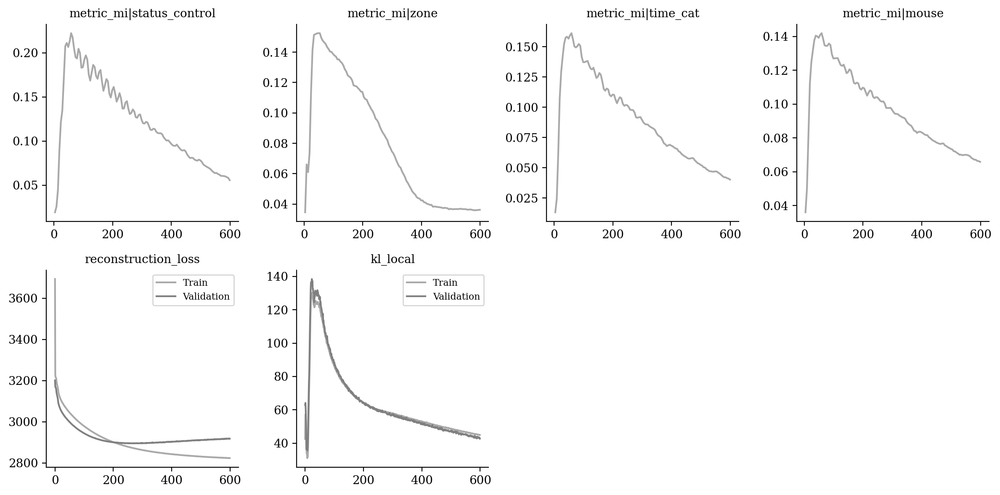

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

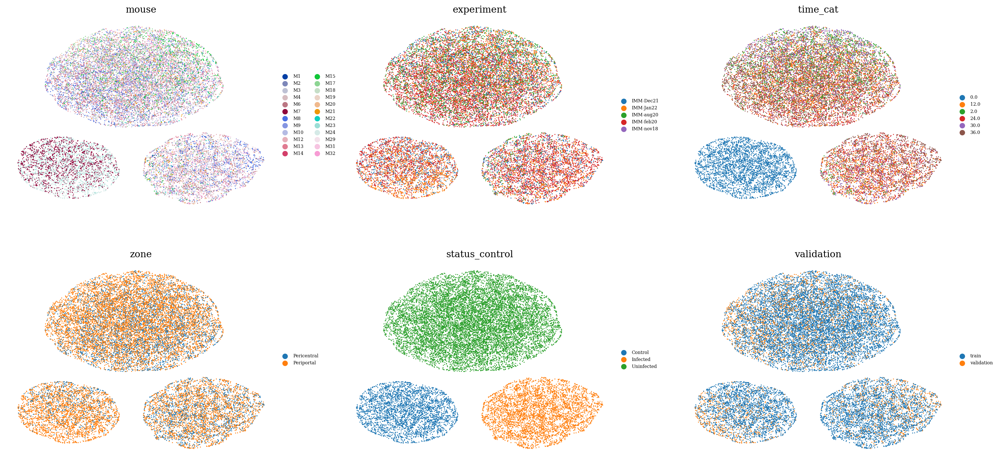

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

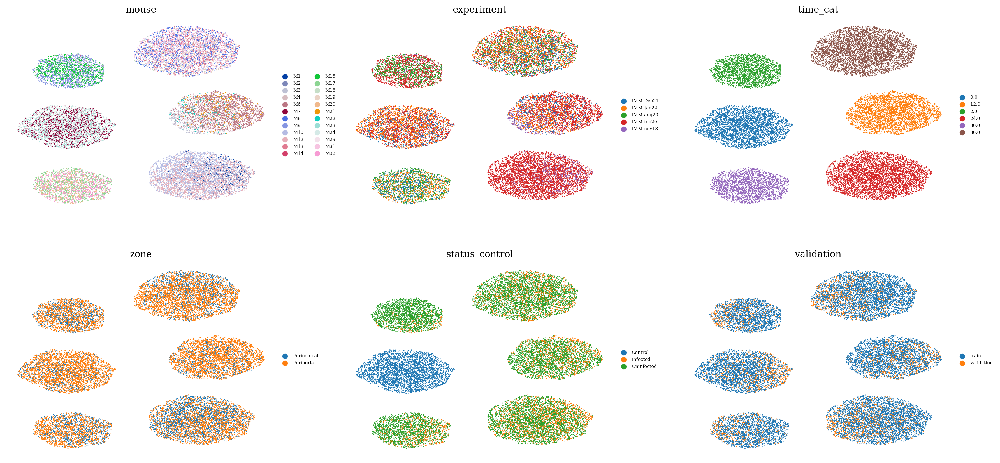

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

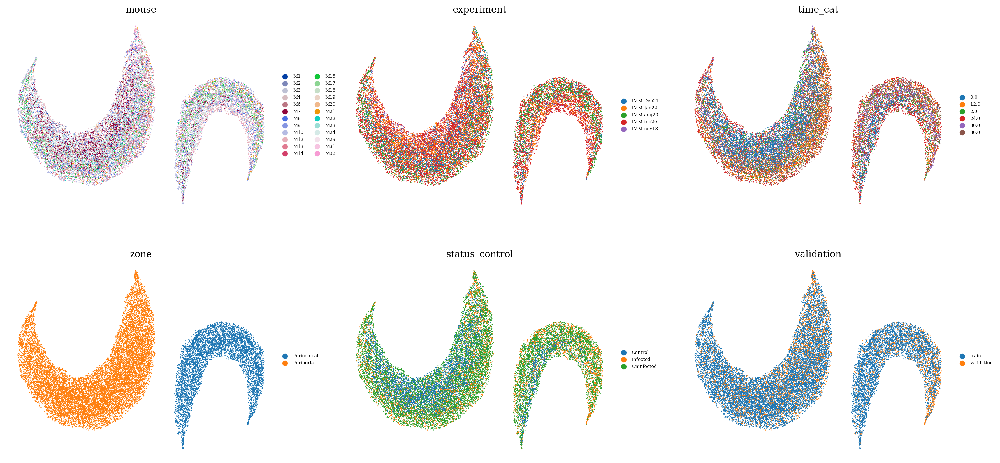

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

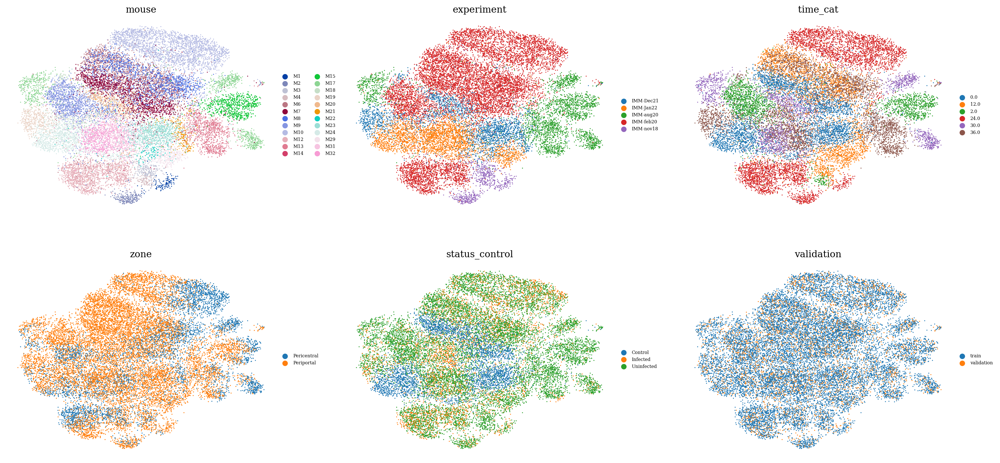

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

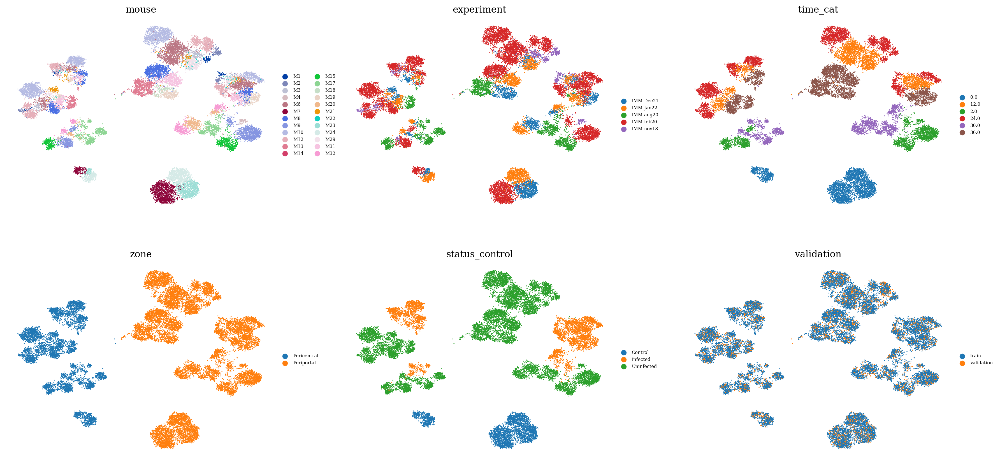

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

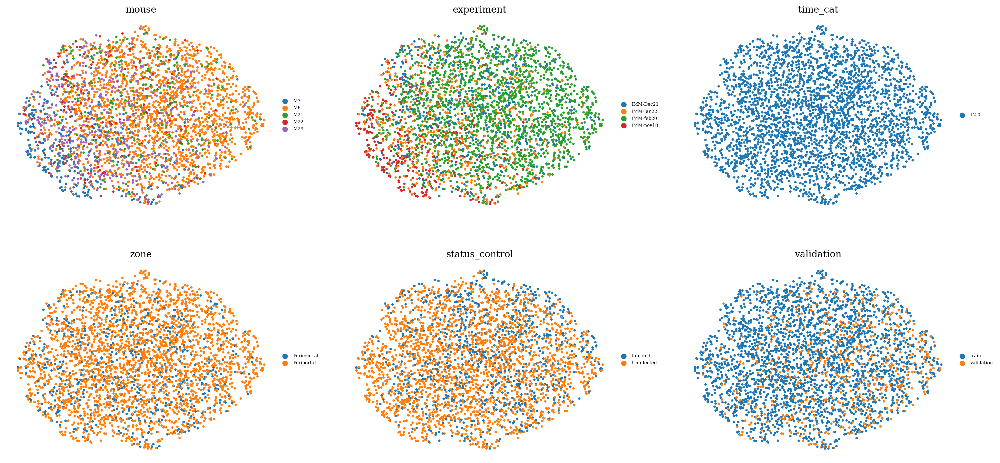

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )